In [1]:
exec(open('imports.py').read())
from tqdm import tqdm
import matplotlib.ticker as mtk
import cf_xarray
%config InlineBackend.figure_format = 'retina'
import colormaps as cmaps 
convert = lambda x: chr(ord('`')+(x+1)) if x<26 else chr(ord('`')+((x)//25))+chr(ord('`')+(x+1)%26)

ERROR 1: PROJ: proj_create_from_database: Open of /global/homes/k/kquagra/miniconda3/envs/climate_py311.5/share/proj failed


## SELECTING THE LAND-OCEAN BOUNDARY

In [4]:
38/2

19.0

In [2]:
lsm = xr.open_dataset('conus_lsm.nc') .sel(latitude=slice(50,25))

In [3]:
# select the data twice and shift the longitudes and subtract one from the other to obtain the 
ld1 = lsm['lsm'][0]
ld2 = lsm['lsm'][0]

In [4]:
ld2_lons = ld2.longitude + 0.5 
ld2['longitude'] = ld2_lons

In [5]:
ldif = ld1-ld2

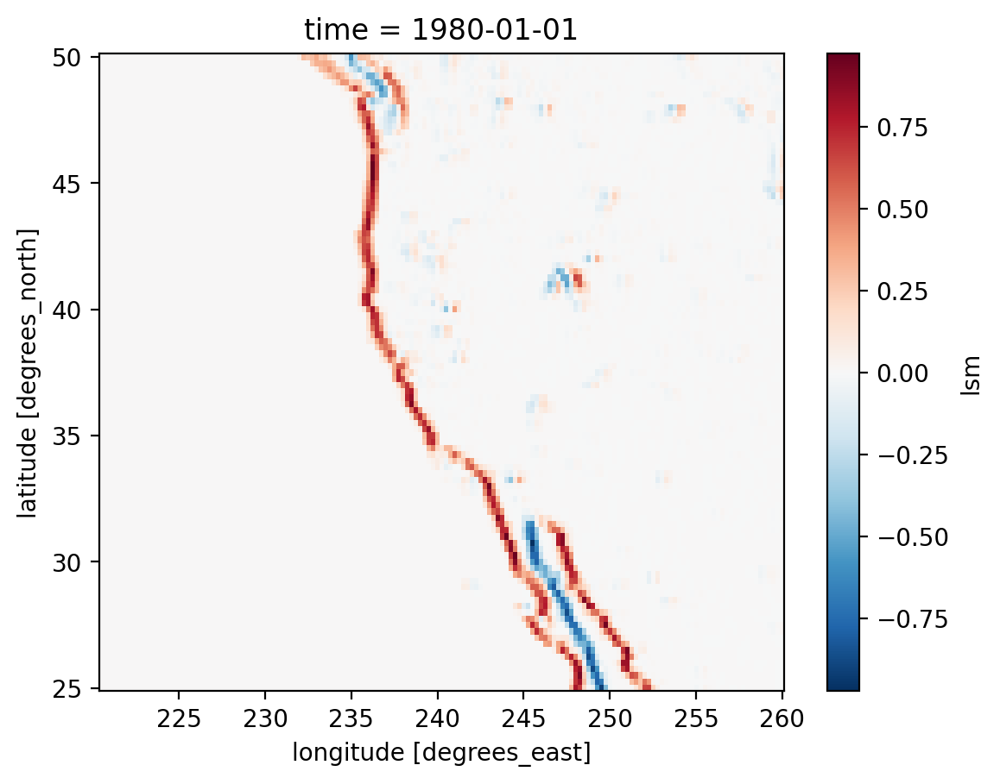

In [6]:
ldif.mean('expver').plot()

In [12]:
SoCal = ldif.sel(latitude=slice(32,27))
NoCal = ldif.sel(latitude=slice(42,37))

In [13]:
SoCal_lonvals = SoCal.where(SoCal.values > 0.5)
NoCal_lonvals = NoCal.where(NoCal.values > 0.5)

In [44]:
lonvals = ldif.where(ldif.values >0.5)

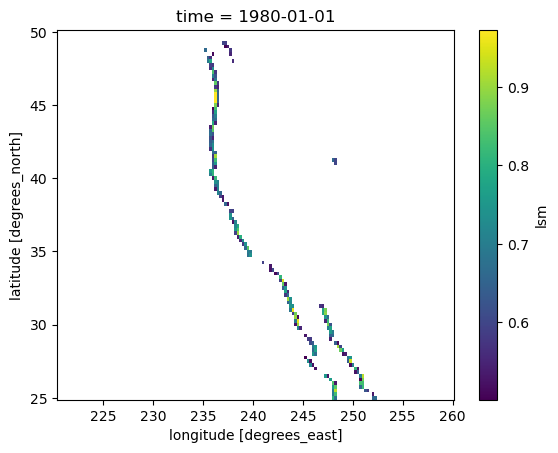

In [45]:
lonvals.mean('expver').plot()

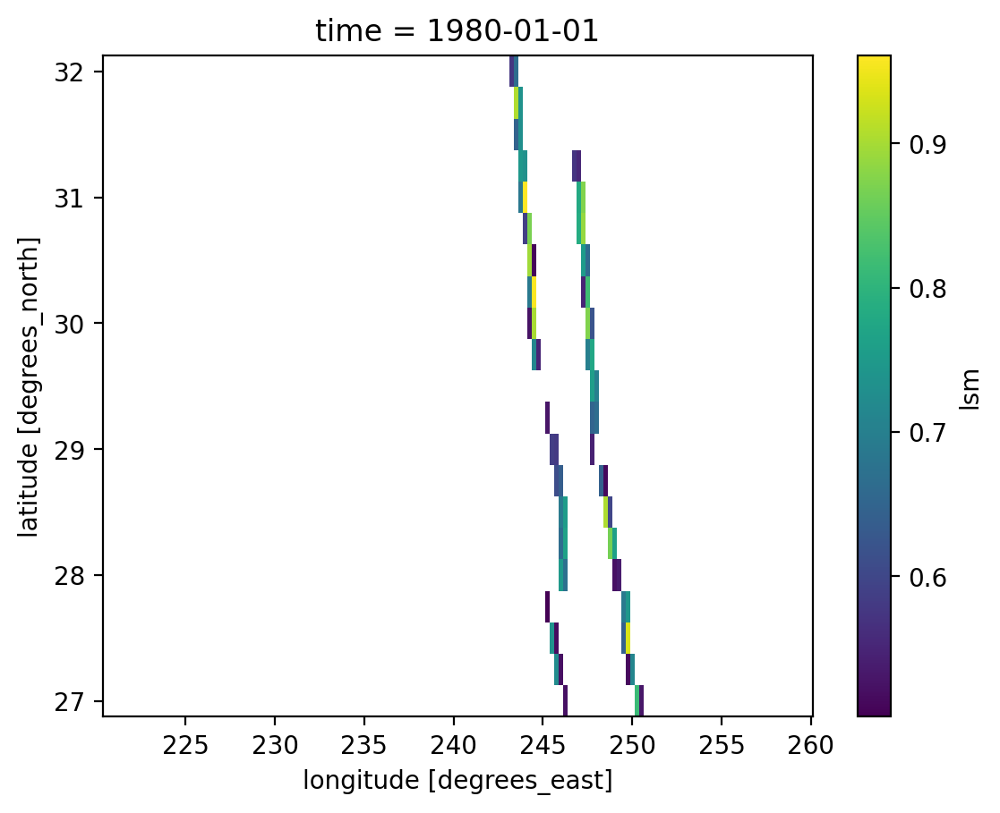

In [15]:
SoCal_lonvals.mean('expver').plot()

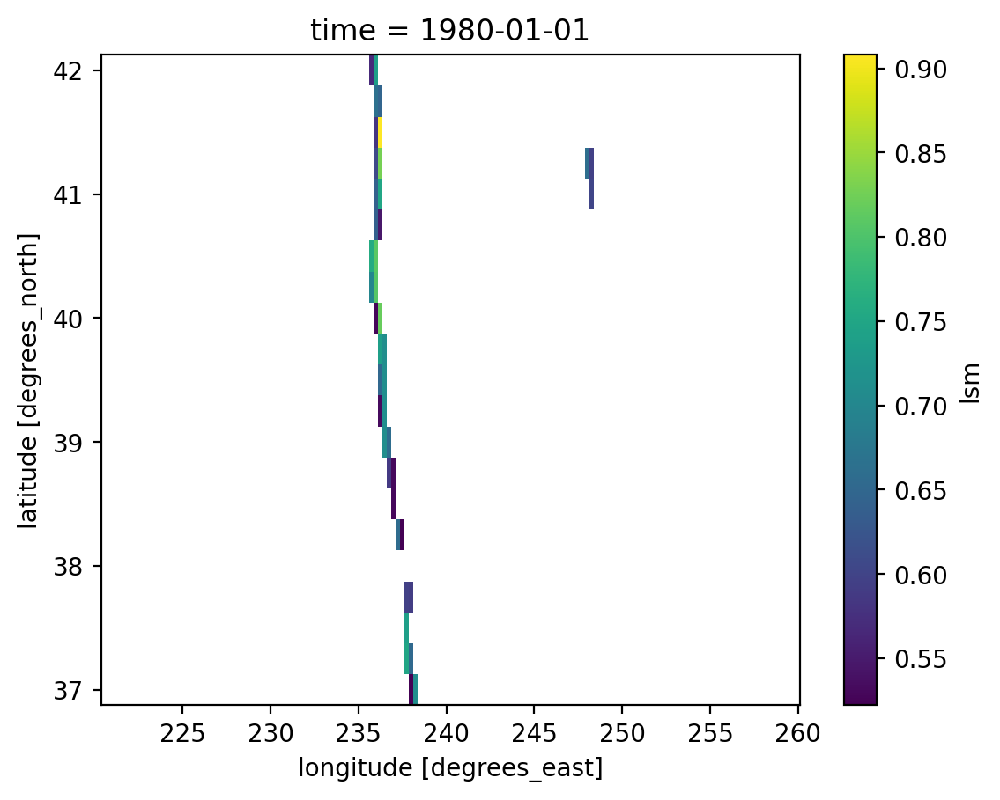

In [16]:
NoCal_lonvals.mean('expver').plot()

In [17]:


#use this to select the regional boundary 
SoCal_lonlats = []
for ix in SoCal_lonvals.longitude.values:
    for iy in SoCal_lonvals.latitude.values:
        v2ssel = SoCal_lonvals.mean('expver').sel(longitude=ix,latitude=iy)
        if v2ssel>0:

            SoCal_lonlats.append([ix , iy])
    

In [18]:


#use this to select the regional boundary 
NoCal_lonlats = []
for ix in NoCal_lonvals.longitude.values:
    for iy in NoCal_lonvals.latitude.values:
        v2ssel = NoCal_lonvals.mean('expver').sel(longitude=ix,latitude=iy)
        if v2ssel>0:

            NoCal_lonlats.append([ix , iy])
    

In [46]:


#use this to select the regional boundary 
lonlats = []
for ix in lonvals.longitude.values:
    for iy in lonvals.latitude.values:
        v2ssel = lonvals.mean('expver').sel(longitude=ix,latitude=iy)
        if v2ssel>0:

            lonlats.append([ix , iy])
    

In [19]:
with open(f'SoCalconus_boundary.txt', 'w') as f:
    for line in SoCal_lonlats:
        f.write(f'{line}\n')

In [20]:
with open(f'NoCalconus_boundary.txt', 'w') as f:
    for line in NoCal_lonlats:
        f.write(f'{line}\n')

In [80]:
with open(f'conus_boundary.txt', 'w') as f:
    for line in lonlats:
        f.write(f'{line}\n')

In [26]:
41/6

6.833333333333333

In [47]:
lonlats_pl = lonlats[::24]

In [86]:
with open(f'conus_boundary.txt', 'w') as f:
    for line in lonlats_pl:
        f.write(f'{line}\n')

In [89]:
lonlats_data

['[235.25, 48.75]\n',
 '[236.0, 44.25]\n',
 '[236.25, 45.75]\n',
 '[236.5, 45.0]\n',
 '[238.25, 37.0]\n',
 '[242.5, 33.5]\n',
 '[244.25, 30.0]\n',
 '[247.0, 31.25]\n',
 '[248.0, 25.5]\n',
 '[250.25, 27.0]\n']

In [87]:
fil = open(f'conus_boundary.txt','r')
lonlats_data = fil.readlines()


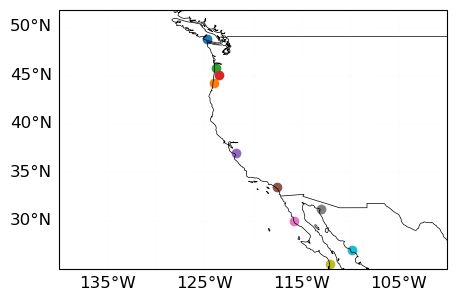

In [48]:
fig,ax= plt.subplots(figsize=(5,5),subplot_kw={'projection':ccrs.PlateCarree()})
for dpoint in lonlats_pl:
    iy = dpoint[1]
    ix = (dpoint[0] + 180) % 360 - 180
    plt.scatter(ix,iy)
    #plt.ylim(25,55)
    #plt.xlim(-140,-100)
cart_plot(ax,blat=25,tlat=50,llon=-140,rlon=-100)
plt.savefig('conus_landfall_locs.png')

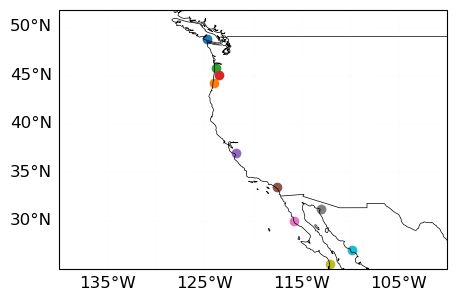

In [95]:
fig,ax= plt.subplots(figsize=(5,5),subplot_kw={'projection':ccrs.PlateCarree()})
for dpoint in lonlats_pl:
    iy = dpoint[1]
    ix = (dpoint[0] + 180) % 360 - 180
    plt.scatter(ix,iy)
    #plt.ylim(25,55)
    #plt.xlim(-140,-100)
cart_plot(ax,blat=25,tlat=50,llon=-140,rlon=-100)
plt.savefig('conus_landfall_locs.png')

# BEGIN ANALYSIS FOR NoCal Region

# ERA5 RAW VARIABLES PLOT

In [2]:
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']variables = ['pv','z','msl','tcwv','ivt']
len_of_data = []
mpath='./'
for alx, alg in enumerate(algorithms):
    locals()[f'{alg}_data'] = collections.defaultdict(list)
    print(alg)
    for vx,vb in enumerate(variables):
        pths = glob.glob(f'conus_ARS_DJF_comps_{alg}_{vb}_raw/*',recursive=True)
        pths.sort()
        ds = [xr.open_dataset(pt, chunks='auto') for pt in pths]
        
        dds = xr.concat(ds,dim='time').mean('time')
        eval(f'{alg}_data')[vb] = dds.load()  #xr.open_mfdataset(pths, chunks='auto')
        
        print(len(pths))
        
        if vx == 0 :
            len_of_data.append(len(dds.time.values))

cascade_bard_v1
38
38
38
38
38
guan_waliser
38
38
38
38
38
SCAFET
38
38
38
38
38
mundhenk_v3
38
38
38
38
38
reid250
38
38
38
38
38
connect500
38
38
38
38
38
gershunov
38
38
38
38
38


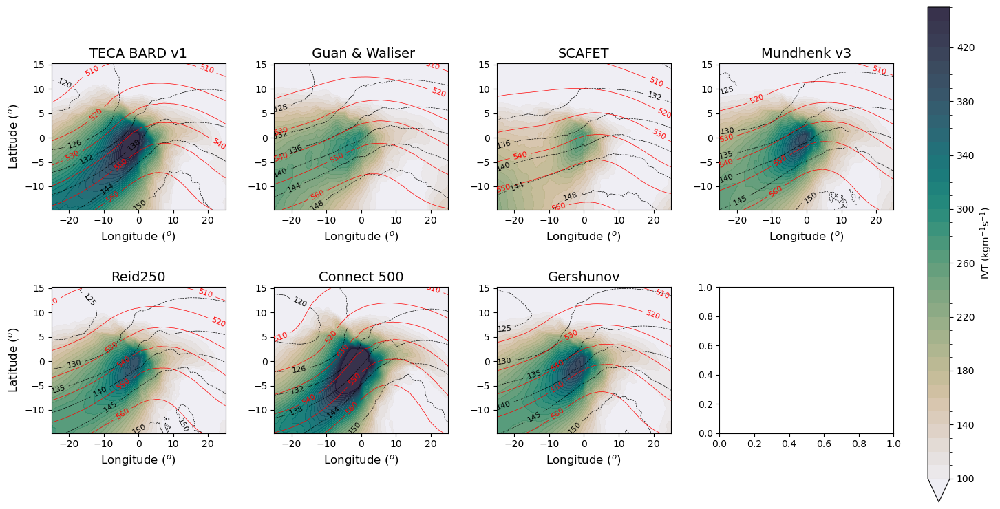

In [28]:
algorithms = ['cascade_bard_v1','guan_waliser','SCAFET','mundhenk_v3','reid250','connect500','gershunov']
variables = ['pv','z','msl','tcwv','ivt']
alg_names = ['TECA BARD v1', ' Guan & Waliser', 'SCAFET', 'Mundhenk v3', 'Reid250', 'Connect 500', 'Gershunov']

fig,axes = plt.subplots(ncols=4, nrows = 2, figsize=(16,9))
plt.tight_layout(pad=12,h_pad=6,w_pad=2)
for (ix,ax),alg in zip(enumerate(axes.flat),algorithms):
    
    if ix <7:
        plot_data = eval(f'{alg}_data')['ivt']['IVT']
        plot = plot_data.plot.contourf(ax=ax, 
                              cmap='cmo.rain',
                                       levels=np.arange(100,451,10),
                              add_colorbar=False, vmin=100,vmax=450,alpha=0.9)
        fmt = mtk.StrMethodFormatter("{x:1.0f}")
    
        ############## 850 hPa ###############
        z_plot = eval(f'{alg}_data')['z']['Z']/100
        z1 = z_plot.sel(level=850).plot.contour(ax=ax,
                                          cmap='black',linestyles='dashed', linewidths = 0.5)
        z1.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)
        
        
        ############## 500 hPa ###############
        z_plot = eval(f'{alg}_data')['z']['Z']/100
        z2 = z_plot.sel(level=500).plot.contour(ax=ax,vmin=450,vmax=580, levels=np.arange(450,580,10),
                                          cmap='red',linestyles='solid', linewidths = 0.5)
        z2.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)
        
        ############## 300 hPa ###############
        #z_plot = eval(f'{alg}_data')['z']['Z']/100
        #z3 = z_plot.sel(level=300).plot.contour(ax=ax,
        #                                  cmap='grey',linestyles='dashed')
        #z3.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)
        
    else:
        ax.remove()
        
    if ix%4 ==0:
        ax.set_ylabel('Latitude ($^o$)', fontsize=12)
        
    else:
        ax.set_ylabel('')
    ax.set_xlabel('Longitude ($^o$)', fontsize=12)
    
    ax.set_title(f'{alg_names[ix]}',fontsize=14)
cbar_ax = fig.add_axes([0.92, 0.1, 0.02, 0.8])  # [left, bottom, width, height]
cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5, label='IVT (kgm$^{-1}$s$^{-1}$)')

plt.savefig('Images/IVT_z850_500.png', dpi=300)

In [7]:
len_of_data

[]

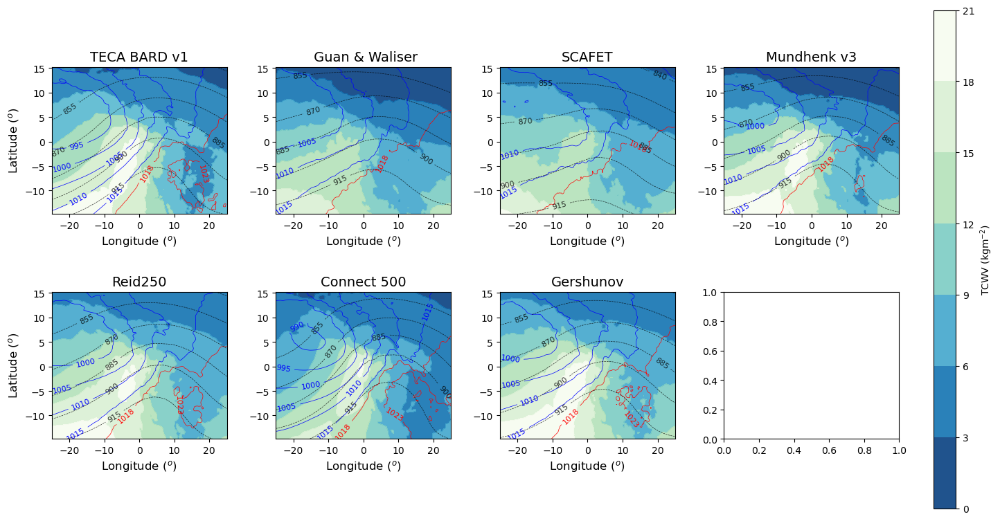

In [29]:
algorithms = ['cascade_bard_v1','guan_waliser','SCAFET','mundhenk_v3','reid250','connect500','gershunov']
variables = ['pv','z','msl','tcwv','ivt']
alg_names = ['TECA BARD v1', ' Guan & Waliser', 'SCAFET', 'Mundhenk v3', 'Reid250', 'Connect 500', 'Gershunov']

fig,axes = plt.subplots(ncols=4, nrows = 2, figsize=(16,9))
plt.tight_layout(pad=12,h_pad=6,w_pad=2)
for (ix,ax),alg in zip(enumerate(axes.flat),algorithms):
    
    if ix <7:
        plot_data = eval(f'{alg}_data')['tcwv']['TCWV']
        plot = plot_data.plot.contourf(ax=ax, 
                              cmap='GnBu_r',
                                       
                              add_colorbar=False, alpha=0.9)
        fmt = mtk.StrMethodFormatter("{x:1.0f}")
    
        ############## 850 hPa ###############
        #z_plot = eval(f'{alg}_data')['z']['Z']/100
        #z1 = z_plot.sel(level=850).plot.contour(ax=ax,
        #                                  cmap='black',linestyles='dashed')
        #z1.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)
        
        
        ############## MSL hPa ###############
        msl_plot = eval(f'{alg}_data')['msl']['MSL']/100
        z2 = msl_plot.where(msl_plot.values>=1016).plot.contour(ax=ax,
                                     vmin=1018, vmax=1030,
                                     levels=np.arange(1018,1030,5),
                                     cmap='red',linestyles='solid', linewidths = 0.5)
        z2.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)
        
        msl_plot = eval(f'{alg}_data')['msl']['MSL']/100
        z2 = msl_plot.where(msl_plot.values<1016).plot.contour(ax=ax,
                                     vmin=990, vmax=1016,
                                     levels=np.arange(990,1016,5),
                                     cmap='blue',linestyles='solid', linewidths = 0.5)
        z2.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)
        
        ############## 300 hPa ###############
        z_plot = eval(f'{alg}_data')['z']['Z']/100
        z3 = z_plot.sel(level=300).plot.contour(ax=ax,
                                          cmap='black',linestyles='dashed', alpha=0.8, linewidths = 0.5)
        z3.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)
        
    else:
        ax.remove()
        
    if ix%4 ==0:
        ax.set_ylabel('Latitude ($^o$)', fontsize=12)
        
    else:
        ax.set_ylabel('')
    ax.set_xlabel('Longitude ($^o$)', fontsize=12)
    
    ax.set_title(f'{alg_names[ix]}',fontsize=14)
cbar_ax = fig.add_axes([0.92, 0.1, 0.02, 0.8])  # [left, bottom, width, height]
cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5, label='TCWV (kgm$^{-2}$)')

plt.savefig('Images/TCWV_MSL_z300.png', dpi=300)

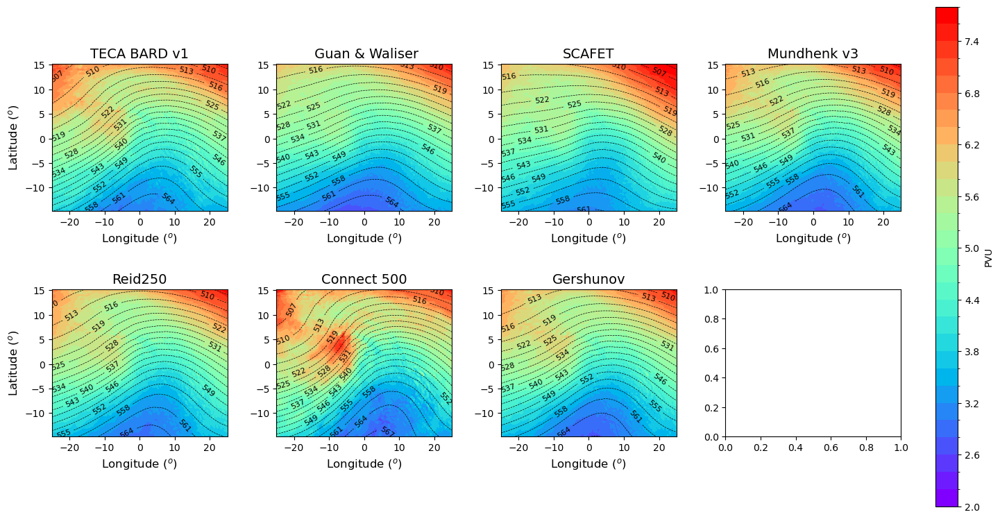

In [57]:
algorithms = ['cascade_bard_v1','guan_waliser','SCAFET','mundhenk_v3','reid250','connect500','gershunov']
variables = ['pv','z','msl','tcwv','ivt']
alg_names = ['TECA BARD v1', ' Guan & Waliser', 'SCAFET', 'Mundhenk v3', 'Reid250', 'Connect 500', 'Gershunov']

fig,axes = plt.subplots(ncols=4, nrows = 2, figsize=(16,9))
plt.tight_layout(pad=12,h_pad=6,w_pad=2)
for (ix,ax),alg in zip(enumerate(axes.flat),algorithms):
    
    if ix <7:
        plot_data = eval(f'{alg}_data')['pv']['PV']/1e-7
        plot = plot_data.sel(level=500).plot.contourf(ax=ax, 
                                                      levels=np.arange(2,8,0.2),
                              cmap='rainbow',
                                       
                              add_colorbar=False, alpha=1)
        fmt = mtk.StrMethodFormatter("{x:1.0f}")
    
        ############## 850 hPa ###############
        
        #plot_data = eval(f'{alg}_data')['tcwv']['TCWV'] #(kgm$^{-2}$)
        #z1=plot_data.plot.contour(ax=ax, 
         #                     cmap='red',
          #                    add_colorbar=False,linestyles='solid', linewidths = 0.5)
        #z1.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)
        
        z_plot = eval(f'{alg}_data')['z']['Z']/100
        z1 = z_plot.sel(level=500).plot.contour(ax=ax,
                                                vmin=480,vmax=580, levels=np.arange(480,580,3),
                                          cmap='black',linestyles='dashed',linewidths=0.5)
        z1.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)
        
        
       
    else:
        ax.remove()
        
    if ix%4 ==0:
        ax.set_ylabel('Latitude ($^o$)', fontsize=12)
        
    else:
        ax.set_ylabel('')
    ax.set_xlabel('Longitude ($^o$)', fontsize=12)
    
    ax.set_title(f'{alg_names[ix]}',fontsize=14)
cbar_ax = fig.add_axes([0.92, 0.1, 0.02, 0.8])  # [left, bottom, width, height]
cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5, label='PVU')

plt.savefig('Images/PV_z500.png', dpi=300)

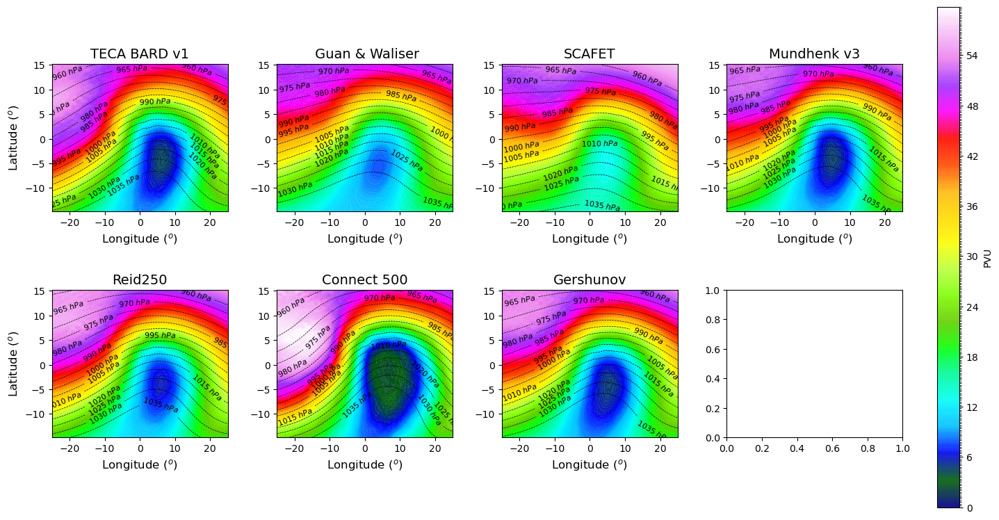

In [58]:
algorithms = ['cascade_bard_v1','guan_waliser','SCAFET','mundhenk_v3','reid250','connect500','gershunov']
variables = ['pv','z','msl','tcwv','ivt']
alg_names = ['TECA BARD v1', ' Guan & Waliser', 'SCAFET', 'Mundhenk v3', 'Reid250', 'Connect 500', 'Gershunov']

fig,axes = plt.subplots(ncols=4, nrows = 2, figsize=(16,9))
plt.tight_layout(pad=12,h_pad=6,w_pad=2)
for (ix,ax),alg in zip(enumerate(axes.flat),algorithms):
    
    if ix <7:
        plot_data = eval(f'{alg}_data')['pv']['PV']/1e-7
        plot = plot_data.sel(level=250).plot.contourf(ax=ax, 
                                                      levels=np.arange(0,60,0.2),
                              cmap='gist_ncar',
                                       
                              add_colorbar=False, alpha=0.9)
        fmt = mtk.StrMethodFormatter("{x:1.0f} $hPa$")
    
        ############## 850 hPa ###############
        #z_plot = eval(f'{alg}_data')['z']['Z']/100
        #z1 = z_plot.sel(level=850).plot.contour(ax=ax,
        #                                  cmap='black',linestyles='dashed')
        #z1.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)
        
        
        z_plot = eval(f'{alg}_data')['z']['Z']/100
        z1 = z_plot.sel(level=250).plot.contour(ax=ax,
                                                vmin=960,vmax=1040, levels=np.arange(960,1040,5),
                                          cmap='black',linestyles='dashed',linewidths=0.5)
        z1.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)
        
    else:
        ax.remove()
        
    if ix%4 ==0:
        ax.set_ylabel('Latitude ($^o$)', fontsize=12)
        
    else:
        ax.set_ylabel('')
    ax.set_xlabel('Longitude ($^o$)', fontsize=12)
    
    ax.set_title(f'{alg_names[ix]}',fontsize=14)
cbar_ax = fig.add_axes([0.92, 0.1, 0.02, 0.8])  # [left, bottom, width, height]
cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5,label='PVU')

plt.savefig('Images/PV_z300.png', dpi=300)

# MERRA2 VARIABLES PLOT

## Check Landfalling Points 

[[55.0, 226.0],
 [46.5, 236.0],
 [49.25, 239.25],
 [40.5, 242.0],
 [32.75, 244.75],
 [52.75, 247.75],
 [46.75, 250.25],
 [31.25, 252.5],
 [49.5, 255.25],
 [54.5, 258.0]]

In [134]:
lonlats_pl = ((55.0, 226.0),
(46.5, 236.0),
(49.25, 239.25),
(40.5, 242.0),
(32.75, 244.75),
(52.75, 247.75),
(46.75, 250.25),
(31.25, 252.5),
(49.5, 255.25),
(54.5, 258.0))
lonlats_pl = np.array([list(x) for x in lonlats_pl])

In [3]:
lonlats_pl=((48.75, 235.25),
(44.25, 236.0),
(45.75, 236.25),
(45.0, 236.5),
(37.0, 238.25),
(33.5, 242.5),
(30.0, 244.25),
(31.25, 247.0),
(25.5, 248.0),
(27.0, 250.25))
lonlats_pl = np.array([list(x) for x in lonlats_pl])

In [19]:
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.io import srtm
# Function to plot the map with specified parameters
def cart_plot(ax, blat, tlat, llon, rlon):
    ax.set_extent([llon, rlon, blat, tlat], crs=ccrs.PlateCarree())
    ax.coastlines(resolution='10m')
    ax.add_feature(cfeature.BORDERS, linestyle=':')
    ax.add_feature(cfeature.LAND, color='lightgray')
    ax.add_feature(cfeature.OCEAN, color='lightblue')
    ax.add_feature(cfeature.LAKES, edgecolor='black', facecolor='lightblue')
    ax.gridlines(draw_labels=True)

    # Load topography data using ETOPO1
    #ax.add_feature(cfeature.NaturalEarthFeature('physical', 'land', '10m', edgecolor='face'))
    #topo = srtm.load_topography()
    #ax.imshow(topo, origin='upper', extent=[llon, rlon, blat, tlat], cmap='terrain', transform=ccrs.PlateCarree())

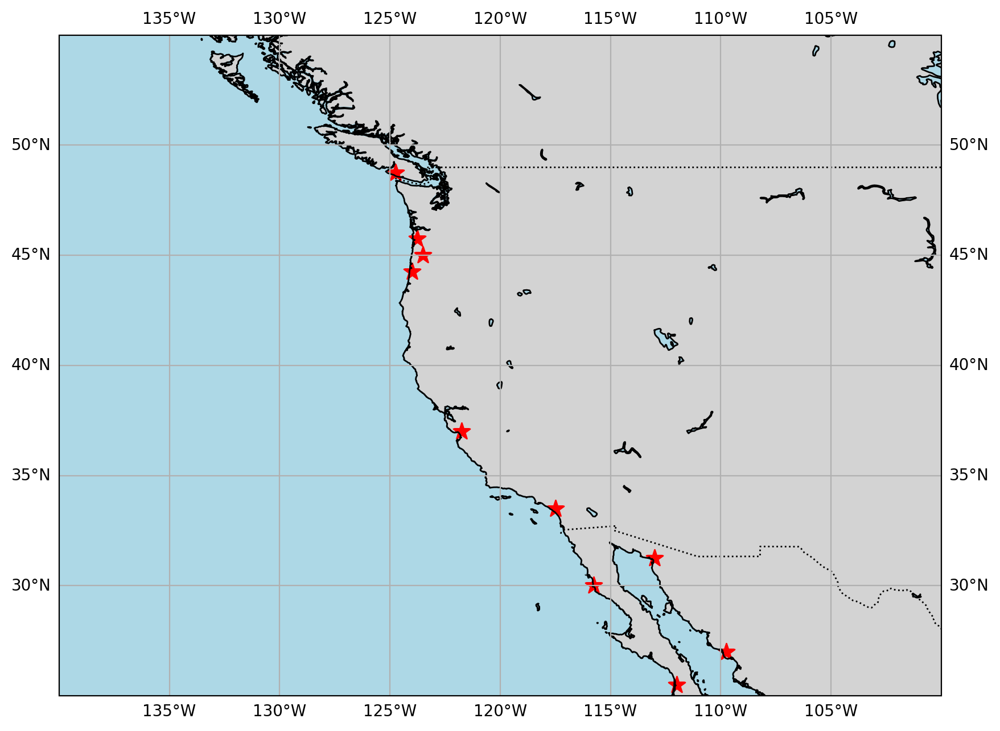

In [20]:
fig, ax = plt.subplots(figsize=(10, 8), subplot_kw={'projection': ccrs.PlateCarree()})

# Plot lon-lats_pl points


# Plot the map with topography
cart_plot(ax, blat=25, tlat=55, llon=-140, rlon=-100)
ax.scatter((lonlats_pl[:,1]+ 180) % 360 - 180,lonlats_pl[:,0],color='red',marker='*', s=120)

plt.savefig('conus_landfall_locs_topo.png')
plt.show()

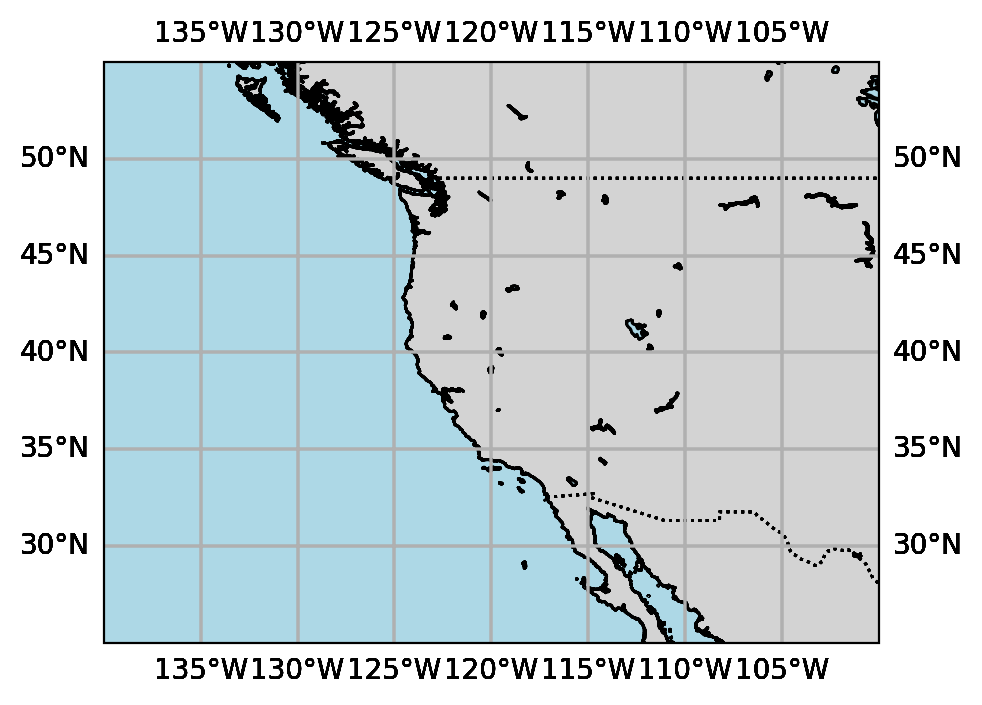

In [111]:
fig,ax= plt.subplots(figsize=(5,5),subplot_kw={'projection':ccrs.PlateCarree()})
for dpoint in lonlats_pl:
    iy = dpoint[1]
    ix = (dpoint[0] + 180) % 360 - 180
    plt.scatter(ix,iy)
    #plt.ylim(25,55)
    #plt.xlim(-140,-100)
cart_plot(ax, blat=25, tlat=55, llon=-140, rlon=-100)
#plt.savefig('conus_landfall_locs.png')

## Preprocess data and save

In [2]:
import dask 
import dask.delayed

In [16]:
import dask 
import dask.delayed
# Define a function to normalize each variable in the dataset
@dask.delayed
def normalize_variable(var, var_type):
    ''' 
    This function normalises an xarray dataset for values between -1 and 1. 
    
    Arguments
    --------------
    
    var : xarray dataset or data array
    
    Return
    ----------
    
    xarray normalised dataset
    
    '''
    if var_type == 'levels':
        
        min_val = var.min(dim=['longitude','latitude'])    #obtain min value
        #print(min_val.values)
        max_val = var.max(dim=['longitude','latitude'])   # obtain max value
    elif var_type == 'surface':
        min_val = var.min()    #obtain min value  dim=['longitude','laitude']
        #print(min_val.values)
        max_val = var.max()   # obtain max value
        
    normalized_var = 2 * (var - min_val) / (max_val - min_val) - 1    #compute normalisation
    
    return normalized_var

In [17]:
%%time
algorithms = ['cascade_bard_v1','SCAFET','mundhenk_v3','lora_v2','reid250','connect500','gershunov','guan_waliser']
#algorithms=['connect500','gershunov']#,'guan_waliser']
#variables =['h']#,'h']#,'tqv','slp','ivt']
variables = ['tqv']
len_of_data = []
mpath='./MERRA2_NoCal/'
for alx, alg in enumerate(algorithms):
    locals()[f'{alg}_merra'] = collections.defaultdict(list)
    print(f'{Color.PURPLE}{alg.upper()}{Color.END}')
    for vx,vb in enumerate(variables):
        pths = glob.glob(f'{mpath}conus_ARS_DJF_comps_{alg}_{vb}_raw/*.nc',recursive=True)
        pths.sort()
        #ds = [open_dataset(pt).compute() for pt in tqdm(pths,desc='Processing')]
        
        #ds = xr.concat(ds,dim='time')
        %time ds = xr.open_mfdataset(pths, chunks='auto')
        print(f'Done loading {vb} data \nCalculating mean')
        %time dds = ds.mean('time').load() 
        eval(f'{alg}_merra')[vb] = dds #xr.open_mfdataset(pths, chunks='auto')
        
        if vx <3:
            typ = 'levels'
        elif vx>=3:
            typ = 'surface'
            print('Calculating normalisations')
        eval(f'{alg}_merra')[vb][f'norm_{vb.upper()}'] = normalize_variable(dds,var_type=typ).compute()[vb.upper()]
        print(len(pths))
        sv_path = f'{mpath}Averages/'
        final_path = f'{sv_path}{alg}/'

        if os.path.isdir(sv_path) == False:
            os.mkdir(sv_path)

        if os.path.isdir(final_path) == False:
            os.mkdir(final_path)

        
        eval(f'{alg}_merra')[vb].to_netcdf(f'{final_path}{alg}_{vb}.nc')
        
    if vx == 0 :
        len_of_data.append(len(ds.time.values))


CASCADE_BARD_V1
CPU times: user 499 ms, sys: 50.5 ms, total: 550 ms
Wall time: 571 ms
Done loading tqv data 
Calculating mean
CPU times: user 297 ms, sys: 62.8 ms, total: 359 ms
Wall time: 120 ms
36
SCAFET
CPU times: user 328 ms, sys: 289 ms, total: 617 ms
Wall time: 788 ms
Done loading tqv data 
Calculating mean
CPU times: user 937 ms, sys: 583 ms, total: 1.52 s
Wall time: 773 ms
38
MUNDHENK_V3
CPU times: user 341 ms, sys: 242 ms, total: 583 ms
Wall time: 741 ms
Done loading tqv data 
Calculating mean
CPU times: user 444 ms, sys: 253 ms, total: 697 ms
Wall time: 355 ms
37
LORA_V2
CPU times: user 333 ms, sys: 264 ms, total: 597 ms
Wall time: 757 ms
Done loading tqv data 
Calculating mean
CPU times: user 459 ms, sys: 203 ms, total: 661 ms
Wall time: 326 ms
37
REID250
CPU times: user 370 ms, sys: 240 ms, total: 610 ms
Wall time: 791 ms
Done loading tqv data 
Calculating mean
CPU times: user 462 ms, sys: 263 ms, total: 726 ms
Wall time: 370 ms
37
CONNECT500
CPU times: user 371 ms, sys: 18

In [14]:
#SAVE THE AVERAGE DATASETS FOR EASY FUTURE USE
algorithms = ['cascade_bard_v1','SCAFET','mundhenk_v3','lora_v2','reid250','connect500','gershunov','guan_waliser']
variables =['tqv']# ['epv','h','omega','slp','ivt']
for alx, alg in enumerate(algorithms):
    locals()[f'{alg}_merra'] = collections.defaultdict(list)
    print(f'{Color.PURPLE}{alg.upper()}{Color.END}')
    sv_path = f'MERRA2_NoCal/Averages/'
    final_path = f'{sv_path}{alg}/'
    
    if os.path.isdir(sv_path) == False:
        os.mkdir(sv_path)
    
    if os.path.isdir(final_path) == False:
        os.mkdir(final_path)
        
    for vx,vb in enumerate(variables):
                
        eval(f'{alg}_merra')[vb].to_netcdf(f'{final_path}{alg}_{vb}.nc')

CASCADE_BARD_V1


AttributeError: 'list' object has no attribute 'to_netcdf'

In [11]:
eval(f'{alg}_merra')['epv']

<xarray.Dataset>
Dimensions:   (lev: 42, lat: 61, lon: 81)
Coordinates:
  * lev       (lev) float64 1e+03 975.0 950.0 925.0 900.0 ... 0.5 0.4 0.3 0.1
  * lat       (lat) float64 -15.0 -14.5 -14.0 -13.5 ... 13.5 14.0 14.5 15.0
  * lon       (lon) float64 -25.0 -24.38 -23.75 -23.12 ... 23.75 24.38 25.0
Data variables:
    EPV       (lev, lat, lon) float32 4.513e-08 4.496e-08 ... 0.121 0.1177
    norm_EPV  (lev, lat, lon) float32 -0.4144 -0.4144 -0.4139 ... 0.8892 0.8145

## LOAD DATA AND START PLOTTING 

In [30]:
%%time
algorithms = ['cascade_bard_v1','SCAFET','mundhenk_v3','lora_v2','reid250','connect500','gershunov','guan_waliser']
#algorithms=['SCAFET','mundhenk_v3','lora_v2','reid250','connect500','gershunov','guan_waliser']
variables =['epv','h','slp','ivt']#['ivt','h','slp','tqv','epv'] #'omega'
#variables = ['ivt']
len_of_data = []
mpath='./MERRA2_NoCal/'
for alx, alg in enumerate(algorithms):
    #locals()[f'{alg}_merra'] = collections.defaultdict(list)
    print(f'{Color.PURPLE}{alg.upper()}{Color.END}')
    for vx,vb in enumerate(variables):
        pths = glob.glob(f'{mpath}conus_ARS_DJF_comps_{alg}_{vb}_raw/*.nc',recursive=True)
        pths.sort()
        #ds = [open_dataset(pt).compute() for pt in tqdm(pths,desc='Processing')]
        
        #ds = xr.concat(ds,dim='time')
        ds = xr.open_mfdataset(pths, chunks='auto')
        
        if vx == 0 :
            len_of_data.append(len(ds.time.values))
        

CASCADE_BARD_V1
SCAFET
MUNDHENK_V3
LORA_V2
REID250
CONNECT500
GERSHUNOV
GUAN_WALISER
CPU times: user 13.8 s, sys: 6.49 s, total: 20.3 s
Wall time: 27.3 s


In [31]:
len_of_data

[6315, 25400, 14779, 13252, 14760, 2238, 16859, 62829]

In [19]:
%%time
algorithms = ['cascade_bard_v1','SCAFET','mundhenk_v3','lora_v2','reid250','connect500','gershunov','guan_waliser']
#algorithms=['SCAFET','mundhenk_v3','lora_v2','reid250','connect500','gershunov','guan_waliser']
variables =['epv','h','slp','tqv','ivt']

for alx,alg in enumerate(algorithms):
    locals()[f'{alg}_merra'] = collections.defaultdict(list)
    
    for vx,vb in enumerate(variables):
        pths = glob.glob(f'MERRA2_NoCal/Averages/{alg}/*{vb}*', recursive=True)

        if vb == 'tqv':
                ds = xr.open_mfdataset(pths).sel(longitude=slice(-24,24),latitude=slice(-14,14))
        else:
                ds = xr.open_mfdataset(pths).sel(lon=slice(-24,24),lat=slice(-14,14))
                
        eval(f'{alg}_merra')[f'{vb}'] = ds

CPU times: user 318 ms, sys: 155 ms, total: 472 ms
Wall time: 624 ms


In [32]:
from matplotlib.colors import CenteredNorm

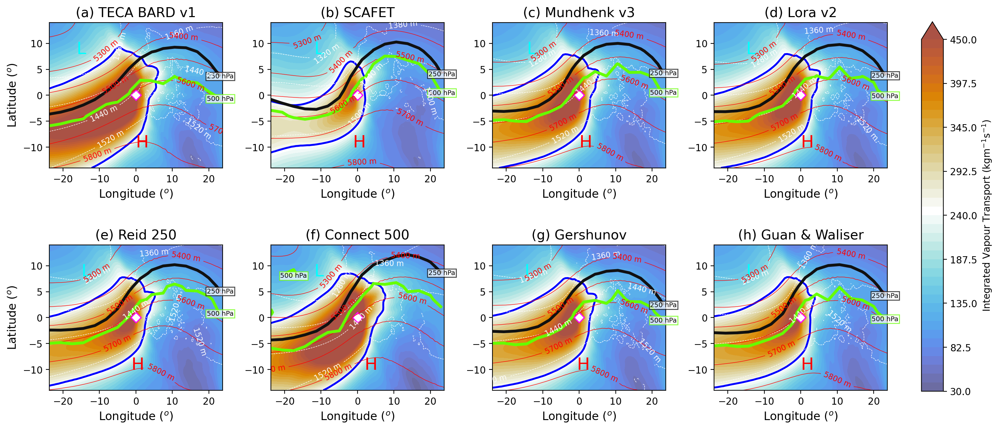

In [33]:
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']

fig,axes = plt.subplots(ncols=4, nrows = 2, figsize=(16,9))
plt.tight_layout(pad=12,h_pad=6,w_pad=2)
for (ix,ax),alg in zip(enumerate(axes.flat),algorithms):
    
    
    plot_data = eval(f'{alg}_merra')['ivt']['IVT']

    levels = np.linspace(30,450, 41)  # Adjust the number of levels as needed
    norm = plt.Normalize(levels.min(), levels.max())

    plot = plot_data.plot.contourf(ax=ax, 
                          cmap=cmaps.prinsenvlag_r, add_colorbar=False, norm=norm, levels=levels)
                                   #levels=np.arange(100,451,10),
                          #vmin=100,vmax=450,alpha=0.9)

    #plot_data.plot.contour(ax=ax, levels=250, cmap='yellow')
    ax.contour(plot_data['lon'], plot_data['lat'], plot_data, levels=[250], colors='blue', linewidths=2)


    fmt = mtk.StrMethodFormatter("{x:1.0f} m")

    ############## 850 hPa ###############
    z_plot = eval(f'{alg}_merra')['h']['H']#/1000
    z1 = z_plot.sel(lev=850).plot.contour(ax=ax,
                                      cmap='white',linestyles='dashed', linewidths = 0.5)
    z1.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)


    ############## 500 hPa ###############
    z_plot = eval(f'{alg}_merra')['h']['H']#/1000
    z2 = z_plot.sel(lev=500).plot.contour(ax=ax,vmin=5000,vmax=6000, levels=np.arange(5000,6000,100),
                                      cmap='red',linestyles='solid', linewidths = 0.5)
    z2.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)

    ############## 300 hPa ###############
    #z_plot = eval(f'{alg}_data')['z']['Z']/100
    #z3 = z_plot.sel(level=300).plot.contour(ax=ax,
    #                                  cmap='grey',linestyles='dashed')
    #z3.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)

    ######################################### SHOW THE SURFACE PRESSURE LOWS AND HIGHS ################################
    msl_data = eval(f'{alg}_merra')[f'slp']['SLP'].sel(lon=slice(-20,20), lat=slice(-10,10))
    mln, mlt = msl_data.argmin(dim=['lon','lat'])['lon'].values, msl_data.argmin(dim=['lon','lat'])['lat'].values    #obtain the lows positions 
    xln, xlt = msl_data.argmax(dim=['lon','lat'])['lon'].values,msl_data.argmax(dim=['lon','lat'])['lat'].values      #obtain the highs positions

    _text_data = msl_data.isel(lon=mln,lat=mlt)       #select the data for lows 
    _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the lows 
    if _x >= msl_data.lat.max().values - 0.5:
        _x = _x -2
    if _y >= msl_data.lat.max().values - 0.5:
        _y = _y - 2
    ax.text(_x,_y , 'L', fontdict={'size':18,'color':'cyan'})

    _text_data = msl_data.isel(lon=xln,lat=xlt)       #select the data for highs 
    _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the highs 
    if _x >= msl_data.lon.max().values-0.5:
        _x = _x - 4
    if _y >= msl_data.lat.max().values-0.5:
        _y = _y - 1

    ax.text(_x,_y , 'H', fontdict={'size':18, 'color':'red'})
        
    if ix%4 ==0:
        ax.set_ylabel('Latitude ($^o$)', fontsize=12)
        
    else:
        ax.set_ylabel('')
    ax.set_xlabel('Longitude ($^o$)', fontsize=12)
    
    ##############################################################################################################################
    #######################################  make contour plots for wave propagation at different levels  ########################################
    ##############################################################################################################################
    #EPV @ 500 hPa
    #eval(f'{alg}_merra')['h']['norm_H'].sel(lev=500).plot(ax=ax)
    c1 = ax.contour(eval(f'{alg}_merra')['epv']['lon'].values[::5], eval(f'{alg}_merra')['epv']['lat'].values[::5], eval(f'{alg}_merra')['epv']['norm_EPV'].sel(lev=500).values[::5,::5], levels=[0], colors='#66FF00', linewidths=3)
    x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
    ax.text(x,y, '500 hPa',
            fontsize=7,
            ha='center',
            va='center',
           bbox=dict(facecolor='white', edgecolor='#66FF00', alpha=0.7,pad=1))
    
    #EPV @ 250 hPa
    c1 = ax.contour(eval(f'{alg}_merra')['epv']['lon'].values[::5], eval(f'{alg}_merra')['epv']['lat'].values[::5], eval(f'{alg}_merra')['epv']['norm_EPV'].sel(lev=250).values[::5,::5], levels=[0], colors='#111111', linewidths=3)
    x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
    ax.text(x,y, '250 hPa',
            fontsize=7,
            ha='center',
            va='center',
           bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))
    
    
    #ax.set_xlim(-22,22)
    #ax.set_ylim(-14,14)
    ax.scatter(0,0,color='#FF00FF', marker='D', s=60)
    ax.scatter(0,0,color='white', marker='D', s=30)
    ax.set_title(f'({convert(ix)}) {alg_names[ix]}',fontsize=14)
cbar_ax = fig.add_axes([0.92, 0.21, 0.02, 0.6])  # [left, bottom, width, height]
cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5, label='Integrated Vapour Transport (kgm$^{-1}$s$^{-1}$)')

plt.savefig('MERRA2_NoCal/Images/merra_IVT_z850_500.png', dpi=300)

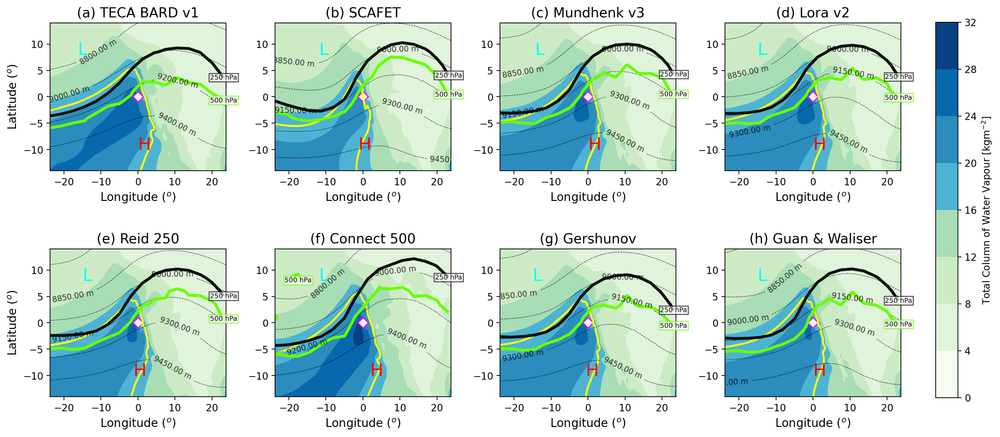

In [34]:
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']
variables = ['pv','z','msl','tcwv','ivt']

fig,axes = plt.subplots(ncols=4, nrows = 2, figsize=(16,9))
plt.tight_layout(pad=12,h_pad=6,w_pad=2)
for (ix,ax),alg in zip(enumerate(axes.flat),algorithms):
    
    
    plot_data = eval(f'{alg}_merra')['tqv']['TQV']
    plot = plot_data.plot.contourf(ax=ax, 
                          cmap=cmaps.gnbu,
                                   vmin=0,vmax=35, levels=np.arange(0,35,4),
                          add_colorbar=False)#, alpha=0.9)

    ax.contour(plot_data['longitude'], plot_data['latitude'], plot_data, levels=[18], colors='yellow', linewidths=2)
    fmt = mtk.StrMethodFormatter("{x:1.0f} hPa")

    ############## 850 hPa ###############
    #z_plot = eval(f'{alg}_data')['z']['Z']/100
    #z1 = z_plot.sel(level=850).plot.contour(ax=ax,
    #                                  cmap='black',linestyles='dashed')
    #z1.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)


    '''############# MSL hPa ###############
    msl_plot = eval(f'{alg}_merra')['slp']['SLP']/100
    z2 = msl_plot.where(msl_plot.values>=1016).plot.contour(ax=ax,
                                 vmin=1018, vmax=1030,
                                 levels=np.arange(1018,1030,5),
                                 cmap='red',linestyles='solid', linewidths = 0.5)
    z2.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)

    msl_plot = eval(f'{alg}_merra')['slp']['SLP']/100
    z2 = msl_plot.where(msl_plot.values<1016).plot.contour(ax=ax,
                                 vmin=990, vmax=1016,
                                 levels=np.arange(990,1016,5),
                                 cmap='blue',linestyles='solid', linewidths = 0.5)
    z2.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)'''

    fmt = mtk.StrMethodFormatter("{x:1.2f} m")
    ############## 300 hPa ###############
    z_plot = eval(f'{alg}_merra')['h']['H']#/1000
    z3 = z_plot.sel(lev=300).plot.contour(ax=ax,
                                      cmap='black',linestyles='dashed', alpha=0.8, linewidths = 0.5)
    z3.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)
       
    ######################################### SHOW THE SURFACE PRESSURE LOWS AND HIGHS ################################
    msl_data = eval(f'{alg}_merra')[f'slp']['SLP'].sel(lon=slice(-20,20), lat=slice(-10,10))
    mln, mlt = msl_data.argmin(dim=['lon','lat'])['lon'].values, msl_data.argmin(dim=['lon','lat'])['lat'].values    #obtain the lows positions 
    xln, xlt = msl_data.argmax(dim=['lon','lat'])['lon'].values,msl_data.argmax(dim=['lon','lat'])['lat'].values      #obtain the highs positions

    _text_data = msl_data.isel(lon=mln,lat=mlt)       #select the data for lows 
    _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the lows 
    if _x >= msl_data.lat.max().values - 0.5:
        _x = _x -2
    if _y >= msl_data.lat.max().values - 0.5:
        _y = _y - 2
    ax.text(_x,_y , 'L', fontdict={'size':18,'color':'cyan'})

    _text_data = msl_data.isel(lon=xln,lat=xlt)       #select the data for highs 
    _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the highs 
    if _x >= msl_data.lon.max().values-0.5:
        _x = _x - 4
    if _y >= msl_data.lat.max().values-0.5:
        _y = _y - 1

    ax.text(_x,_y , 'H', fontdict={'size':18, 'color':'red'})
        
    if ix%4 ==0:
        ax.set_ylabel('Latitude ($^o$)', fontsize=12)
        
    else:
        ax.set_ylabel('')
    ax.set_xlabel('Longitude ($^o$)', fontsize=12)
    
    ##############################################################################################################################
    #######################################  make contour plots for wave propagation at different levels  ########################################
    ##############################################################################################################################
    #EPV @ 500 hPa
    #eval(f'{alg}_merra')['h']['norm_H'].sel(lev=500).plot(ax=ax)
    c1 = ax.contour(eval(f'{alg}_merra')['epv']['lon'].values[::5], eval(f'{alg}_merra')['epv']['lat'].values[::5], eval(f'{alg}_merra')['epv']['norm_EPV'].sel(lev=500).values[::5,::5], levels=[0], colors='#66FF00', linewidths=3)
    x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
    ax.text(x,y, '500 hPa',
            fontsize=7,
            ha='center',
            va='center',
           bbox=dict(facecolor='white', edgecolor='#66FF00', alpha=0.7,pad=1))
    
    #EPV @ 250 hPa
    c1 = ax.contour(eval(f'{alg}_merra')['epv']['lon'].values[::5], eval(f'{alg}_merra')['epv']['lat'].values[::5], eval(f'{alg}_merra')['epv']['norm_EPV'].sel(lev=250).values[::5,::5], levels=[0], colors='#111111', linewidths=3)
    x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
    ax.text(x,y, '250 hPa',
            fontsize=7,
            ha='center',
            va='center',
           bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))
    
    ax.scatter(0,0,color='#FF00FF', marker='D', s=60)
    ax.scatter(0,0,color='white', marker='D', s=30)
    ax.set_title(f'({convert(ix)}) {alg_names[ix]}',fontsize=14)
cbar_ax = fig.add_axes([0.92, 0.21, 0.02, 0.6])  # [left, bottom, width, height]
cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5, label='Total Column of Water Vapour [kgm$^{-2}$]')

plt.savefig('MERRA2_NoCal/Images/merra_TCWV_MSL_z300.png', dpi=300)

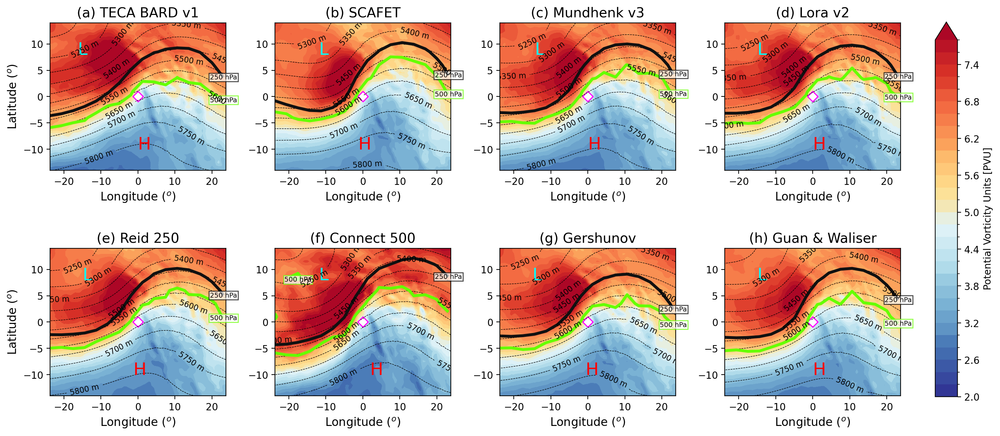

In [35]:
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']
variables = ['pv','z','msl','tcwv','ivt']

fig,axes = plt.subplots(ncols=4, nrows = 2, figsize=(16,9))
plt.tight_layout(pad=12,h_pad=6,w_pad=2)
for (ix,ax),alg in zip(enumerate(axes.flat),algorithms):
    
    
    plot_data = eval(f'{alg}_merra')['epv']['EPV']/1e-7
    plot = plot_data.sel(lev=500).plot.contourf(ax=ax, 
                                                  levels=np.arange(2,8,0.2),
                          cmap=cmaps.cmp_b2r,

                          add_colorbar=False, alpha=1)
    fmt = mtk.StrMethodFormatter("{x:1.0f} m")

    ############## 850 hPa ###############

    #plot_data = eval(f'{alg}_data')['tcwv']['TCWV'] #(kgm$^{-2}$)
    #z1=plot_data.plot.contour(ax=ax, 
     #                     cmap='red',
      #                    add_colorbar=False,linestyles='solid', linewidths = 0.5)
    #z1.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)

    z_plot = eval(f'{alg}_merra')['h']['H']#/1000
    z1 = z_plot.sel(lev=500).plot.contour(ax=ax,
                                            vmin=5,vmax=6, levels=np.arange(5000,6000,50),
                                      cmap='black',linestyles='dashed',linewidths=0.5)
    z1.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)
    
   
    ######################################### SHOW THE SURFACE PRESSURE LOWS AND HIGHS ################################
    msl_data = eval(f'{alg}_merra')[f'slp']['SLP'].sel(lon=slice(-20,20), lat=slice(-10,10))
    mln, mlt = msl_data.argmin(dim=['lon','lat'])['lon'].values, msl_data.argmin(dim=['lon','lat'])['lat'].values    #obtain the lows positions 
    xln, xlt = msl_data.argmax(dim=['lon','lat'])['lon'].values,msl_data.argmax(dim=['lon','lat'])['lat'].values      #obtain the highs positions

    _text_data = msl_data.isel(lon=mln,lat=mlt)       #select the data for lows 
    _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the lows 
    if _x >= msl_data.lat.max().values - 0.5:
        _x = _x -2
    if _y >= msl_data.lat.max().values - 0.5:
        _y = _y - 2
    ax.text(_x,_y , 'L', fontdict={'size':18,'color':'cyan'})

    _text_data = msl_data.isel(lon=xln,lat=xlt)       #select the data for highs 
    _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the highs 
    if _x >= msl_data.lon.max().values-0.5:
        _x = _x - 4
    if _y >= msl_data.lat.max().values-0.5:
        _y = _y - 1

    ax.text(_x,_y , 'H', fontdict={'size':18, 'color':'red'})
        
    if ix%4 ==0:
        ax.set_ylabel('Latitude ($^o$)', fontsize=12)
        
    else:
        ax.set_ylabel('')
    ax.set_xlabel('Longitude ($^o$)', fontsize=12)
    
    ##############################################################################################################################
    #######################################  make contour plots for wave propagation at different levels  ########################################
    ##############################################################################################################################
    #EPV @ 500 hPa
    #eval(f'{alg}_merra')['h']['norm_H'].sel(lev=500).plot(ax=ax)
    c1 = ax.contour(eval(f'{alg}_merra')['epv']['lon'].values[::5], eval(f'{alg}_merra')['epv']['lat'].values[::5], eval(f'{alg}_merra')['epv']['norm_EPV'].sel(lev=500).values[::5,::5], levels=[0], colors='#66FF00', linewidths=3)
    x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
    ax.text(x,y, '500 hPa',
            fontsize=7,
            ha='center',
            va='center',
           bbox=dict(facecolor='white', edgecolor='#66FF00', alpha=0.7,pad=1))
    
    #EPV @ 250 hPa
    c1 = ax.contour(eval(f'{alg}_merra')['epv']['lon'].values[::5], eval(f'{alg}_merra')['epv']['lat'].values[::5], eval(f'{alg}_merra')['epv']['norm_EPV'].sel(lev=250).values[::5,::5], levels=[0], colors='#111111', linewidths=3)
    x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
    ax.text(x,y, '250 hPa',
            fontsize=7,
            ha='center',
            va='center',
           bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))
    
    ax.scatter(0,0,color='#FF00FF', marker='D', s=60)
    ax.scatter(0,0,color='white', marker='D', s=30)
    ax.set_title(f'({convert(ix)}) {alg_names[ix]}',fontsize=14)
cbar_ax = fig.add_axes([0.92, 0.21, 0.02, 0.6])  # [left, bottom, width, height]
cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5, label='Potential Vorticity Units [PVU]')

plt.savefig('MERRA2_NoCal/Images/merra_PV_z500.png', dpi=300)

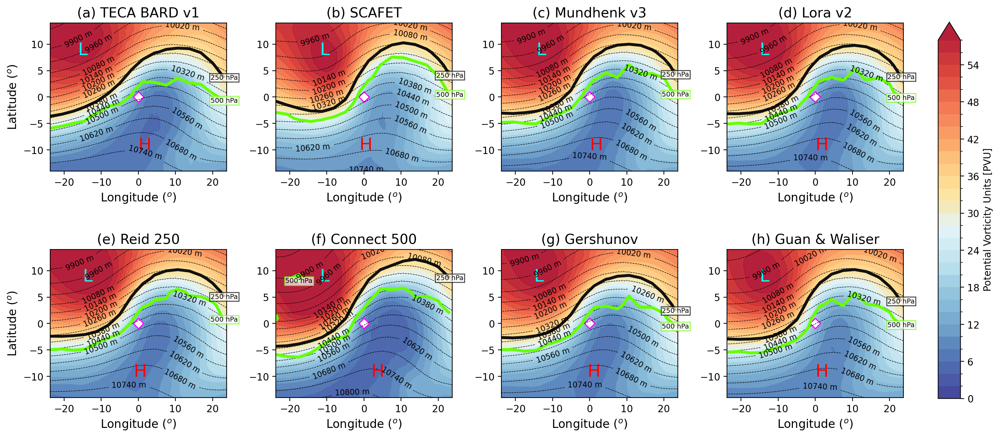

In [36]:
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']
variables = ['pv','z','msl','tcwv','ivt']

fig,axes = plt.subplots(ncols=4, nrows = 2, figsize=(16,9))
plt.tight_layout(pad=12,h_pad=6,w_pad=2)
for (ix,ax),alg in zip(enumerate(axes.flat),algorithms):
    
  
    plot_data = eval(f'{alg}_merra')['epv']['EPV']/1e-7
    plot = plot_data.sel(lev=250).plot.contourf(ax=ax, 
                                                  levels=np.arange(0,60,2),
                          cmap=cmaps.cmp_b2r,

                          add_colorbar=False, alpha=0.9)
    fmt = mtk.StrMethodFormatter("{x:1.0f} m")

    ############## 850 hPa ###############
    #z_plot = eval(f'{alg}_data')['z']['Z']/100
    #z1 = z_plot.sel(level=850).plot.contour(ax=ax,
    #                                  cmap='black',linestyles='dashed')
    #z1.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)


    z_plot = eval(f'{alg}_merra')['h']['H']#/1000
    z1 = z_plot.sel(lev=250).plot.contour(ax=ax,
                                            vmin=9000,vmax=11000, levels=np.arange(9000,11000,60),
                                      cmap='black',linestyles='dashed',linewidths=0.5)
    z1.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)
        
    ######################################### SHOW THE SURFACE PRESSURE LOWS AND HIGHS ################################
    msl_data = eval(f'{alg}_merra')[f'slp']['SLP'].sel(lon=slice(-20,20), lat=slice(-10,10))
    mln, mlt = msl_data.argmin(dim=['lon','lat'])['lon'].values, msl_data.argmin(dim=['lon','lat'])['lat'].values    #obtain the lows positions 
    xln, xlt = msl_data.argmax(dim=['lon','lat'])['lon'].values,msl_data.argmax(dim=['lon','lat'])['lat'].values      #obtain the highs positions

    _text_data = msl_data.isel(lon=mln,lat=mlt)       #select the data for lows 
    _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the lows 
    if _x >= msl_data.lat.max().values - 0.5:
        _x = _x -2
    if _y >= msl_data.lat.max().values - 0.5:
        _y = _y - 2
    ax.text(_x,_y , 'L', fontdict={'size':18,'color':'cyan'})

    _text_data = msl_data.isel(lon=xln,lat=xlt)       #select the data for highs 
    _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the highs 
    if _x >= msl_data.lon.max().values-0.5:
        _x = _x - 4
    if _y >= msl_data.lat.max().values-0.5:
        _y = _y - 1

    ax.text(_x,_y , 'H', fontdict={'size':18, 'color':'red'})
        
    if ix%4 ==0:
        ax.set_ylabel('Latitude ($^o$)', fontsize=12)
        
    else:
        ax.set_ylabel('')
    ax.set_xlabel('Longitude ($^o$)', fontsize=12)
    
    ##############################################################################################################################
    #######################################  make contour plots for wave propagation at different levels  ########################################
    ##############################################################################################################################
    #EPV @ 500 hPa
    #eval(f'{alg}_merra')['h']['norm_H'].sel(lev=500).plot(ax=ax)
    c1 = ax.contour(eval(f'{alg}_merra')['epv']['lon'].values[::5], eval(f'{alg}_merra')['epv']['lat'].values[::5], eval(f'{alg}_merra')['epv']['norm_EPV'].sel(lev=500).values[::5,::5], levels=[0], colors='#66FF00', linewidths=3)
    x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
    ax.text(x,y, '500 hPa',
            fontsize=7,
            ha='center',
            va='center',
           bbox=dict(facecolor='white', edgecolor='#66FF00', alpha=0.7,pad=1))
    
    #EPV @ 250 hPa
    c1 = ax.contour(eval(f'{alg}_merra')['epv']['lon'].values[::5], eval(f'{alg}_merra')['epv']['lat'].values[::5], eval(f'{alg}_merra')['epv']['norm_EPV'].sel(lev=250).values[::5,::5], levels=[0], colors='#111111', linewidths=3)
    x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
    ax.text(x,y, '250 hPa',
            fontsize=7,
            ha='center',
            va='center',
           bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))
    
    ax.scatter(0,0,color='#FF00FF', marker='D', s=60)
    ax.scatter(0,0,color='white', marker='D', s=30)
    ax.set_title(f'({convert(ix)}) {alg_names[ix]}',fontsize=14)
cbar_ax = fig.add_axes([0.92, 0.21, 0.02, 0.6])  # [left, bottom, width, height]
cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5,label='Potential Vorticity Units [PVU]')

plt.savefig('MERRA2_NoCal/Images/merra_PV_z250.png', dpi=300)

## KMEANS 

In [1]:
exec(open('imports.py').read())
import tqdm
import matplotlib.ticker as mtk
from matplotlib.colors import LinearSegmentedColormap

ERROR 1: PROJ: proj_create_from_database: Open of /global/homes/k/kquagra/miniconda3/envs/climate_py311.5/share/proj failed


In [9]:
levs_2_plot = [925,850,700,500,300,250]

In [5]:
70/4

17.5

In [8]:
%%time
algorithms = ['cascade_bard_v1','SCAFET','mundhenk_v3','lora_v2','reid250','connect500','gershunov','guan_waliser']
#algorithms=['SCAFET','mundhenk_v3','lora_v2','reid250','connect500','gershunov','guan_waliser']
variables =['epv','h','omega','slp','tqv','ivt']
groups = np.arange(0,2)
for alx,alg in enumerate(algorithms):
    #locals()[f'{alg}_merra'] = collections.defaultdict(list)
    
    for vx,vb in enumerate(variables):
        
        for gr in groups:
            pths = glob.glob(f'Averages/{alg}_cluster/*{gr}_{vb}*', recursive=True)
            
            if vb == 'tqv':
                ds = xr.open_mfdataset(pths).sel(longitude=slice(-24,24),latitude=slice(-14,14))
            else:
                ds = xr.open_mfdataset(pths).sel(lon=slice(-24,24),lat=slice(-14,14))
            eval(f'{alg}_merra')[f'{vb}_{gr}'] = ds

CPU times: user 437 ms, sys: 315 ms, total: 752 ms
Wall time: 1.02 s


In [522]:
corr_efficients = []

In [533]:
corr_efficients = []
for alx1,alg1 in enumerate(algorithms):
    print(f'{Color.RED}{alg1}_0{Color.END}')
    for gr in groups: 
        #d1 = eval(f'{alg1}_merra')[f'epv_0']['EPV'].sel(lev=500)
        d1 = eval(f'{alg1}_merra')['h_0']['H'].sel(lev=500)
        for alx2,alg2 in enumerate(algorithms):
            print(f'{alg2}_{gr}')
            #d2 = eval(f'{alg2}_merra')[f'epv_{gr}']['EPV'].sel(lev=500)
            d2 =  eval(f'{alg2}_merra')[f'h_{gr}']['H'].sel(lev=500)
            corr_efficients.append(xr.corr(d1,d2).values)
            
for alx1,alg1 in enumerate(algorithms):
    print(f'{Color.RED}{alg1}_1{Color.END}')
    for gr in groups: 
        #d1 = eval(f'{alg1}_merra')[f'epv_1']['EPV'].sel(lev=500)
        d1 = eval(f'{alg1}_merra')['h_1']['H'].sel(lev=500)
        for alx2,alg2 in enumerate(algorithms):
            print(f'{alg2}_{gr}')
            #d2 = eval(f'{alg2}_merra')[f'epv_{gr}']['EPV'].sel(lev=500)
            d2 =  eval(f'{alg2}_merra')[f'h_{gr}']['H'].sel(lev=500)
            corr_efficients.append(xr.corr(d1,d2).values)

cascade_bard_v1_0
cascade_bard_v1_0
SCAFET_0
mundhenk_v3_0
lora_v2_0
reid250_0
connect500_0
gershunov_0
guan_waliser_0
cascade_bard_v1_1
SCAFET_1
mundhenk_v3_1
lora_v2_1
reid250_1
connect500_1
gershunov_1
guan_waliser_1
SCAFET_0
cascade_bard_v1_0
SCAFET_0
mundhenk_v3_0
lora_v2_0
reid250_0
connect500_0
gershunov_0
guan_waliser_0
cascade_bard_v1_1
SCAFET_1
mundhenk_v3_1
lora_v2_1
reid250_1
connect500_1
gershunov_1
guan_waliser_1
mundhenk_v3_0
cascade_bard_v1_0
SCAFET_0
mundhenk_v3_0
lora_v2_0
reid250_0
connect500_0
gershunov_0
guan_waliser_0
cascade_bard_v1_1
SCAFET_1
mundhenk_v3_1
lora_v2_1
reid250_1
connect500_1
gershunov_1
guan_waliser_1
lora_v2_0
cascade_bard_v1_0
SCAFET_0
mundhenk_v3_0
lora_v2_0
reid250_0
connect500_0
gershunov_0
guan_waliser_0
cascade_bard_v1_1
SCAFET_1
mundhenk_v3_1
lora_v2_1
reid250_1
connect500_1
gershunov_1
guan_waliser_1
reid250_0
cascade_bard_v1_0
SCAFET_0
mundhenk_v3_0
lora_v2_0
reid250_0
connect500_0
gershunov_0
guan_waliser_0
cascade_bard_v1_1
SCAFET_1
mun

In [534]:
corr_mat = np.reshape(corr_efficients,(16,16))

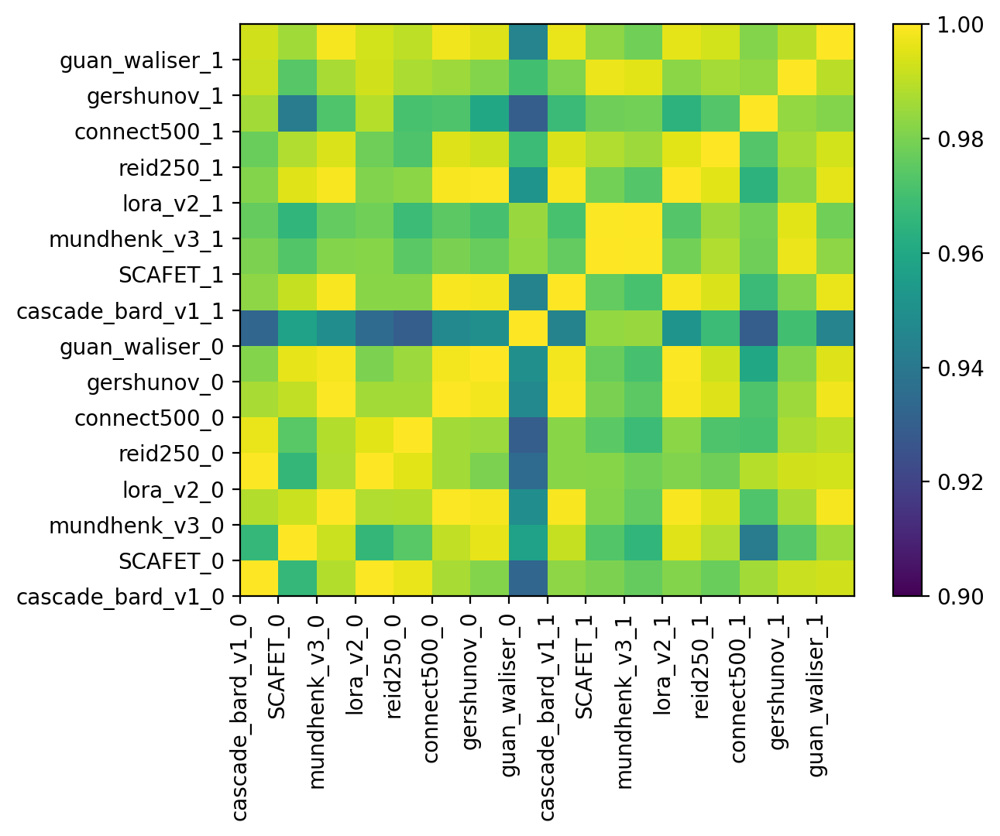

In [548]:
xlabs = [
    "cascade_bard_v1_0", "SCAFET_0", "mundhenk_v3_0", "lora_v2_0", "reid250_0", "connect500_0", 
    "gershunov_0", "guan_waliser_0", "cascade_bard_v1_1", "SCAFET_1", "mundhenk_v3_1", "lora_v2_1", 
    "reid250_1", "connect500_1", "gershunov_1", "guan_waliser_1"]
fig,ax = plt.subplots(ncols=1)
plot = ax.pcolormesh(corr_mat,vmin=0.9,vmax=1)
#ax.set_xlabel(xlabs)
ax.set_xticks(np.arange(0,16),labels=xlabs,rotation=90,ha='center')
ax.set_yticks(np.arange(0,16),labels=xlabs,rotation=360,ha='right')

fig.colorbar(plot)

In [ ]:

##################################################################################################
#                                                         Load data for Kmeans dataset and store them                                                             #
##################################################################################################

algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']
variables = ['h','epv','omega','ivt','slp','tqv']
len_of_data = []
mpath='./MERRA2/'
for alx, alg in enumerate(algorithms):
    locals()[f'{alg}_merra'] = collections.defaultdict(list)
    print(f'{Color.PURPLE}{alg.upper()}{Color.END}')
    for vx,vb in enumerate(variables):
        pths = glob.glob(f'{mpath}conus_ARS_DJF_comps_{alg}_{vb}_raw/*.nc',recursive=True)
        pths.sort()
        #ds = [xr.open_dataset(pt, chunks='auto') for pt in pths]
        #ds = xr.concat(ds,dim='time')
        ds = xr.open_mfdataset(pths, chunks='auto')
        print('Done loading data \nCalculating mean')
        
        with open(f'cluster_numbers/cluster_values_{alg}') as clusters:
            cluster = clusters.readlines()
            cluster = [int(x[0]) for x in cluster]
        print(len(cluster))
            
        ds['time'] = cluster
        
        print('Loading for groups')
        groups = ds.groupby('time').groups.keys()
        for gr in groups:
            if vx <=2:
                typ = 'levels'
                dds = ds.sel(lev=levs_2_plot, time=gr).mean('time').load()
            elif vx>=3:
                typ = 'surface'
                dds = ds.sel(time=gr).mean('time').load()
            
            #eval(f'{alg}_merra')[f'{vb}_c{gr}'] = dds   #.load()  #xr.open_mfdataset(pths, chunks='auto')
            sv_path = f'Averages/'
            
           
            print('Calculating normalisations')
            %time dds[f'norm_{vb.upper()}'] = normalize_variable(dds,var_type=typ).compute()[vb.upper()]
            
            sv_path='Averages/'
            final_path = f'{sv_path}{alg}_cluster/'

            if os.path.isdir(sv_path) == False:
                os.mkdir(sv_path)

            if os.path.isdir(final_path) == False:
                os.mkdir(final_path)
            
            dds.to_netcdf(f'{final_path}{alg}_cluster{gr}_{vb}.nc')
            
            
        #print(len(pths))
        
        #if vx == 0 :
            #len_of_data.append(len(ds.time.values))

CASCADE_BARD_V1
Done loading data 
Calculating mean
6524
Loading for groups
Calculating normalisations
CPU times: user 4.25 ms, sys: 50 µs, total: 4.3 ms
Wall time: 4.18 ms
Calculating normalisations
CPU times: user 4.32 ms, sys: 65 µs, total: 4.39 ms
Wall time: 4.27 ms
Done loading data 
Calculating mean
6524
Loading for groups
Calculating normalisations
CPU times: user 4.68 ms, sys: 139 µs, total: 4.82 ms
Wall time: 4.8 ms
Calculating normalisations
CPU times: user 4.44 ms, sys: 89 µs, total: 4.53 ms
Wall time: 4.53 ms
Done loading data 
Calculating mean
6524
Loading for groups
Calculating normalisations
CPU times: user 4.35 ms, sys: 70 µs, total: 4.42 ms
Wall time: 4.27 ms
Calculating normalisations
CPU times: user 4.7 ms, sys: 141 µs, total: 4.84 ms
Wall time: 4.7 ms
Done loading data 
Calculating mean
6524
Loading for groups
Calculating normalisations
CPU times: user 4.09 ms, sys: 17 µs, total: 4.11 ms
Wall time: 4.09 ms
Calculating normalisations
CPU times: user 4.32 ms, sys: 64 

In [11]:
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']
#variables = ['ivt','slp',
variables=['tqv']
len_of_data = []
mpath='./MERRA2/'
for alx, alg in enumerate(algorithms):
    #locals()[f'{alg}_merra'] = collections.defaultdict(list)
    print(f'{Color.PURPLE}{alg.upper()}{Color.END}')
    for vx,vb in enumerate(variables):
        pths = glob.glob(f'{mpath}conus_ARS_DJF_comps_{alg}_{vb}_raw/*.nc',recursive=True)
        pths.sort()
        #ds = [xr.open_dataset(pt, chunks='auto') for pt in pths]
        #ds = xr.concat(ds,dim='time')
        ds = xr.open_mfdataset(pths, chunks='auto')
        print('Done loading data \nCalculating mean')
        #dds = ds.mean('time')
        
        #Do this because GW had a larger data size, so I did the clustering in smaller chunks and had 4 different files for the cluster.
        #if alg != 'guan_waliser':
        with open(f'cluster_numbers/cluster_values_{alg}') as clusters:
            cluster = clusters.readlines()
            cluster = [int(x[0]) for x in cluster]
        print(len(cluster))
            
        ds['time'] = cluster
        
        print('Loading for groups')
        groups = ds.groupby('time').groups.keys()
        for gr in groups:
            eval(f'{alg}_merra')[f'{vb}_c{gr}'] = ds.sel(time=gr).mean('time').load()#.load()  #xr.open_mfdataset(pths, chunks='auto')
        print(len(pths))
        
        if vx == 0 :
            len_of_data.append(len(ds.time.values))

CASCADE_BARD_V1
Done loading data 
Calculating mean
6524
Loading for groups
38
SCAFET
Done loading data 
Calculating mean
26310
Loading for groups
38
MUNDHENK_V3
Done loading data 
Calculating mean
16601
Loading for groups
38
LORA_V2
Done loading data 
Calculating mean
13783
Loading for groups
37
REID250
Done loading data 
Calculating mean
16557
Loading for groups
38
CONNECT500
Done loading data 
Calculating mean
3121
Loading for groups
38
GERSHUNOV
Done loading data 
Calculating mean
18043
Loading for groups
37
GUAN_WALISER
Done loading data 
Calculating mean
78522
Loading for groups
38


In [5]:
def count_elements_with_number(lst, target):
    return len([element for element in lst if element == target])

cluster_lengths = []

cluster_len = []
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']
for alx, alg in enumerate(algorithms):
   
    with open(f'cluster_numbers/cluster_values_{alg}') as clusters:
        cluster = clusters.readlines()
        cluster = [int(x[0]) for x in cluster]

        CLS=[]
        for x_ in np.arange(1,3):
            res = count_elements_with_number(cluster,x_-1)
            CLS.append([x_-1 ,res])

        #for x_ in np.arange(1,5):
        eval(f'cluster_len').append(sorted(CLS, key=lambda x: x[1], reverse=True))
        print(len(cluster))
    cluster_lengths.append(len(cluster))

6524
26310
16601
13783
16557
3121
18043
78522


In [6]:
kk = np.array(cluster_len)

In [7]:
cluster1_len = kk[:,0]
cluster2_len = kk[:,1]
#cluster3_len = kk[:,2]
#cluster4_len = kk[:,3]

In [ ]:
######################################### SHOW THE SURFACE PRESSURE LOWS AND HIGHS ################################
        msl_data = eval(f'{alg}_merra')[f'slp_c{clust[0]}']['SLP'].sel(lon=slice(-22,22),lat=slice(-14.5,14.5))
        mln, mlt = msl_data.argmin(dim=['lon','lat'])['lon'], msl_data.argmin(dim=['lon','lat'])['lat']    #obtain the lows positions 
        xln, xlt = msl_data.argmax(dim=['lon','lat'])['lon'],msl_data.argmax(dim=['lon','lat'])['lat']      #obtain the highs positions
        
        _text_data = msl_data.isel(lon=mln,lat=mlt)       #select the data for lows 
        _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the lows 
        if _x >= msl_data.lat.max().values - 0.5:
            _x = _x -2
        if _y >= msl_data.lat.max().values - 0.5:
            _y = _y - 2
        ax.text(_x,_y , 'L', fontdict={'size':16,'color':'blue'})
        
        _text_data = msl_data.isel(lon=xln,lat=xlt)       #select the data for highs 
        _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the highs 
        if _x >= msl_data.lon.max().values-0.5:
            _x = _x - 4
        if _y >= msl_data.lat.max().values-0.5:
            _y = _y - 1
            
        ax.text(_x,_y , 'H', fontdict={'size':16, 'color':'red'})

In [181]:
clust

array([    0, 36191])

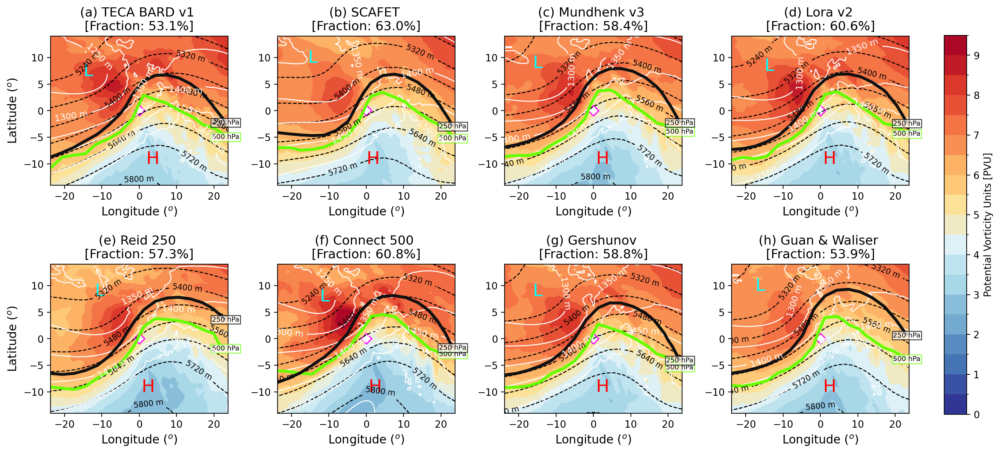

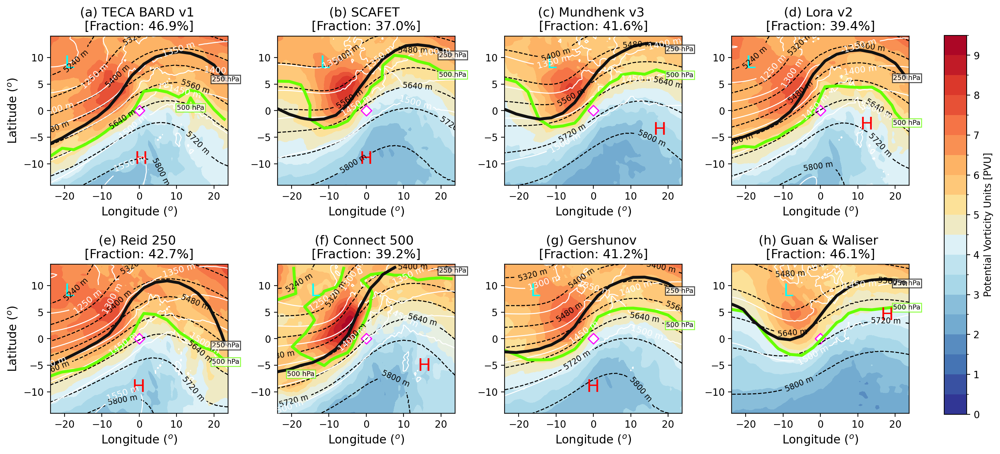

In [43]:
vbls = ['epv','h']
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']
#clust_2_plot = [0,1]
for nx in range(2):
    
    clus_2_plot = eval(f'cluster{nx+1}_len')
    fig, axes = plt.subplots(ncols=4,nrows = 2, figsize=(16,9))
    plt.tight_layout(pad=12,h_pad=6,w_pad=2)
    
    for (ix,alg),ax,clust  in zip(enumerate(algorithms),axes.flat,clus_2_plot):
        d2plot = eval(f'{alg}_merra')[f'epv_{clust[0]}'].sel(lev=500)/1e-7
        
        levs=np.arange(0,10,0.5)  # Adjust the number of levels as needed
        #norm = plt.Normalize(levels.min(), levels.max())
        
        plot=d2plot['EPV'].plot.contourf(ax=ax, levels=levs, cmap=cmaps.cmp_b2r,add_colorbar=False)
        
        fmt = mtk.StrMethodFormatter("{x:1.0f} m")
        z_plot = eval(f'{alg}_merra')[f'h_{clust[0]}']
        z1 = z_plot['H'].sel(lev=500).plot.contour(ax=ax,
                                                vmin=5000,vmax=6000, levels=np.arange(5000,6000,80),
                                          cmap='black',linestyles='dashed',linewidths=1)
        z1.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)
        
        z1 = z_plot['H'].sel(lev=850).plot.contour(ax=ax,
                                                vmin=1000,vmax=2000, levels=np.arange(1000,2000,50),
                                          cmap='white',linestyles='solid',linewidths=1)
        z1.clabel(fmt=fmt,inline = True,fontsize=9,rightside_up=True)
        
        ######################################### SHOW THE SURFACE PRESSURE LOWS AND HIGHS ################################
        msl_data = eval(f'{alg}_merra')[f'slp_{clust[0]}']['SLP'].sel(lon=slice(-20,20), lat=slice(-10,10))
        mln, mlt = msl_data.argmin(dim=['lon','lat'])['lon'].values, msl_data.argmin(dim=['lon','lat'])['lat'].values    #obtain the lows positions 
        xln, xlt = msl_data.argmax(dim=['lon','lat'])['lon'].values,msl_data.argmax(dim=['lon','lat'])['lat'].values      #obtain the highs positions

        _text_data = msl_data.isel(lon=mln,lat=mlt)       #select the data for lows 
        _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the lows 
        if _x >= msl_data.lat.max().values - 0.5:
            _x = _x -2
        if _y >= msl_data.lat.max().values - 0.5:
            _y = _y - 2
        ax.text(_x,_y , 'L', fontdict={'size':18,'color':'cyan'})

        _text_data = msl_data.isel(lon=xln,lat=xlt)       #select the data for highs 
        _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the highs 
        if _x >= msl_data.lon.max().values-0.5:
            _x = _x - 4
        if _y >= msl_data.lat.max().values-0.5:
            _y = _y - 1

        ax.text(_x,_y , 'H', fontdict={'size':18, 'color':'red'})

        if ix%4 ==0:
            ax.set_ylabel('Latitude ($^o$)', fontsize=12)

        else:
            ax.set_ylabel('')
        ax.set_xlabel('Longitude ($^o$)', fontsize=12)

        ##############################################################################################################################
        #######################################  make contour plots for wave propagation at different levels  ########################################
        ##############################################################################################################################
        #EPV @ 500 hPa
        #eval(f'{alg}_merra')['h']['norm_H'].sel(lev=500).plot(ax=ax)
        c1 = ax.contour(eval(f'{alg}_merra')[f'epv_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['norm_EPV'].sel(lev=500).values[::5,::5], levels=[0], colors='#66FF00', linewidths=3)
        x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
        ax.text(x,y, '500 hPa',
                fontsize=7,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='#66FF00', alpha=0.7,pad=1))

        #EPV @ 250 hPa
        c1 = ax.contour(eval(f'{alg}_merra')[f'epv_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['norm_EPV'].sel(lev=250).values[::5,::5], levels=[0], colors='#111111', linewidths=3)
        x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
        ax.text(x,y, '250 hPa',
                fontsize=7,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))
        ax.scatter(0,0,color='#FF00FF', marker='D', s=60)
        ax.scatter(0,0,color='white', marker='D', s=30)
        
        totals = len_of_data[ix]
        elem = clust[1]
        perc = (elem/totals) * 100
        ax.set_title(f'({convert(ix)}) {alg_names[ix]} \n[Fraction: {round(perc,1)}%]',fontsize=13)
    cbar_ax = fig.add_axes([0.92, 0.21, 0.02, 0.6])  # [left, bottom, width, height]
    cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5,label='Potential Vorticity Units [PVU]')
    plt.savefig(f'Images/kmeans_Cluster{nx}_midlevel.png',dpi=300)

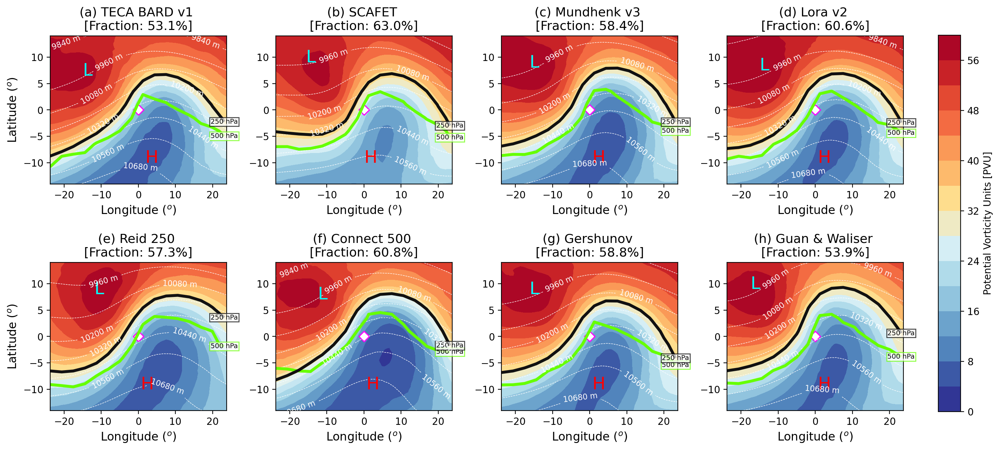

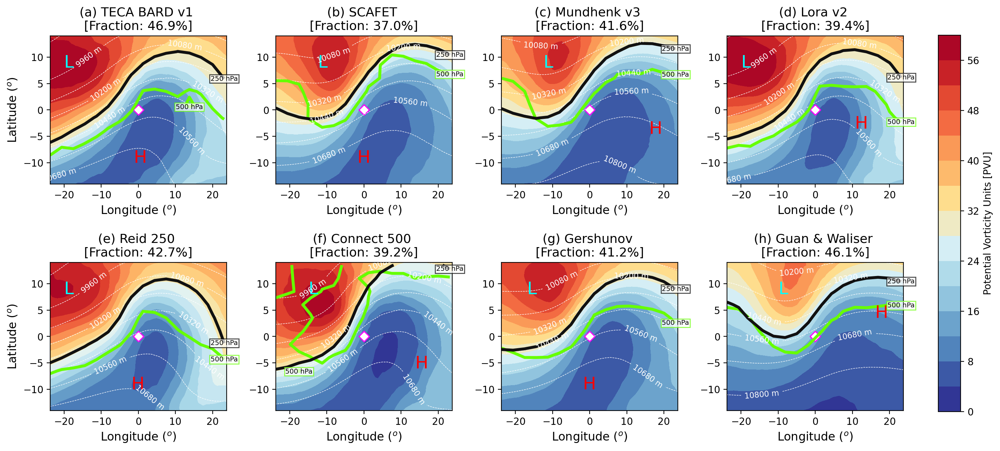

In [41]:
vbls = ['epv','h']
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']

for nx in range(2):
    
    clus_2_plot = eval(f'cluster{nx+1}_len')
    fig, axes = plt.subplots(ncols=4,nrows = 2, figsize=(16,9))
    plt.tight_layout(pad=12,h_pad=6,w_pad=2)
    
    for (ix,alg),ax,clust  in zip(enumerate(algorithms),axes.flat,clus_2_plot):
        d2plot = eval(f'{alg}_merra')[f'epv_{clust[0]}'].sel(lev=250)/1e-7
        
        levels = np.arange(0,62, 4)  # Adjust the number of levels as needed
        norm = plt.Normalize(levels.min(), levels.max())
        
        plot=d2plot['EPV'].plot.contourf(ax=ax,levels=levels,norm=norm, cmap=cmaps.cmp_b2r, add_colorbar=False,)
        

        fmt = mtk.StrMethodFormatter("{x:1.0f} m")
        z_plot = eval(f'{alg}_merra')[f'h_{clust[0]}']
        z1 = z_plot['H'].sel(lev=250).plot.contour(ax=ax,
                                                vmin=9,vmax=11, levels=np.arange(9000,11000,120),
                                          cmap='white',linestyles='dashed',linewidths=0.5)
        z1.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)
        
        
        ######################################### SHOW THE SURFACE PRESSURE LOWS AND HIGHS ################################
        msl_data = eval(f'{alg}_merra')[f'slp_{clust[0]}']['SLP'].sel(lon=slice(-20,20), lat=slice(-10,10))
        mln, mlt = msl_data.argmin(dim=['lon','lat'])['lon'].values, msl_data.argmin(dim=['lon','lat'])['lat'].values    #obtain the lows positions 
        xln, xlt = msl_data.argmax(dim=['lon','lat'])['lon'].values,msl_data.argmax(dim=['lon','lat'])['lat'].values      #obtain the highs positions

        _text_data = msl_data.isel(lon=mln,lat=mlt)       #select the data for lows 
        _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the lows 
        if _x >= msl_data.lat.max().values - 0.5:
            _x = _x -2
        if _y >= msl_data.lat.max().values - 0.5:
            _y = _y - 2
        ax.text(_x,_y , 'L', fontdict={'size':18,'color':'cyan'})

        _text_data = msl_data.isel(lon=xln,lat=xlt)       #select the data for highs 
        _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the highs 
        if _x >= msl_data.lon.max().values-0.5:
            _x = _x - 4
        if _y >= msl_data.lat.max().values-0.5:
            _y = _y - 1

        ax.text(_x,_y , 'H', fontdict={'size':18, 'color':'red'})

        if ix%4 ==0:
            ax.set_ylabel('Latitude ($^o$)', fontsize=12)

        else:
            ax.set_ylabel('')
        ax.set_xlabel('Longitude ($^o$)', fontsize=12)

        ##############################################################################################################################
        #######################################  make contour plots for wave propagation at different levels  ########################################
        ##############################################################################################################################
        #EPV @ 500 hPa
        #eval(f'{alg}_merra')['h']['norm_H'].sel(lev=500).plot(ax=ax)
        c1 = ax.contour(eval(f'{alg}_merra')[f'epv_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['norm_EPV'].sel(lev=500).values[::5,::5], levels=[0], colors='#66FF00', linewidths=3)
        x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
        ax.text(x,y, '500 hPa',
                fontsize=7,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='#66FF00', alpha=0.7,pad=1))

        #EPV @ 250 hPa
        c1 = ax.contour(eval(f'{alg}_merra')[f'epv_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['norm_EPV'].sel(lev=250).values[::5,::5], levels=[0], colors='#111111', linewidths=3)
        x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
        ax.text(x,y, '250 hPa',
                fontsize=7,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))

        ax.scatter(0,0,color='#FF00FF', marker='D', s=60)
        ax.scatter(0,0,color='white', marker='D', s=30)
        
        totals = len_of_data[ix]
        elem = clust[1]
        perc = (elem/totals) * 100
        ax.set_title(f'({convert(ix)}) {alg_names[ix]} \n[Fraction: {round(perc,1)}%]',fontsize=13)
    cbar_ax = fig.add_axes([0.92, 0.21, 0.02, 0.6])  # [left, bottom, width, height]
    cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5,label='Potential Vorticity Units [PVU]')
    
    plt.savefig(f'Images/kmeans_Cluster{nx}_upperlevel.png',dpi=300)

In [416]:
cascade_bard_v1_merra['h']['H']

<xarray.DataArray 'H' (lev: 42, lat: 57, lon: 77)>
dask.array<getitem, shape=(42, 57, 77), dtype=float32, chunksize=(42, 57, 77), chunktype=numpy.ndarray>
Coordinates:
  * lev      (lev) float64 1e+03 975.0 950.0 925.0 900.0 ... 0.7 0.5 0.4 0.3 0.1
  * lat      (lat) float64 -14.0 -13.5 -13.0 -12.5 -12.0 ... 12.5 13.0 13.5 14.0
  * lon      (lon) float64 -23.75 -23.12 -22.5 -21.88 ... 21.88 22.5 23.12 23.75

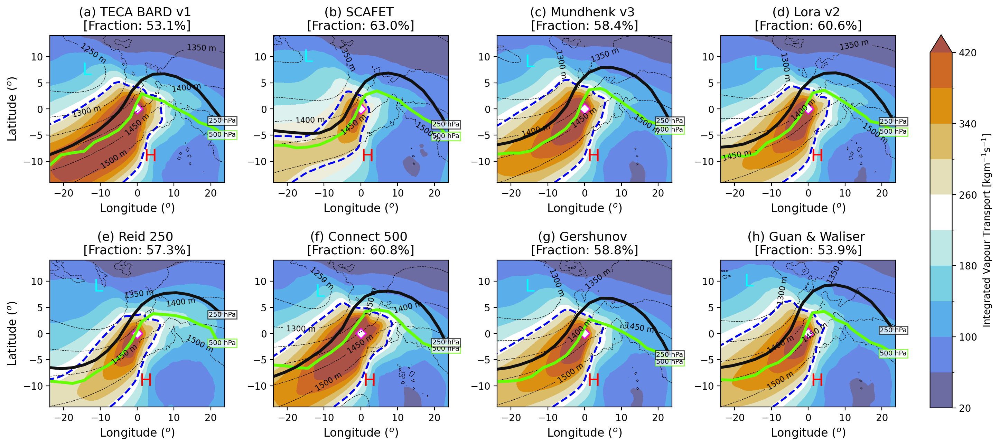

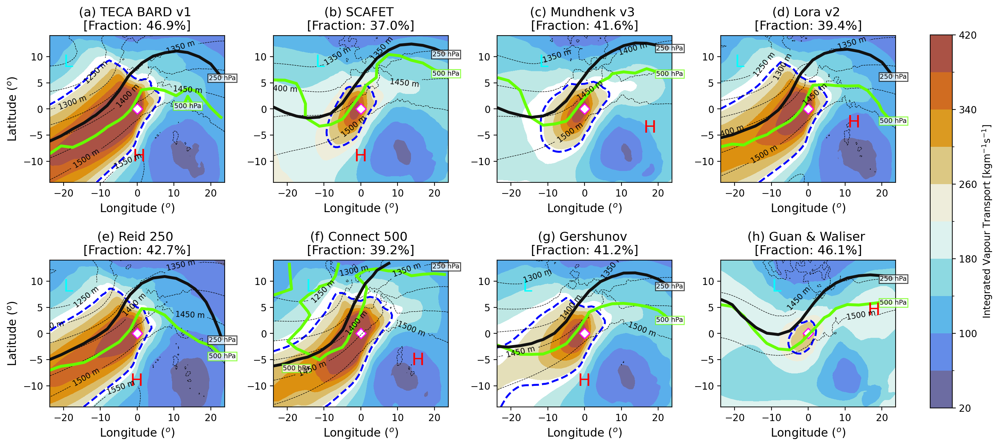

In [11]:
vbls = ['epv','h']
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']

for nx in range(2):
    
    clus_2_plot = eval(f'cluster{nx+1}_len')
    fig, axes = plt.subplots(ncols=4,nrows = 2, figsize=(16,9))
    plt.tight_layout(pad=12,h_pad=6,w_pad=2)
    
    for (ix,alg),ax,clust  in zip(enumerate(algorithms),axes.flat,clus_2_plot):
        d2plot = eval(f'{alg}_merra')[f'ivt_{clust[0]}']['IVT']
        
        levels = np.arange(20,455, 40)  # Adjust the number of levels as needed
        #norm = plt.Normalize(levels.min(), levels.max())

        plot = d2plot.plot.contourf(ax=ax, 
                          cmap=cmaps.prinsenvlag_r, add_colorbar=False,  levels=levels)
        
        ax.contour(d2plot['lon'], d2plot['lat'], d2plot, levels=[250], colors='blue', linestyles='dashed',linewidths=2)
        
        fmt = mtk.StrMethodFormatter("{x:1.0f} m")
        z_plot = eval(f'{alg}_merra')[f'h_{clust[0]}']#/1000
        z1 = z_plot['H'].sel(lev=850).plot.contour(ax=ax,
                                                vmin=1000,vmax=2000, levels=np.arange(1000,2000,50),
                                          cmap='black',linestyles='dashed',linewidths=0.5)
        z1.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)
        
        ######################################### SHOW THE SURFACE PRESSURE LOWS AND HIGHS ################################
        msl_data = eval(f'{alg}_merra')[f'slp_{clust[0]}']['SLP'].sel(lon=slice(-20,20), lat=slice(-10,10))
        mln, mlt = msl_data.argmin(dim=['lon','lat'])['lon'].values, msl_data.argmin(dim=['lon','lat'])['lat'].values    #obtain the lows positions 
        xln, xlt = msl_data.argmax(dim=['lon','lat'])['lon'].values,msl_data.argmax(dim=['lon','lat'])['lat'].values      #obtain the highs positions

        _text_data = msl_data.isel(lon=mln,lat=mlt)       #select the data for lows 
        _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the lows 
        if _x >= msl_data.lat.max().values - 0.5:
            _x = _x -2
        if _y >= msl_data.lat.max().values - 0.5:
            _y = _y - 2
        ax.text(_x,_y , 'L', fontdict={'size':18,'color':'cyan'})

        _text_data = msl_data.isel(lon=xln,lat=xlt)       #select the data for highs 
        _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the highs 
        if _x >= msl_data.lon.max().values-0.5:
            _x = _x - 4
        if _y >= msl_data.lat.max().values-0.5:
            _y = _y - 1

        ax.text(_x,_y , 'H', fontdict={'size':18, 'color':'red'})

        if ix%4 ==0:
            ax.set_ylabel('Latitude ($^o$)', fontsize=12)

        else:
            ax.set_ylabel('')
        ax.set_xlabel('Longitude ($^o$)', fontsize=12)

        ##############################################################################################################################
        #######################################  make contour plots for wave propagation at different levels  ########################################
        ##############################################################################################################################
        #EPV @ 500 hPa
        #eval(f'{alg}_merra')['h']['norm_H'].sel(lev=500).plot(ax=ax)
        c1 = ax.contour(eval(f'{alg}_merra')[f'epv_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['norm_EPV'].sel(lev=500).values[::5,::5], levels=[0], colors='#66FF00', linewidths=3)
        x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
        ax.text(x,y, '500 hPa',
                fontsize=7,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='#66FF00', alpha=0.7,pad=1))

        #EPV @ 250 hPa
        c1 = ax.contour(eval(f'{alg}_merra')[f'epv_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['norm_EPV'].sel(lev=250).values[::5,::5], levels=[0], colors='#111111', linewidths=3)
        x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
        ax.text(x,y, '250 hPa',
                fontsize=7,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))

        ax.scatter(0,0,color='#FF00FF', marker='D', s=60)
        ax.scatter(0,0,color='white', marker='D', s=30)
        
        totals = len_of_data[ix]
        elem = clust[1]
        perc = (elem/totals) * 100
        ax.set_title(f'({convert(ix)}) {alg_names[ix]} \n[Fraction: {round(perc,1)}%]',fontsize=13)
    cbar_ax = fig.add_axes([0.92, 0.21, 0.02, 0.6])  # [left, bottom, width, height]
    cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5,label='Integrated Vapour Transport [kgm$^{-1}$s$^{-1}$]')
    
    plt.savefig(f'Images/kmeans_Cluster{nx}_lowlevel.png',dpi=300)

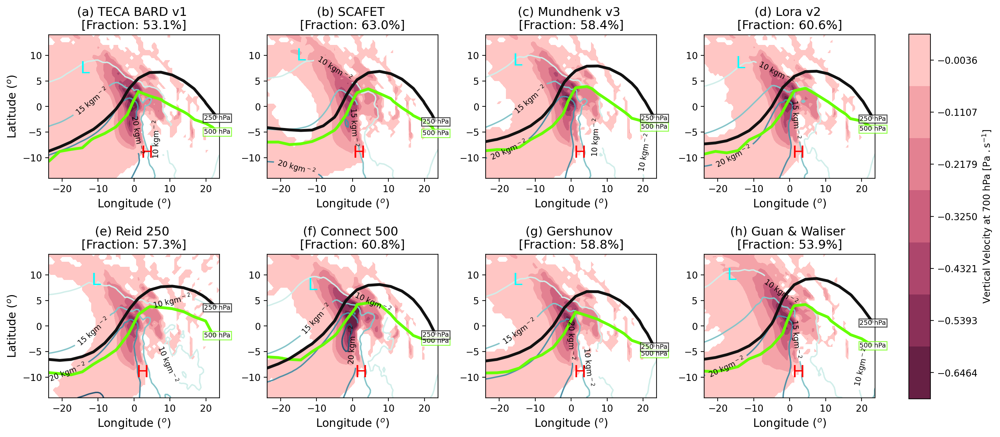

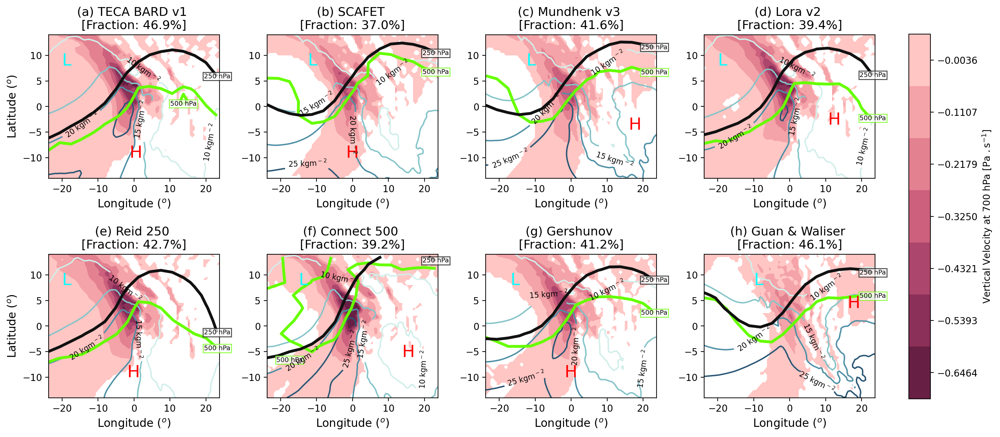

In [20]:
vbls = ['epv','h']
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']

for nx in range(2):
    
    clus_2_plot = eval(f'cluster{nx+1}_len')
    fig, axes = plt.subplots(ncols=4,nrows = 2, figsize=(16,9))
    plt.tight_layout(pad=12,h_pad=6,w_pad=2)
    
    for (ix,alg),ax,clust  in zip(enumerate(algorithms),axes.flat,clus_2_plot):
        d2plot = eval(f'{alg}_merra')[f'omega_{clust[0]}']['OMEGA'].sel(lev=700)
        
        levels = np.linspace(0.05,-0.7, 15)  # Adjust the number of levels as needed
        norm = plt.Normalize(levels.min(), levels.max())

        plot = d2plot.where(d2plot.values<0.01).plot.contourf(ax=ax, 
                          cmap=cmaps.burg_r, add_colorbar=False, norm=norm, levels=levels)
        
        # TQV 
        fmt = mtk.StrMethodFormatter("{x:1.0f} kgm$^-$$^2$")
        tqv_plot = eval(f'{alg}_merra')[f'tqv_{clust[0]}']['TQV']
        t1 = tqv_plot.plot.contour(ax=ax, cmap=cmaps.teal , levels=np.arange(10,30,5))
        t1.clabel(fmt=fmt,colors='black',inline = True,fontsize=8,rightside_up=True)
        ######################################### SHOW THE SURFACE PRESSURE LOWS AND HIGHS ################################
        msl_data = eval(f'{alg}_merra')[f'slp_{clust[0]}']['SLP'].sel(lon=slice(-20,20), lat=slice(-10,10))
        mln, mlt = msl_data.argmin(dim=['lon','lat'])['lon'].values, msl_data.argmin(dim=['lon','lat'])['lat'].values    #obtain the lows positions 
        xln, xlt = msl_data.argmax(dim=['lon','lat'])['lon'].values,msl_data.argmax(dim=['lon','lat'])['lat'].values      #obtain the highs positions

        _text_data = msl_data.isel(lon=mln,lat=mlt)       #select the data for lows 
        _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the lows 
        if _x >= msl_data.lat.max().values - 0.5:
            _x = _x -2
        if _y >= msl_data.lat.max().values - 0.5:
            _y = _y - 2
        ax.text(_x,_y , 'L', fontdict={'size':18,'color':'cyan'})

        _text_data = msl_data.isel(lon=xln,lat=xlt)       #select the data for highs 
        _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the highs 
        if _x >= msl_data.lon.max().values-0.5:
            _x = _x - 4
        if _y >= msl_data.lat.max().values-0.5:
            _y = _y - 1

        ax.text(_x,_y , 'H', fontdict={'size':18, 'color':'red'})

        if ix%4 ==0:
            ax.set_ylabel('Latitude ($^o$)', fontsize=12)

        else:
            ax.set_ylabel('')
        ax.set_xlabel('Longitude ($^o$)', fontsize=12)

        ##############################################################################################################################
        #######################################  make contour plots for wave propagation at different levels  ########################################
        ##############################################################################################################################
        #EPV @ 500 hPa
        #eval(f'{alg}_merra')['h']['norm_H'].sel(lev=500).plot(ax=ax)
        c1 = ax.contour(eval(f'{alg}_merra')[f'epv_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['norm_EPV'].sel(lev=500).values[::5,::5], levels=[0], colors='#66FF00', linewidths=3)
        x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
        ax.text(x,y, '500 hPa',
                fontsize=7,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='#66FF00', alpha=0.7,pad=1))

        #EPV @ 250 hPa
        c1 = ax.contour(eval(f'{alg}_merra')[f'epv_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['norm_EPV'].sel(lev=250).values[::5,::5], levels=[0], colors='#111111', linewidths=3)
        x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
        ax.text(x,y, '250 hPa',
                fontsize=7,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))


        totals = len_of_data[ix]
        elem = clust[1]
        perc = (elem/totals) * 100
        ax.set_title(f'({convert(ix)}) {alg_names[ix]} \n[Fraction: {round(perc,1)}%]',fontsize=13)
    cbar_ax = fig.add_axes([0.92, 0.21, 0.02, 0.6])  # [left, bottom, width, height]
    cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5,label='Vertical Velocity at 700 hPa [Pa $.$s$^{-1}$]')
    
    plt.savefig(f'Images/kmeans_Cluster{nx}_700midlevel.png',dpi=300)

## PGF FORCE AND WAVE STATISTICS

In [77]:
import math
def calc_pgf(data, lon_name = 'lon',lat_name='lat'):
    
    """
    This takes in a data array and computes the pressure gradient force in Pa/degrees lonlat.
    
    Argument:
    data : an xarray data array
    lon_name: name for longitude in dataset 
    lat_name : name for latitude in dataset 
    
    Return
    ---------
    
    PD : difference in pressure
    D : Distance from high pressure and low pressure centers
    PGF: Pressure gradient force
    angle: Angle subtended from the low pressure to the high pressure 
    """
    A = [data.argmin(dim=[lon_name,lat_name])[lon_name].values, data.argmin(dim=[lon_name,lat_name])[lat_name].values]   #obtain low pressure data point
    B = [data.argmax(dim=[lon_name,lat_name])[lon_name].values, data.argmax(dim=[lon_name,lat_name])[lat_name].values]  #obtain high pressure data point
    
    _text_data_A = data.isel(lon=A[0],lat=A[1])    
    _text_data_B = data.isel(lon=B[0],lat=B[1])    
    
    #print(_text_data_A)
    Ax,Ay =_text_data_A.lon.values, _text_data_A.lat.values    #obtain the exact lon, lats for the lows 
    Bx,By =_text_data_B.lon.values, _text_data_B.lat.values    #obtain the exact lon, lats for the highs 
    
    Cx, Cy = Ax, By
    
    PD = _text_data_B - _text_data_A
    #print(PD.values)
    #calculate hypotenuse 
    D = math.sqrt((Bx - Ax)**2 + (By - Ay)**2)           #meters 
    
    adjacent = math.sqrt((Cx-Ax)**2 + (Cy - Ay)**2)       # meters 
    #print(D)
    PGF = PD/D
    
    angle = math.degrees(math.acos(adjacent/D))
    
    return  PGF.values, PD, D, angle, (Ax,Ay), (Bx,By), (Cx,Cy)


def closest_num(list1,target):
    '''Obtain the closest number in list to a target number'''
    return min(list1 , key=lambda x: abs(x-target))

In [265]:
import seaborn as sb

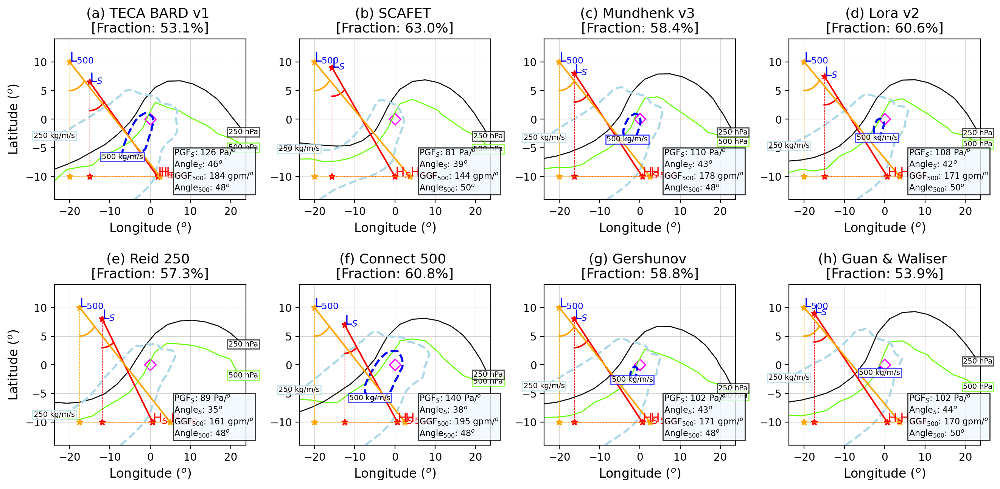

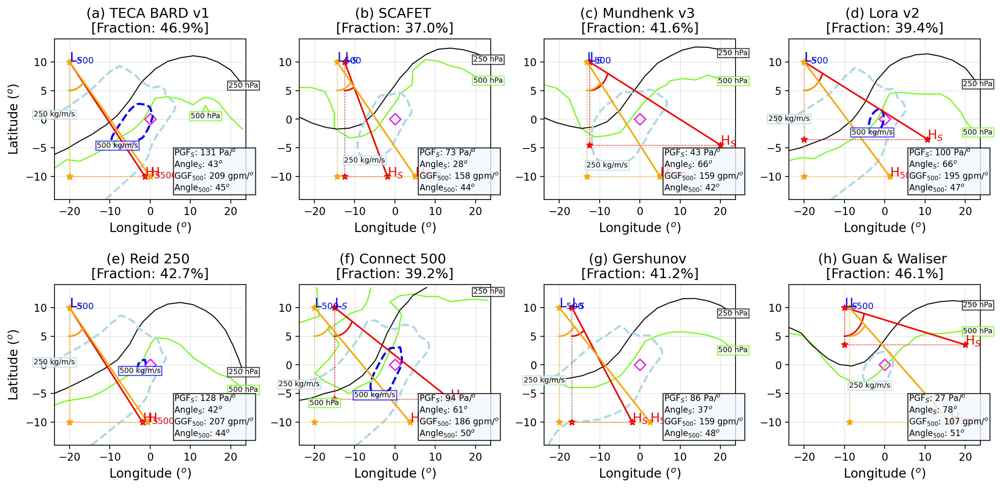

In [95]:
vbls = ['epv','h']
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']

for nx in range(2):
    
    clus_2_plot = eval(f'cluster{nx+1}_len')
    fig, axes = plt.subplots(ncols=4,nrows = 2, figsize=(16,9))
    plt.tight_layout(pad=12,h_pad=6,w_pad=2)
    
    for (ix,alg),ax,clust  in zip(enumerate(algorithms),axes.flat,clus_2_plot):
        ##############################################################################################################################
        #######################################  make contour plots for wave propagation at different levels  ########################################
        ##############################################################################################################################
        #EPV @ 500 hPa
        #eval(f'{alg}_merra')['h']['norm_H'].sel(lev=500).plot(ax=ax)
        c1 = ax.contour(eval(f'{alg}_merra')[f'epv_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['norm_EPV'].sel(lev=500).values[::5,::5], 
                        levels=[0], colors='#66FF00', linewidths=1)
        
        x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
        ax.text(x,y, '500 hPa',
                fontsize=7,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='#66FF00', alpha=0.7,pad=1))

        #EPV @ 250 hPa
        c1_main = ax.contour(eval(f'{alg}_merra')[f'epv_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['norm_EPV'].sel(lev=250).values[::5,::5],
                        levels=[0], colors='#111111', linewidths=1)
        c1 = c1_main
        
        x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
        ax.text(x,y, '250 hPa',
                fontsize=7,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))

        ######################### Plot a line for the amplitude #########################
        #vertices = c1_main.get_paths()[0].vertices
        #amp_loc1,amp_loc2 = vertices[:,1].argmax() ,  vertices[:,1].argmax()                                         #obtain the location of the highest latitude 
        #amp_med_loc = c1_main.get_paths()[0].vertices[:,1].argmax()                                 #obtain the locatoin of the median latitude 
        
        ###################### Check if the absolute of the  trough location is lower than the ridge location, if true, use the trough locatoin to calculate the amplitude #####################
        #if vertices[amp_loc1][1] < abs(vertices[amp_loc2][1]):
        #    amp1_x, amp1_y =  vertices[amp_loc2][0], vertices[amp_loc2][1]
        #else: 
        #    amp1_x, amp1_y =  vertices[amp_loc1][0], vertices[amp_loc1][1]
        #ax.scatter(amp1_x,amp1_y)
        #ax.scatter(amp1_x,amp1_y-amp1_y)

        try:
            #IVT CONTOUR 250kg/m/s
            d2plot = eval(f'{alg}_merra')[f'ivt_{clust[0]}']['IVT']
            c1= ax.contour(d2plot['lon'], d2plot['lat'], d2plot, levels=[250], colors='lightblue', linestyles='dashed',linewidths=2)
            x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
            ax.text(x,y, '250 kg/m/s',
                    fontsize=7,
                    ha='center',
                    va='center',
                   bbox=dict(facecolor='white', edgecolor='lightblue', alpha=0.7,pad=1))
            #IVT CONTOUR 500kg/m/s
            c1 = ax.contour(d2plot['lon'], d2plot['lat'], d2plot, levels=[500], colors='blue', linestyles='dashed',linewidths=2)
            x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
            ax.text(x,y, '500 kg/m/s',
                    fontsize=7,
                    ha='center',
                    va='center',
                   bbox=dict(facecolor='white', edgecolor='blue', alpha=0.7,pad=1))
        except:
            pass
        
        ######################################### SHOW THE SURFACE PRESSURE LOWS AND HIGHS ################################
        msl_data = eval(f'{alg}_merra')[f'slp_{clust[0]}']['SLP'].sel(lon=slice(-20,20), lat=slice(-10,10))
        
        PGF, PD, D, angle, A, B, C = calc_pgf(msl_data)
        
        #ax.scatter(_xl,_yl, color='cyan')
        ax.text(A[0],A[1] , 'L$_{S}$', fontdict={'size':12,'color':'blue'})
        
        points_x = [A[0],B[0]]
        points_y = [A[1],B[1]]
        ax.text(B[0],B[1] , 'H$_{S}$', fontdict={'size':12, 'color':'red'})
        ax.plot(points_x,points_y, marker='*', color='red')
        
        points_x = [A[0],C[0]]
        points_y = [A[1],C[1]]
        ax.plot(points_x,points_y, marker='*',linestyle='dashed', color='red',linewidth=0.5)
        
        points_x = [C[0],B[0]]
        points_y = [C[1],B[1]]
        ax.plot(points_x,points_y, marker='*',linestyle='dashed', color='red',linewidth=0.5)
        
        # Create a curve around corner A
        radius = 5  # Radius of the curve
        theta = np.linspace((3/2)*np.pi, (3/2)*np.pi + np.radians(angle),  100)  # Angle range for the curve
        x_curve = A[0] + radius * np.cos(theta)
        y_curve = A[1] + radius * np.sin(theta)
        ax.plot(x_curve, y_curve, 'r-', label='Curve around corner A')
        
        

        # Plot the triangle and the midpoint of line AB
        #midpoint_AB = ((A[0] + B[0]) / 2, (A[1] + B[1]) / 2)
        #ax.plot(midpoint_AB[0], midpoint_AB[1], marker='*',color='red' )  # Mark midpoint of line AB
        
        if ix%4 ==0:
            ax.set_ylabel('Latitude ($^o$)', fontsize=12)
        
        else:
            ax.set_ylabel('')
        ax.set_xlabel('Longitude ($^o$)', fontsize=12)

        epv500 = eval(f'{alg}_merra')[f'h_{clust[0]}']['H'].sel(lev=500,lon=slice(-20,20), lat=slice(-10,10))*10#/1e-7
        PGF500, PD500, D500, angle500, A500, B500, C500 = calc_pgf(epv500)
        
        #ax.scatter(_xl,_yl, color='cyan')
        ax.text(A500[0],A500[1] , 'L$_{500}$', fontdict={'size':12,'color':'blue'})
        
        points_x = [A500[0],B500[0]]
        points_y = [A500[1],B500[1]]
        ax.text(B500[0], B500[1] , 'H$_{500}$', fontdict={'size':12, 'color':'red'})
        ax.plot(points_x,points_y, marker='*', color='#FFA500')
        
        points_x = [A500[0],C500[0]]
        points_y = [A500[1],C500[1]]
        ax.plot(points_x,points_y, marker='*',linestyle='dashed', color='#FFA500',linewidth=0.5)
        
        points_x = [C500[0],B500[0]]
        points_y = [C500[1],B500[1]]
        ax.plot(points_x,points_y, marker='*',linestyle='dashed', color='#FFA500',linewidth=0.5)
        
        # Create a curve around corner A
        radius = 5  # Radius of the curve
        theta = np.linspace((3/2)*np.pi, (3/2)*np.pi + np.radians(angle500),  100)  # Angle range for the curve
        x_curve = A500[0] + radius * np.cos(theta)
        y_curve = A500[1] + radius * np.sin(theta)
        ax.plot(x_curve, y_curve, color='#FFA500')
        
        
        
        # Add text boxes with specified content
        ax.text(6, -12.5, f'PGF$_S$: '+f'{round(float(PGF))} Pa/$^o$ \n' + 'Angle$_S$: '+f'{round(angle)}$^o$ \n'+ 'GGF$_{500}$: '+f'{int(PGF500)} gpm/$^o$ \n'+'Angle$_{500}$: '+f'{round(angle500)}$^o$' , 
                fontsize=8, bbox=dict(facecolor='#F0F8FF', alpha=0.8,pad=1))  # PGF_surface textbox

        ax.grid(linewidth=0.2)
        totals = len_of_data[ix]
        elem = clust[1]
        perc = (elem/totals) * 100
        ax.set_title(f'({convert(ix)}) {alg_names[ix]} \n[Fraction: {round(perc,1)}%]',fontsize=13)
        ax.scatter(0,0,color='#FF00FF', marker='D', s=60)
        ax.scatter(0,0,color='white', marker='D', s=30)
    #cbar_ax = fig.add_axes([0.92, 0.21, 0.02, 0.6])  # [left, bottom, width, height]
    #cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5,label='Vertical Velocity at 700 hPa [Pa $.$s$^{-1}$]')
    
    #plt.savefig(f'Images/kmeans_Cluster{nx}_stats.png',dpi=300)

In [80]:
list(vertices[:,1]).index(closest_num(list(vertices[:1]), np.median(vertices[:1])))

ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

In [81]:
(closest_num(list(vertices[:1]), np.median(vertices[:1]))

SyntaxError: incomplete input (2481270909.py, line 1)

In [92]:
vertices[:1]#[1]#/2##[amp_loc1]#/2

array([[-23.75      ,   6.50367484]])

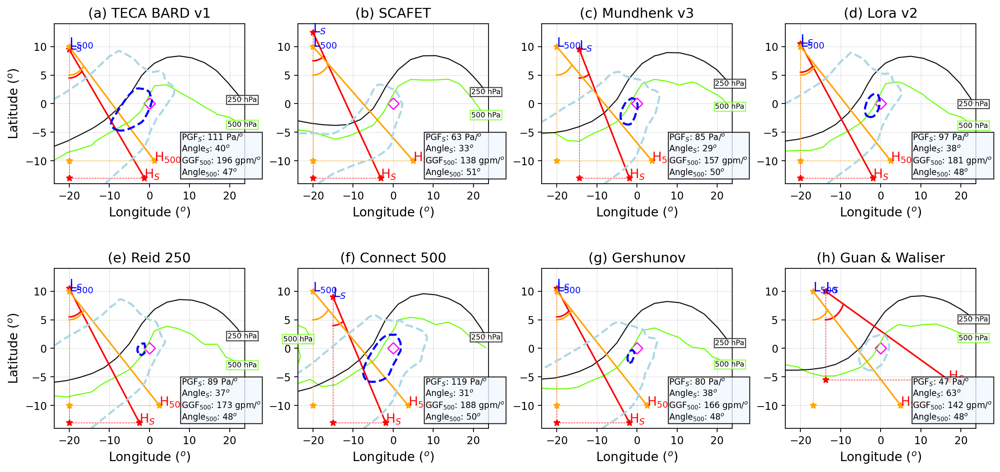

In [49]:
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']
variables = ['pv','z','msl','tcwv','ivt']

fig,axes = plt.subplots(ncols=4, nrows = 2, figsize=(16,9))
plt.tight_layout(pad=12,h_pad=6,w_pad=2)
for (ix,ax),alg in zip(enumerate(axes.flat),algorithms):
    ##############################################################################################################################
    #######################################  make contour plots for wave propagation at different levels  ########################################
    ##############################################################################################################################
    #EPV @ 500 hPa
    #eval(f'{alg}_merra')['h']['norm_H'].sel(lev=500).plot(ax=ax)
    c1 = ax.contour(eval(f'{alg}_merra')[f'epv']['lon'].values[::5], eval(f'{alg}_merra')[f'epv']['lat'].values[::5], eval(f'{alg}_merra')[f'epv']['norm_EPV'].sel(lev=500).values[::5,::5], 
                    levels=[0], colors='#66FF00', linewidths=1)
    x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
    ax.text(x,y, '500 hPa',
            fontsize=7,
            ha='center',
            va='center',
           bbox=dict(facecolor='white', edgecolor='#66FF00', alpha=0.7,pad=1))

    #EPV @ 250 hPa
    c1 = ax.contour(eval(f'{alg}_merra')[f'epv']['lon'].values[::5], eval(f'{alg}_merra')[f'epv']['lat'].values[::5], eval(f'{alg}_merra')[f'epv']['norm_EPV'].sel(lev=250).values[::5,::5],
                    levels=[0], colors='#111111', linewidths=1)
    x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
    ax.text(x,y, '250 hPa',
            fontsize=7,
            ha='center',
            va='center',
           bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))

    
  
        
    ######################################### SHOW THE SURFACE PRESSURE LOWS AND HIGHS ################################
    msl_data = eval(f'{alg}_merra')[f'slp']['SLP'].sel(lon=slice(-20,20), lat=slice(-13,13))

    PGF, PD, D, angle, A, B, C = calc_pgf(msl_data)

    #ax.scatter(_xl,_yl, color='cyan')
    ax.text(A[0],A[1] , 'L$_{S}$', fontdict={'size':12,'color':'blue'})

    points_x = [A[0],B[0]]
    points_y = [A[1],B[1]]
    ax.text(B[0],B[1] , 'H$_{S}$', fontdict={'size':12, 'color':'red'})
    ax.plot(points_x,points_y, marker='*', color='red')

    points_x = [A[0],C[0]]
    points_y = [A[1],C[1]]
    ax.plot(points_x,points_y, marker='*',linestyle='dashed', color='red',linewidth=0.5)

    points_x = [C[0],B[0]]
    points_y = [C[1],B[1]]
    ax.plot(points_x,points_y, marker='*',linestyle='dashed', color='red',linewidth=0.5)

    # Create a curve around corner A
    radius = 5  # Radius of the curve
    theta = np.linspace((3/2)*np.pi, (3/2)*np.pi + np.radians(angle),  100)  # Angle range for the curve
    x_curve = A[0] + radius * np.cos(theta)
    y_curve = A[1] + radius * np.sin(theta)
    ax.plot(x_curve, y_curve, 'r-', label='Curve around corner A')



    # Plot the triangle and the midpoint of line AB
    #midpoint_AB = ((A[0] + B[0]) / 2, (A[1] + B[1]) / 2)
    #ax.plot(midpoint_AB[0], midpoint_AB[1], marker='*',color='red' )  # Mark midpoint of line AB

    if ix%4 ==0:
        ax.set_ylabel('Latitude ($^o$)', fontsize=12)

    else:
        ax.set_ylabel('')
    ax.set_xlabel('Longitude ($^o$)', fontsize=12)

    epv500 = eval(f'{alg}_merra')[f'h']['H'].sel(lev=500,lon=slice(-20,20), lat=slice(-10,10))*10#/1e-7
    PGF500, PD500, D500, angle500, A500, B500, C500 = calc_pgf(epv500)

    #ax.scatter(_xl,_yl, color='cyan')
    ax.text(A500[0],A500[1] , 'L$_{500}$', fontdict={'size':12,'color':'blue'})

    points_x = [A500[0],B500[0]]
    points_y = [A500[1],B500[1]]
    ax.text(B500[0], B500[1] , 'H$_{500}$', fontdict={'size':12, 'color':'red'})
    ax.plot(points_x,points_y, marker='*', color='#FFA500')

    points_x = [A500[0],C500[0]]
    points_y = [A500[1],C500[1]]
    ax.plot(points_x,points_y, marker='*',linestyle='dashed', color='#FFA500',linewidth=0.5)

    points_x = [C500[0],B500[0]]
    points_y = [C500[1],B500[1]]
    ax.plot(points_x,points_y, marker='*',linestyle='dashed', color='#FFA500',linewidth=0.5)

    # Create a curve around corner A
    radius = 5  # Radius of the curve
    theta = np.linspace((3/2)*np.pi, (3/2)*np.pi + np.radians(angle500),  100)  # Angle range for the curve
    x_curve = A500[0] + radius * np.cos(theta)
    y_curve = A500[1] + radius * np.sin(theta)
    ax.plot(x_curve, y_curve, color='#FFA500')

    #IVT CONTOUR 250kg/m/s
    d2plot = eval(f'{alg}_merra')[f'ivt_{clust[0]}']['IVT']
    ax.contour(d2plot['lon'], d2plot['lat'], d2plot, levels=[250], colors='lightblue', linestyles='dashed',linewidths=2)
    ax.contour(d2plot['lon'], d2plot['lat'], d2plot, levels=[500], colors='blue', linestyles='dashed',linewidths=2)

    # Add text boxes with specified content
    ax.text(8, -12.5, f'PGF$_S$: '+f'{round(float(PGF))} Pa/$^o$ \n' + 'Angle$_S$: '+f'{round(angle)}$^o$ \n'+ 'GGF$_{500}$: '+f'{int(PGF500)} gpm/$^o$ \n'+'Angle$_{500}$: '+f'{round(angle500)}$^o$' , 
            fontsize=8, bbox=dict(facecolor='#F0F8FF', alpha=0.8,pad=1))  # PGF_surface textbox

    ax.grid(linewidth=0.2)
    totals = len_of_data[ix]
    elem = clust[1]
    perc = (elem/totals) * 100
    ax.set_title(f'({convert(ix)}) {alg_names[ix]}',fontsize=13)
    ax.scatter(0,0,color='#FF00FF', marker='D', s=60)
    ax.scatter(0,0,color='white', marker='D', s=30)
plt.savefig(f'Images/kmeans_Cluster_stats.png',dpi=300)

In [ ]:
vbls=['pv','pt']
for vb in vbls:
    
    if vb == 'epv' or vb =='h':
        nrows = 1
        ncols = 2
        figure_size = (20, 8.5)
    else:
        nrows = 2 
        ncols = 2
        figure_size = (20, 18)
    
    fig = plt.figure(figsize= figure_size, constrained_layout=False)
    outer_grid = fig.add_gridspec(nrows, ncols, wspace=0.15, hspace=0.4)

    ct=0
    for a in range(nrows):
        for b in range(ncols):
            try:
                
                # gridspec inside gridspec
                inner_grid = outer_grid[a, b].subgridspec(2, 2, wspace=0.1, hspace=0.3)  #set the inner grid based on the outer grid axis positions
                axs = inner_grid.subplots(sharex=True, sharey=True)  # Create all subplots for the inner grid.


                #iteratres through the grid axes for each of the four quadrants 
                for (cdx, ax),f, rpnms  in zip(enumerate(axs.flat),flds,rep_names):
                    ds = eval(f'{f}_kmeans')[vb]  #set the data as ds 
                    
                    #ax.set_title(flds[cdx])
                    d_num=eval(f'num_{f}_{vb}')[ct][1]
                    el_num = eval(f'num_{f}_{vb}')[ct][0] 
                    if vb == 'q':
                        eval(f'{f}_kmeans')['ws']['time'] = eval(f'{f}_kmeans')['q'].time
                    else:
                        eval(f'{f}_kmeans')['ws']['time'] = eval(f'{f}_kmeans')[vb].time
                        
                    windspeed = eval(f'{f}_kmeans')['ws'].sel(time=d_num)
                    
                    if vb == 'q':
                        ds = ds.sel(time=d_num) *1000    

                        #variable requirements 
                        vmn = 0 ; vmx = 10                 #set max and min for plot 
                        lvl = np.arange(-2,8,0.2)         #set levels intervals for plot 
                        cmp = 'hsv'#'CMRmap'
                        units = '(kg/kg)'

                    elif vb == 'epv':
                        ds = ds.sel(time=d_num) /1e-7
                        vmn = 0 ; vmx = 10                    #set max and min for plot 
                        lvl = np.arange(-2,2.01,0.1)            #set levels intervals for plot
                        cmp = 'bwr'
                        units = '(PVU)'


                    var_list=list(ds[vb.upper()].dims)  #check for the list of variables 

                    if var_list.count('time') == True:
                        p1 = ds[vb.upper()].mean('time').plot.contourf(ax=ax,vmax=vmx, vmin = vmn, levels=lvl,
                                                                  cmap=cmp,
                                                                      add_colorbar=False)   #plot data 
                        

                    #use this instead
                    elif var_list.count('time') == False:
                        ds[vb.upper()].plot.contourf(ax=ax,cmap='Reds',cbar_kwargs={'orientation':'horizontal'})  #plot data 

                   
                    
                    if cdx%2 != 0:
                        ax.set_ylabel('')
                    else:
                        ax.set_ylabel('Pressure Level [hPa]',fontsize=13)

                    if cdx/1 >1:
                        ax.set_xlabel('Longitude [$^o$]',fontsize=13)
                    else:
                        ax.set_xlabel('')
                    ax.tick_params(labelsize=12)
                    ax.set_ylim(150,1000)
                    ax.axhline(300,color='black', linestyle='dashed')
                    ax.axhline(875,color='black', linestyle='dashed')

                    ax.axvline(62,color='black', linestyle='dashed')
                    ax.axvline(72,color='black', linestyle='dashed')

                    ax.plot(x,y,color='grey')
                    ax.fill_between(x, y, 1000, interpolate=True, color='black', alpha=1)
                    #ax.set_yscale('symlog')
                    ax.invert_yaxis()
                cbar = fig.colorbar(p1,ax=axs.ravel().tolist(),orientation='vertical',aspect=50,pad=0.05,extend='both') #colorbar
                cbar.set_label(label=f'{vb.upper()} {units}',fontsize=12)
                cbar.ax.tick_params(labelsize=12)
                plt.text(x=29,y=-1150,s=f'RANK {ct +1}', fontdict={'fontsize':14})
                #fig.tight_layout(rect=(0.1,0.1,0.8,0.8))
            except:
                    
                cbar = fig.colorbar(p1,ax=axs.ravel().tolist(),orientation='vertical',aspect=50,pad=0.05,extend='both') #colorbar
                cbar.set_label(label=f'{vb.upper()} {units}',fontsize=12)
                cbar.ax.tick_params(labelsize=12)
                plt.text(x=29,y=-1150,s=f'RANK {ct +1}', fontdict={'fontsize':14})
                #fig.tight_layout(rect=(0.1,0.1,0.8,0.8))
            ct+=1
    #plt.show()
    #plt.savefig(f'../PhD_Images/{reg}_kmeans/{which_type}_kmeans_transects/kmeans_tansects-{vb}.png',dpi=300)

## IDEA 

* create a cluster using all the datasets in the 8 algorithms
* plot the datasets and save the images and use it as the target for image classification. 
* make an image classification script using machine learning image processing and reclassify the datasets based on the categories they fall in for each ARDT individually 

In [3]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score


In [22]:
#K=np.arange(2,10)
silhouette_scores=[]

scaler = StandardScaler()
#####################################################################################
# Note to self: To do the pv and sh stacking for kmeans computation, I have to make the data into 2D. So #
# I first concat along the longitude or latitude (based on which transects), then collapse the lon and lat di-  #
# mensions. This gives an array index of ntime, 2*lon*lat. I do this in the next 2 lines of code                      #
####################################################################################
data1= cascade_bard_v1_merra['epv']['EPV']
data2 = cascade_bard_v1_merra['ivt']['IVT']
new_data = xr.concat([data1,data2],dim=['lat','lon']) #reshape using this! More memory efficient
#new_data = np.reshape(trans_data.values,(len(trans_data.time.values),len(trans_data.level)*len(trans_data[tloc].values)))
ddss = new_data
new_data = new_data.stack(lev_lat=('lev', 'lon','lat','concat_dim')).transpose('time', 'lev_lat') #reshape using this! More memory efficient
#new_data = np.reshape(new_data.values,(len(trans_data.time.values),len(trans_data.level)*len(trans_data[tloc].values)))


print('Scaling data')
scaled_data = np.nan_to_num(np.array((new_data-new_data.mean('time'))/new_data.std('time')),nan=0) #not memory efficient but faster and also replaces nans with 0
#scaled_data = scaler.fit_transform(new_data) #this method is memory efficient bit takes longer time 
k=4
#for k in K:
print(f'Starting K-means {k}')
kmeans = KMeans(n_clusters=k, random_state=0)

print('Fitting scaled data')
clustered_data = kmeans.fit_predict(scaled_data)
#silhouette_avg = silhouette_score(scaled_data, clustered_data)
print('starting silhouette score')
#silhouette_scores.append(silhouette_avg)
#sse.append(kmeans.inertia_)

Scaling data
Starting K-means 4
Fitting scaled data
starting silhouette score


In [9]:
for k in K:
    print(f'Starting K-means {k}')
    kmeans = KMeans(n_clusters=k, random_state=0)

    print('Fitting scaled data')
    clustered_data = kmeans.fit_predict(scaled_data)
    silhouette_avg = silhouette_score(scaled_data, clustered_data)
    silhouette_scores.append(silhouette_avg)
    #sse.append(kmeans.inertia_)

Starting K-means 2
Fitting scaled data


TypeError: 'list' object is not callable

# DO NOT RERUN !! 

In [1]:
exec(open('imports.py').read())
from tqdm import tqdm 
from numba import njit

ERROR 1: PROJ: proj_create_from_database: Open of /global/homes/k/kquagra/miniconda3/envs/climate_py311.5/share/proj failed


In [2]:
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
total_scaled = []

#opem cluster data and obtain the cluster list 
with open('cluster_numbers/cluster_values_all_ardts','r') as f:
    lines = f.readlines()
lines = [int(x[0]) for x in lines]

In [169]:
#load data from merra and assign the cluster numbers to the data for all ARDTs 
#obtain the mid point of the combined ARDTs data
variables = ['ivt']#,'slp','tqv']#['h','epv','omega']
mpath='./MERRA2/'
for vx,vb in enumerate(variables):
    len_of_data = []

    #locals()[f'{alg}_merra'] = collections.defaultdict(list)
    print(f'{Color.PURPLE}{vb.upper()}{Color.END}')
    ct=0
    total_data = []
    for alx, alg in enumerate(algorithms):
        
        #locals()[f'{alg}_merra'] = collections.defaultdict(list)
        print(f'{Color.PURPLE}{alg.upper()}{Color.END}')
        
        pths = glob.glob(f'{mpath}conus_ARS_DJF_comps_{alg}_{vb}_raw/*.nc',recursive=True)
        pths.sort()
        ds = xr.open_mfdataset(pths, chunks='auto')
        print('Done loading data \nCalculating mean')
        
        #ds['time'] = lines[ct:ct+len(ds.time.values)]
        #ct = ct + len(ds.time.values)
        #prev_ct.append(ct)
        
        total_data.append(ds)
    ds = xr.concat(total_data,dim='time')
    ds['time'] = lines
    
    #use this to generate time averages for plotting 
    #ds = ds.groupby('time').mean('time')     
    
    #use this for median value for the dataset for normalisation point 0
    ds = ds.groupby('time').mean('time').median(['lon','lat'])#.mean()
    locals()[f'{vb.upper()}_data_raw'] = ds#.load()
    #= lines 
    
        #if vx == 0 :
        #    len_of_data.append(len(ds.time.values))

IVT
CASCADE_BARD_V1
Done loading data 
Calculating mean
SCAFET
Done loading data 
Calculating mean
MUNDHENK_V3
Done loading data 
Calculating mean
LORA_V2
Done loading data 
Calculating mean
REID250
Done loading data 
Calculating mean
CONNECT500
Done loading data 
Calculating mean
GERSHUNOV
Done loading data 
Calculating mean
GUAN_WALISER
Done loading data 
Calculating mean


In [174]:
IVT_data_raw['IVT'][2].values#.mean().values#.median(axis=0).values

array(119.53099909)

In [46]:
sv_pth = './cluster_numbers/'
variables = ['ivt','slp','tqv']

for vb in variables:
    eval(f'{vb.upper()}_data').to_netcdf(f'all_algo_{vb.upper()}_avg_cluster.nc')


# BAROTROPIC PROOF
### Identify the barotropic nature of the entire ARDTs as a confirmation that they indeed capture different phases of barotropic waves 
* Normalise dataset to range between - 1 and 1 
### $\text{normalized_value} = \frac{2 \times (\text{value} - \text{min})}{\text{max} - \text{min}} - 1$

* Plot data and use the 0 point of the data to trace the wave pattern and region of highest gradient



In [1]:
import colormaps as cmaps

In [3]:
# Define a function to normalize each variable in the dataset
def normalize_variable(var, var_type):
    ''' 
    This function normalises an xarray dataset for values between -1 and 1. 
    
    Arguments
    --------------
    
    var : xarray dataset or data array
    
    Return
    ----------
    
    xarray normalised dataset
    
    '''
    if var_type == 'levels':
        
        min_val = var.min(dim=['time','lon','lat'])    #obtain min value
        #print(min_val.values)
        max_val = var.max(dim=['time','lon','lat'])   # obtain max value
    elif var_type != 'levels':
        min_val = var.min()    #obtain min value  dim=['longitude','laitude']
        #print(min_val.values)
        max_val = var.max()   # obtain max value
        
    normalized_var = 2 * (var - min_val) / (max_val - min_val) - 1    #compute normalisation
    
    return normalized_var

In [4]:
# Load datasets 
variables = ['h','epv','omega'] 
mpath = 'all_ARDTs_cluster_data/'

for vb in variables:
    ds =  xr.open_mfdataset(f'{mpath}*{vb.upper()}*.nc')
    
    norm_data= normalize_variable(ds,var_type='levels')
    locals()[f'{vb.upper()}_data'] = norm_data 
    
    

variables = ['ivt','slp','tqv'] 

for vb in variables:
    print(vb)
    ds =  xr.open_mfdataset(f'{mpath}*{vb.upper()}*.nc')
    
    norm_data= normalize_variable(ds,var_type='surface')
    locals()[f'{vb.upper()}_data'] = norm_data 
    

ivt
slp
tqv


In [5]:
##############################################################################################################################
#load data from merra and assign the cluster numbers to the data for all ARDTs 
##############################################################################################################################
# COMPUTE MEDIAN VALUES 
##############################################################################################################################
#obtain the mid point of the combined ARDTs data
##############################################################################################################################
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
variables = ['ivt']#,'slp','tqv']#['h','epv','omega']
mpath='./MERRA2/'
for vx,vb in enumerate(variables):
    len_of_data = []

    #locals()[f'{alg}_merra'] = collections.defaultdict(list)
    print(f'{Color.PURPLE}{vb.upper()}{Color.END}')
    ct=0
    total_data = []
    for alx, alg in enumerate(algorithms):
        
        #locals()[f'{alg}_merra'] = collections.defaultdict(list)
        print(f'{Color.PURPLE}{alg.upper()}{Color.END}')
        
        pths = glob.glob(f'{mpath}conus_ARS_DJF_comps_{alg}_{vb}_raw/*.nc',recursive=True)
        pths.sort()
        ds = xr.open_mfdataset(pths, chunks='auto')
        print('Done loading data \nCalculating mean')
        
        #ds['time'] = lines[ct:ct+len(ds.time.values)]
        #ct = ct + len(ds.time.values)
        #prev_ct.append(ct)
        
        total_data.append(ds)
    ds = xr.concat(total_data,dim='time')
    ds['time'] = lines
    
    #use this to generate time averages for plotting 
    #ds = ds.groupby('time').mean('time')     
    
    #use this for median value for the dataset for normalisation point 0
    ds = ds.groupby('time').mean('time').median(['lon','lat'])#.mean()
    locals()[f'{vb.upper()}_data_raw'] = ds#.load()
    #= lines 
    
        #if vx == 0 :
        #    len_of_data.append(len(ds.time.values))

IVT
CASCADE_BARD_V1
Done loading data 
Calculating mean
SCAFET
Done loading data 
Calculating mean
MUNDHENK_V3
Done loading data 
Calculating mean
LORA_V2
Done loading data 
Calculating mean
REID250
Done loading data 
Calculating mean
CONNECT500
Done loading data 
Calculating mean
GERSHUNOV
Done loading data 
Calculating mean
GUAN_WALISER
Done loading data 
Calculating mean


In [6]:
ivt_medians = [str(round(x,0)) for x in IVT_data_raw['IVT'].values]

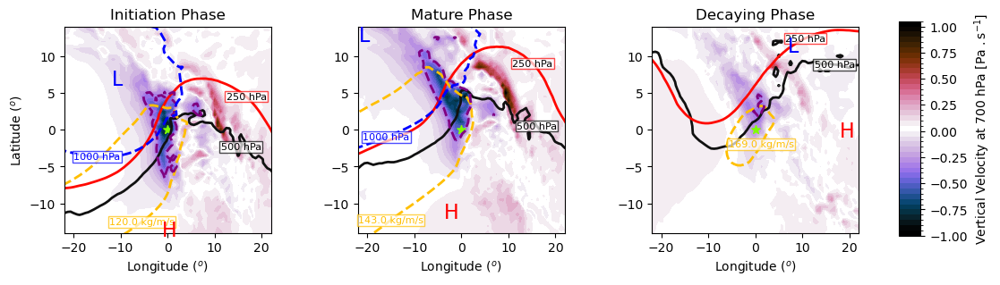

In [13]:
fig,axes = plt.subplots(ncols=3, figsize=(12,3))
cl_num = [2,0,1]
titles = ['Initiation Phase' , 'Mature Phase', 'Decaying Phase']
for ix,ax,(tx,tits) in zip(cl_num,axes.flat, enumerate(titles)):

    plot = OMEGA_data['OMEGA'].sel(lev=850, time = ix).plot.contourf(ax=ax, cmap=cmaps.emergency,vmin=-1,vmax=1,levels=np.arange(-1,1.1,0.05), add_colorbar=False) 
      
    
    ##############################################################################################################################
    #######################################  make contour plots for wave propagation at different levels  ########################################
    ##############################################################################################################################
    #EPV @ 500 hPa
    c1 = ax.contour(EPV_data['EPV']['lon'], EPV_data['EPV']['lat'], EPV_data['EPV'].sel(lev=500, time = ix), levels=[0], colors='#111111', linewidths=2)
    x,y= c1.get_paths()[0].vertices[120]#.mean(axis=0)   
    ax.text(x,y, '500 hPa',
            fontsize=8,
            ha='center',
            va='center',
           bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))
    
    #EPV @ 250 hPa
    c1 = ax.contour(EPV_data['EPV']['lon'], EPV_data['EPV']['lat'], EPV_data['EPV'].sel(lev=250, time = ix), levels=[0], colors='#FF0800', linewidths=2)
    x,y= c1.get_paths()[0].vertices[100]#.mean(axis=0)   
    ax.text(x,y, '250 hPa',
            fontsize=8,
            ha='center',
            va='center',
           bbox=dict(facecolor='white', edgecolor='red', alpha=0.7,pad=1))
    
    
    #IVT
    c1 = ax.contour(IVT_data['IVT']['lon'], IVT_data['IVT']['lat'], IVT_data['IVT'].sel( time = ix), levels=[0], linestyles = 'dashed',colors='#FFBF00', linewidths=2)
    try:  
        x,y= c1.get_paths()[0].vertices[15]#.mean(axis=0)   
        ax.text(x,y, f'{ivt_medians[ix]} kg/m/s',
                color='#FFBF00',
                fontsize=8,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='#FFBF00', alpha=0.7,pad=1))
    except:
        pass
    
    #OMEGA @ 850 hPa
    ax.contour(OMEGA_data['OMEGA']['lon'], OMEGA_data['OMEGA']['lat'], OMEGA_data['OMEGA'].sel(lev=850, time = ix), levels=[-0.35], linestyles = 'dashed', colors='purple', linewidths=2)
    
    c1 = ax.contour(SLP_data['SLP']['lon'], SLP_data['SLP']['lat'], SLP_data['SLP'].sel(time = ix), levels=[0], linestyles = 'dashed',colors='#0000FF', linewidths=2)
    try:  
        x,y= c1.get_paths()[0].vertices[-20]#.mean(axis=0)   
        ax.text(x,y, '1000 hPa',
                color='blue',
                fontsize=8,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='blue', alpha=0.7,pad=1))
    except:
        pass
    
    ######################################### SHOW THE SURFACE PRESSURE LOWS AND HIGHS ################################
    msl_data = SLP_data['SLP'].sel(time=ix).sel(lon=slice(-22,22),lat=slice(-14.5,14.5))
    mln, mlt = msl_data.argmin(dim=['lon','lat'])['lon'], msl_data.argmin(dim=['lon','lat'])['lat']    #obtain the lows positions 
    xln, xlt = msl_data.argmax(dim=['lon','lat'])['lon'],msl_data.argmax(dim=['lon','lat'])['lat']      #obtain the highs positions

    _text_data = msl_data.isel(lon=mln.values,lat=mlt.values)       #select the data for lows 
    _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the lows 
    if _x >= msl_data.lat.max().values - 0.5:
        _x = _x -2
    if _y >= msl_data.lat.max().values - 0.5:
        _y = _y - 2
    ax.text(_x,_y , 'L', fontdict={'size':16,'color':'blue'})

    _text_data = msl_data.isel(lon=xln.values,lat=xlt.values)       #select the data for highs 
    _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the highs 
    if _x >= msl_data.lon.max().values-0.5:
        _x = _x - 4
    if _y >= msl_data.lat.max().values-0.5:
        _y = _y - 1

    ax.text(_x,_y , 'H', fontdict={'size':16, 'color':'red'})
    ##############################################################################################################################
    ##############################################################################################################################
    ax.set_box_aspect(1)
    ax.set_ylim(-14,14)
    ax.set_xlim(-22,22)
    ax.set_title(tits)
    
    if tx == 0:
        ax.set_ylabel('Latitude ($^o$)')
    else:
        ax.set_ylabel('')
    
    ax.set_xlabel('Longitude ($^o$)')
    
    ax.scatter(0,0,marker='*', color='#80FF00', s=50)
    
cbar_ax = fig.add_axes([0.92, 0.1, 0.02, 0.8])  # [left, bottom, width, height]
cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5,label='Vertical Velocity at 700 hPa [Pa $.$s$^{-1}$]')
#plt.savefig('Images/AR_phases.png', dpi=300)

## CREATE LOOP FOR TIME LAGS

### USE THIS TO PREPROCESS THE DATA INTO THE AVERAGES AND LOAD FOR EASY PLOTTING 

In [8]:
import dask 
import dask.delayed
# Define a function to normalize each variable in the dataset
@dask.delayed
def normalize_variable(var, var_type):
    ''' 
    This function normalises an xarray dataset for values between -1 and 1. 
    
    Arguments
    --------------
    
    var : xarray dataset or data array
    
    Return
    ----------
    
    xarray normalised dataset
    
    '''
    if var_type == 'levels':
        
        min_val = var.min(dim=['lon','lat'])    #obtain min value
        #print(min_val.values)
        max_val = var.max(dim=['lon','lat'])   # obtain max value
    elif var_type == 'surface':
        min_val = var.min()    #obtain min value  dim=['longitude','laitude']
        #print(min_val.values)
        max_val = var.max()   # obtain max value
        
    normalized_var = 2 * (var - min_val) / (max_val - min_val) - 1    #compute normalisation
    
    return normalized_var

In [5]:
levs_2_plot = [850,700,500,300,250]

In [11]:

##################################################################################################
#                                                         Load data for lagged Kmeans dataset and store them                                                  #
##################################################################################################

algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']
variables =['epv','slp','ivt'] #['h','epv','omega','ivt','slp','tqv']
types = ['levels','surface','surface']
len_of_data = []
groups = np.arange(0,2)
lags = [2,4]#,6,12,18,24]
typ='surface'
for lg in lags:
    print(f'Loading and Normalising for lag{lg}')
    mpath=f'./MERRA2-lagged/lag_{lg}hrs/'
    for alx, alg in enumerate(algorithms):
        locals()[f'{alg}_merra'] = collections.defaultdict(list)
        print(f'{Color.PURPLE}{alg.upper()}{Color.END}')
        for typ, (vx,vb) in zip(types, enumerate(variables)):
            pths = glob.glob(f'{mpath}conus_ARS_DJF_lag_{alg}_{vb}_raw/*.nc',recursive=True)
            pths.sort()
            #ds = [xr.open_dataset(pt, chunks='auto') for pt in pths]
            #ds = xr.concat(ds,dim='time')
            ds = xr.open_mfdataset(pths, chunks='auto')
            print('Done loading data \nCalculating mean')

            with open(f'cluster_numbers/cluster_values_{alg}') as clusters:
                cluster = clusters.readlines()
                cluster = [int(x[0]) for x in cluster]
            print(len(cluster))

            ds['time'] = cluster

            print('Loading for groups')
            groups = ds.groupby('time').groups.keys()
            for gr in groups:
                if typ == 'levels':
                    dds = ds.sel(lev=levs_2_plot, time=gr).mean('time').load()
                elif typ == 'surface':
                    dds = ds.sel(time=gr).mean('time').load()

                #eval(f'{alg}_merra')[f'{vb}_c{gr}'] = dds   #.load()  #xr.open_mfdataset(pths, chunks='auto')
                sv_path = f'Averages/'


                print('Calculating normalisations')
                dds[f'norm_{vb.upper()}'] = normalize_variable(dds,var_type=typ).compute()[vb.upper()]

                sv_path=f'{mpath}Averages/'
                final_path = f'{sv_path}{alg}_cluster/'

                if os.path.isdir(sv_path) == False:
                    os.mkdir(sv_path)

                if os.path.isdir(final_path) == False:
                    os.mkdir(final_path)

                dds.to_netcdf(f'{final_path}{alg}_cluster{gr}_{vb}.nc')


            #print(len(pths))

            #if vx == 0 :
                #len_of_data.append(len(ds.time.values))

Loading and Normalising for lag2
CASCADE_BARD_V1
Done loading data 
Calculating mean
6524
Loading for groups
Calculating normalisations
Calculating normalisations
Done loading data 
Calculating mean
6524
Loading for groups
Calculating normalisations
Calculating normalisations
Done loading data 
Calculating mean
6524
Loading for groups
Calculating normalisations
Calculating normalisations
SCAFET
Done loading data 
Calculating mean
26310
Loading for groups
Calculating normalisations
Calculating normalisations
Done loading data 
Calculating mean
26310
Loading for groups
Calculating normalisations
Calculating normalisations
Done loading data 
Calculating mean
26310
Loading for groups
Calculating normalisations
Calculating normalisations
MUNDHENK_V3
Done loading data 
Calculating mean
16601
Loading for groups
Calculating normalisations
Calculating normalisations
Done loading data 
Calculating mean
16601
Loading for groups
Calculating normalisations
Calculating normalisations
Done loading da

In [10]:
ds

<xarray.Dataset>
Dimensions:  (lat: 61, lon: 81, time: 6324)
Coordinates:
  * lat      (lat) float64 -15.0 -14.5 -14.0 -13.5 -13.0 ... 13.5 14.0 14.5 15.0
  * lon      (lon) float64 -25.0 -24.38 -23.75 -23.12 ... 23.12 23.75 24.38 25.0
  * time     (time) datetime64[ns] 1980-01-01 ... 2016-01-04T15:00:00
Data variables:
    SLP      (time, lat, lon) float32 dask.array<chunksize=(369, 61, 81), meta=np.ndarray>

### LOAD DATASETS

In [51]:
%%time
algorithms = ['cascade_bard_v1','SCAFET','mundhenk_v3','lora_v2','reid250','connect500','gershunov','guan_waliser']
#algorithms=['SCAFET','mundhenk_v3','lora_v2','reid250','connect500','gershunov','guan_waliser']
variables =['epv','ivt','slp']#,'h','omega','slp','tqv','ivt']
groups = np.arange(0,2)
lags = [2,4,6,12,18,24]
for lg in lags:
    mpath=f'./MERRA2-lagged/lag_{lg}hrs/'
    for alx,alg in enumerate(algorithms):
        
        #locals()[f'{alg}_merra'] = collections.defaultdict(list)

        for vx,vb in enumerate(variables):

            for gr in groups:
                pths = glob.glob(f'{mpath}Averages/{alg}_cluster/*{gr}_{vb}*', recursive=True)

                if vb == 'tqv':
                    ds = xr.open_mfdataset(pths).sel(longitude=slice(-24,24),latitude=slice(-14,14))
                else:
                    ds = xr.open_mfdataset(pths).sel(lon=slice(-24,24),lat=slice(-14,14))
                eval(f'{alg}_merra')[f'{vb}lg_{lg}_{gr}'] = ds

CPU times: user 2.69 s, sys: 1.06 s, total: 3.75 s
Wall time: 4.21 s


In [566]:
 fmt = mtk.StrMethodFormatter("{x:1.0f} m")
            z_plot = eval(f'{alg}_merra')[f'h_{clust[0]}']
            z1 = z_plot['H'].sel(lev=500).plot.contour(ax=ax,
                                                    vmin=5000,vmax=6000, levels=np.arange(5000,6000,80),
                                              cmap='black',linestyles='dashed',linewidths=1)
            z1.clabel(fmt=fmt,inline = True,fontsize=8,rightside_up=True)

            z1 = z_plot['H'].sel(lev=850).plot.contour(ax=ax,
                                                    vmin=1000,vmax=2000, levels=np.arange(1000,2000,50),
                                              cmap='white',linestyles='solid',linewidths=1)
            z1.clabel(fmt=fmt,inline = True,fontsize=9,rightside_up=True)

    ######################################### SHOW THE SURFACE PRESSURE LOWS AND HIGHS ################################
            msl_data = eval(f'{alg}_merra')[f'slp_{clust[0]}']['SLP'].sel(lon=slice(-20,20), lat=slice(-10,10))
            mln, mlt = msl_data.argmin(dim=['lon','lat'])['lon'].values, msl_data.argmin(dim=['lon','lat'])['lat'].values    #obtain the lows positions 
            xln, xlt = msl_data.argmax(dim=['lon','lat'])['lon'].values,msl_data.argmax(dim=['lon','lat'])['lat'].values      #obtain the highs positions

            _text_data = msl_data.isel(lon=mln,lat=mlt)       #select the data for lows 
            _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the lows 
            if _x >= msl_data.lat.max().values - 0.5:
                _x = _x -2
            if _y >= msl_data.lat.max().values - 0.5:
                _y = _y - 2
            ax.text(_x,_y , 'L', fontdict={'size':18,'color':'cyan'})

            _text_data = msl_data.isel(lon=xln,lat=xlt)       #select the data for highs 
            _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the highs 
            if _x >= msl_data.lon.max().values-0.5:
                _x = _x - 4
            if _y >= msl_data.lat.max().values-0.5:
                _y = _y - 1

            ax.text(_x,_y , 'H', fontdict={'size':18, 'color':'red'})

            if ix%4 ==0:
                ax.set_ylabel('Latitude ($^o$)', fontsize=12)

            else:
                ax.set_ylabel('')
            ax.set_xlabel('Longitude ($^o$)', fontsize=12)


array([[    0,  3060],
       [    1,  9741],
       [    1,  6914],
       [    0,  5426],
       [    0,  7076],
       [    1,  1223],
       [    1,  7433],
       [    0, 36191]])

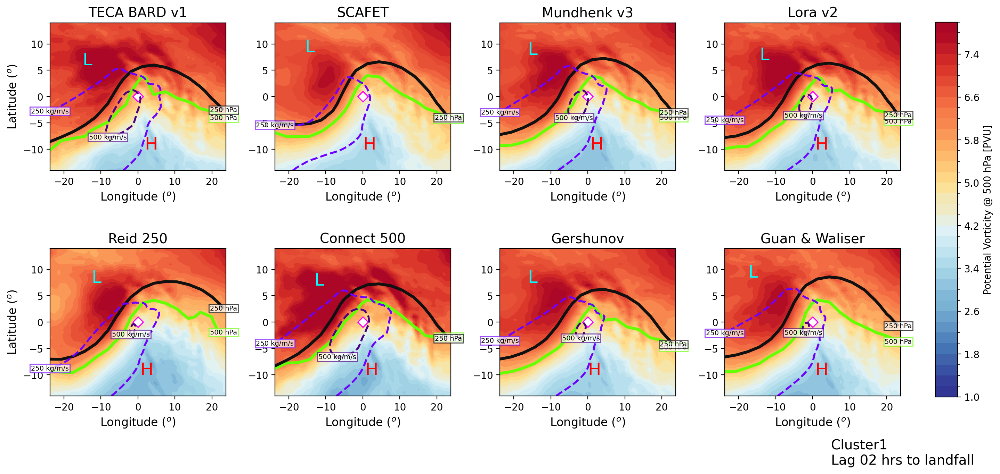

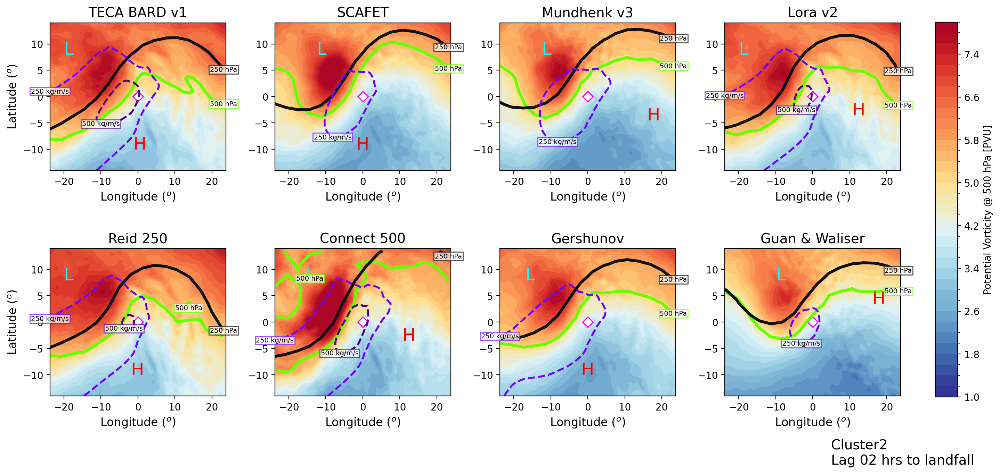

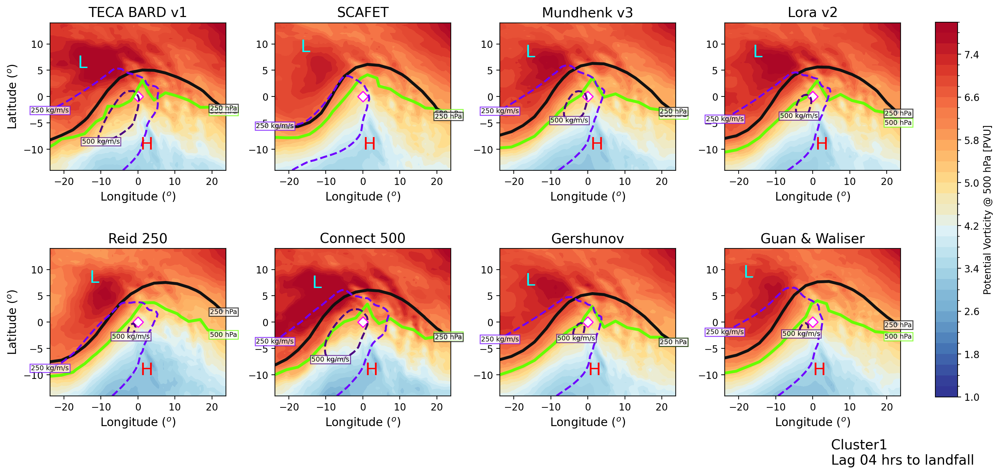

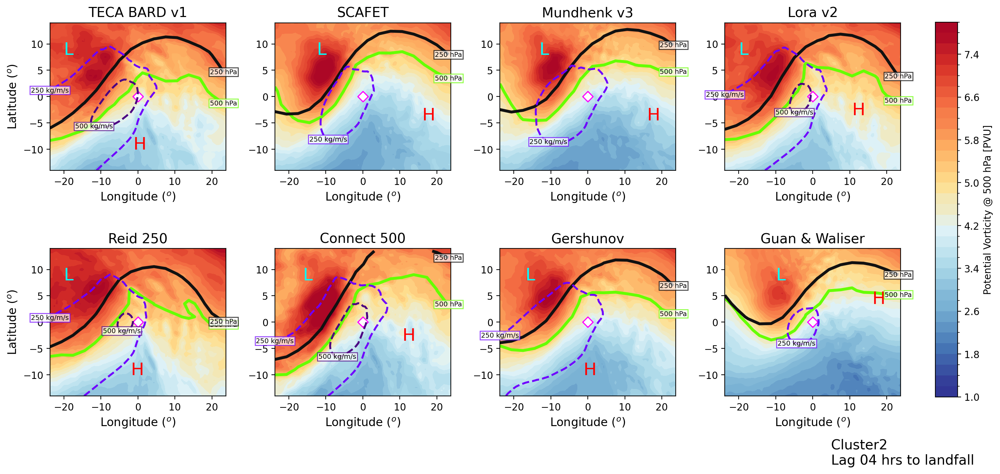

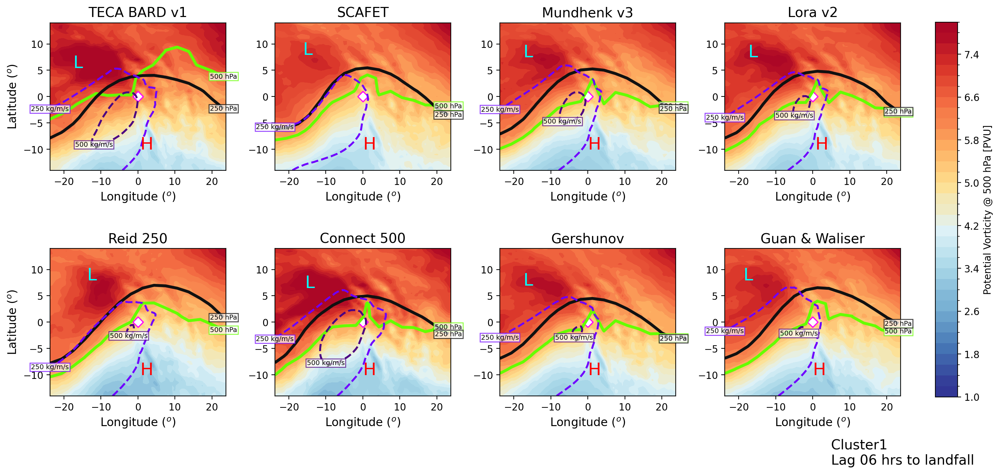

...

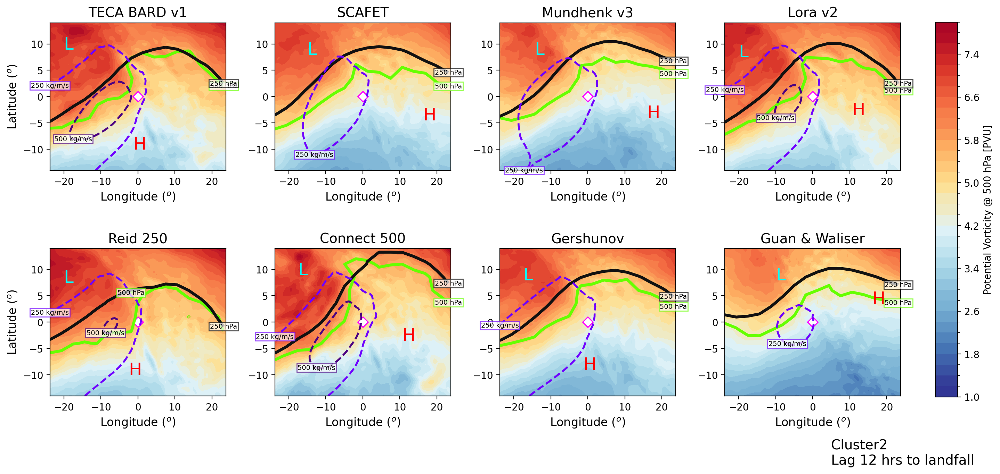

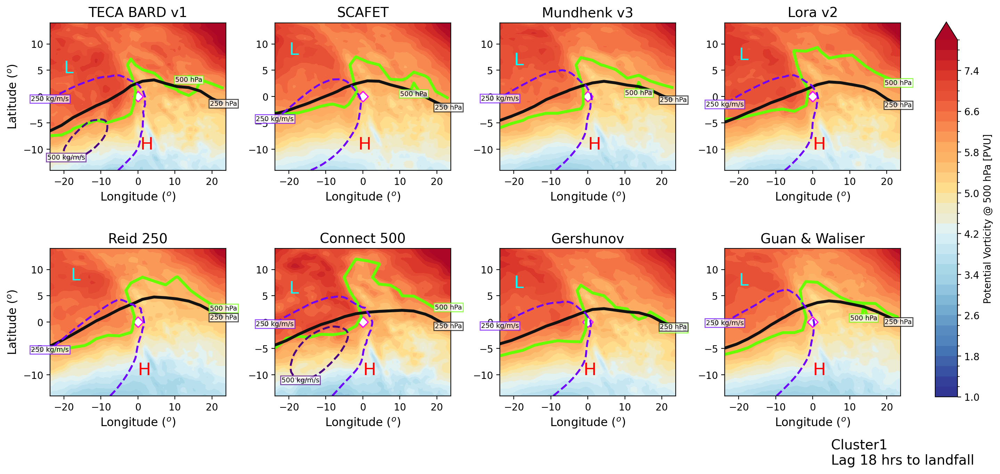

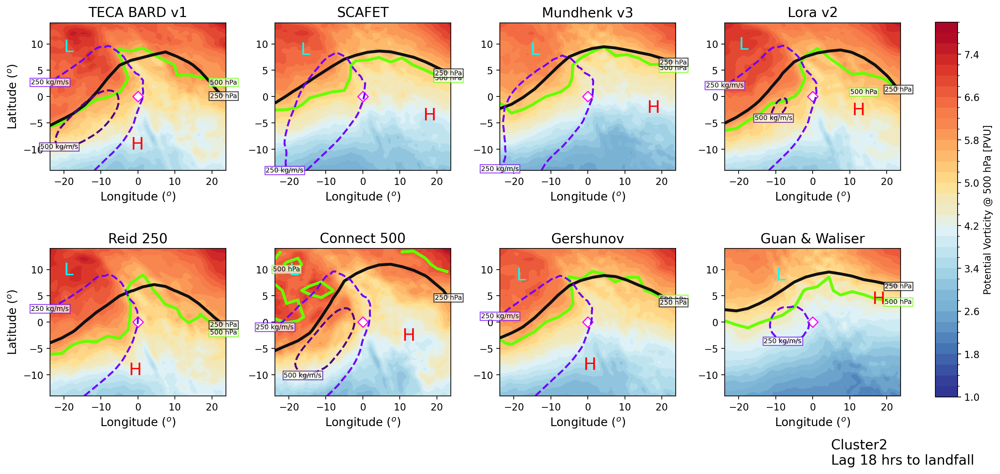

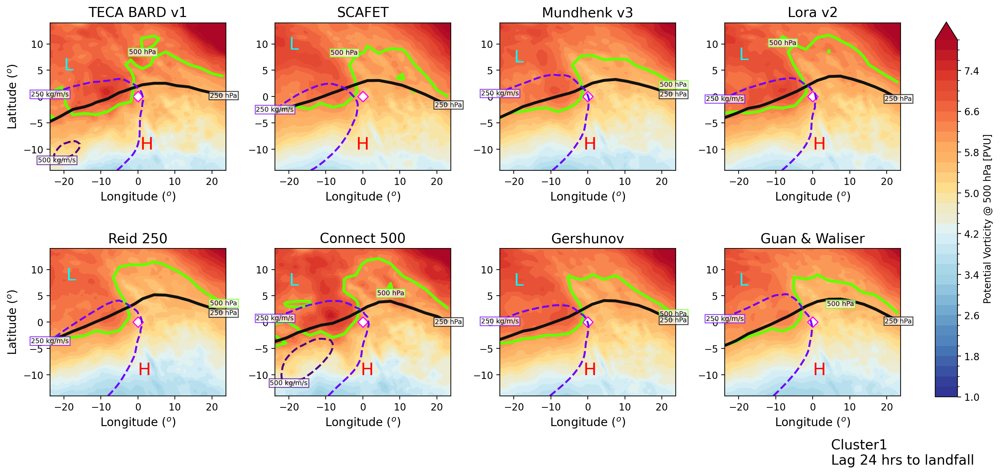

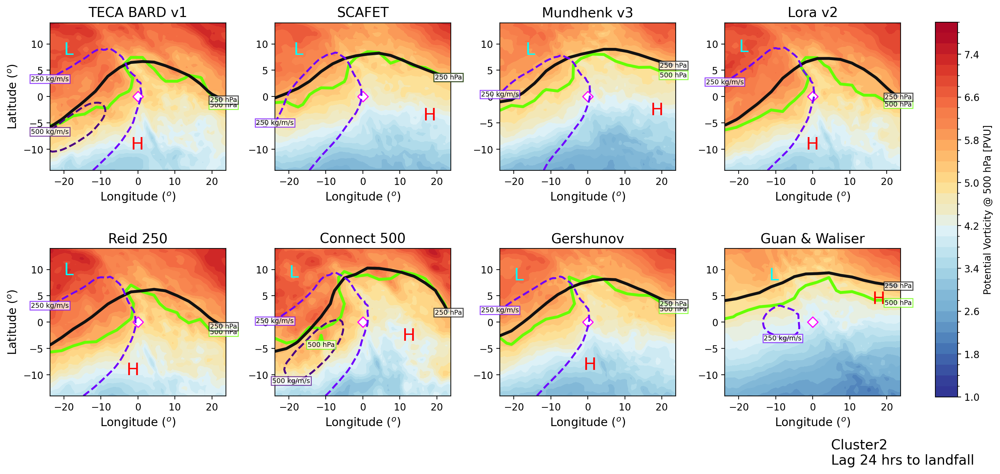

In [56]:
for lg in lags:
    
    for gr in groups:
    
        clus_2_plot = eval(f'cluster{gr+1}_len')
        fig, axes = plt.subplots(ncols=4,nrows = 2, figsize=(16,9))
        plt.tight_layout(pad=12,h_pad=6,w_pad=2)

        for (ix,alg),ax,clust  in zip(enumerate(algorithms),axes.flat,clus_2_plot):
            d2plot = eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}'].sel(lev=500)/1e-7
            #d2plot = eval(f'{alg}_merra')[f'epv_{clust[0]}'].sel(lev=500)/1e-7

            levs=np.arange(1,8.1,0.2)   # Adjust the number of levels as needed
            #norm = plt.Normalize(levels.min(), levels.max())

            plot=d2plot['EPV'].plot.contourf(ax=ax, levels=levs, cmap=cmaps.cmp_b2r,add_colorbar=False)

            
            ######################################### SHOW THE SURFACE PRESSURE LOWS AND HIGHS ################################
            msl_data = eval(f'{alg}_merra')[f'slplg_{lg}_{clust[0]}']['SLP'].sel(lon=slice(-20,20), lat=slice(-10,10))
            mln, mlt = msl_data.argmin(dim=['lon','lat'])['lon'].values, msl_data.argmin(dim=['lon','lat'])['lat'].values    #obtain the lows positions 
            xln, xlt = msl_data.argmax(dim=['lon','lat'])['lon'].values,msl_data.argmax(dim=['lon','lat'])['lat'].values      #obtain the highs positions

            _text_data = msl_data.isel(lon=mln,lat=mlt)       #select the data for lows 
            _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the lows 
            if _x >= msl_data.lat.max().values - 0.5:
                _x = _x -2
            if _y >= msl_data.lat.max().values - 0.5:
                _y = _y - 2
            ax.text(_x,_y , 'L', fontdict={'size':18,'color':'cyan'})

            _text_data = msl_data.isel(lon=xln,lat=xlt)       #select the data for highs 
            _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the highs 
            if _x >= msl_data.lon.max().values-0.5:
                _x = _x - 4
            if _y >= msl_data.lat.max().values-0.5:
                _y = _y - 1

            ax.text(_x,_y , 'H', fontdict={'size':18, 'color':'red'})

            if ix%4 ==0:
                ax.set_ylabel('Latitude ($^o$)', fontsize=12)

            else:
                ax.set_ylabel('')
            ax.set_xlabel('Longitude ($^o$)', fontsize=12)

            ##############################################################################################################################
            #######################################  make contour plots for wave propagation at different levels  ########################################
            ##############################################################################################################################
            #EPV @ 500 hPa
            #eval(f'{alg}_merra')['h']['norm_H'].sel(lev=500).plot(ax=ax)
            c1 = ax.contour(eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}']['norm_EPV'].sel(lev=500).values[::5,::5], levels=[0], colors='#66FF00', linewidths=3)
            x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
            ax.text(x,y, '500 hPa',
                    fontsize=7,
                    ha='center',
                    va='center',
                   bbox=dict(facecolor='white', edgecolor='#66FF00', alpha=0.7,pad=1))

            #EPV @ 250 hPa
            c1 = ax.contour(eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}']['norm_EPV'].sel(lev=250).values[::5,::5], levels=[0], colors='#111111', linewidths=3)
            x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
            ax.text(x,y, '250 hPa',
                    fontsize=7,
                    ha='center',
                    va='center',
                   bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))

            try:
                #IVT CONTOUR 250kg/m/s
                d2plot = eval(f'{alg}_merra')[f'ivtlg_{lg}_{clust[0]}']['IVT']
                c1= ax.contour(d2plot['lon'], d2plot['lat'], d2plot, levels=[250], colors='#6F00FF', linestyles='dashed',linewidths=2)
                x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
                ax.text(x,y, '250 kg/m/s',
                        fontsize=7,
                        ha='center',
                        va='center',
                       bbox=dict(facecolor='white', edgecolor='#6F00FF', alpha=0.7,pad=1))
                #IVT CONTOUR 500kg/m/s
                c1 = ax.contour(d2plot['lon'], d2plot['lat'], d2plot, levels=[500], colors='#4B0082', linestyles='dashed',linewidths=2)
                x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
                ax.text(x,y, '500 kg/m/s',
                        fontsize=7,
                        ha='center',
                        va='center',
                       bbox=dict(facecolor='white', edgecolor='#4B0082', alpha=0.7,pad=1))
            except:
                pass

            ax.set_title(f'{alg_names[ix]}',fontsize=14)
            ax.scatter(0,0,color='#FF00FF', marker='D', s=60)
            ax.scatter(0,0,color='white', marker='D', s=30)
            
        cbar_ax = fig.add_axes([0.92, 0.21, 0.02, 0.6])  # [left, bottom, width, height]
        cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5,label='Potential Vorticity @ 500 hPa [PVU]')
        ax.text(5, -27, f'Cluster{gr+1} \nLag {str(lg).zfill(2)} hrs to landfall', fontsize=14,fontname='sans-serif')
        
        plt.savefig(f'laggedimages/{str(lg).zfill(2)}hrs_{gr}.png', dpi=300)


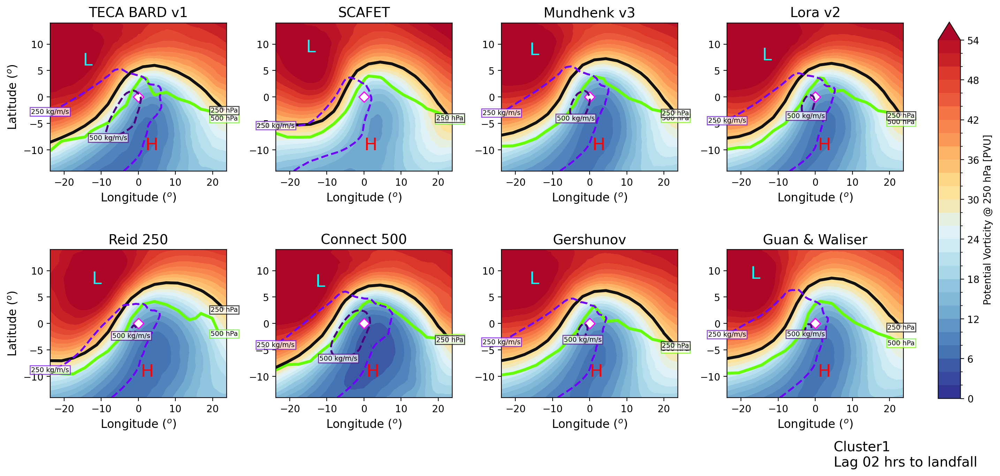

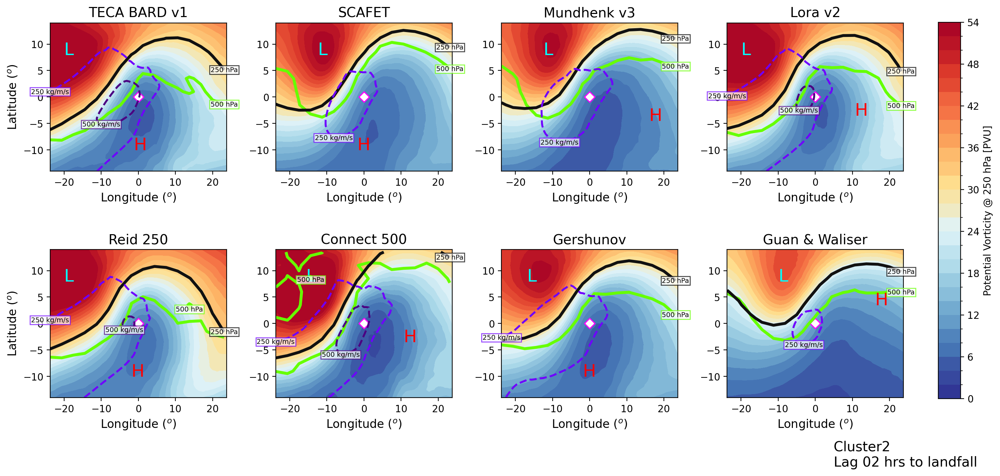

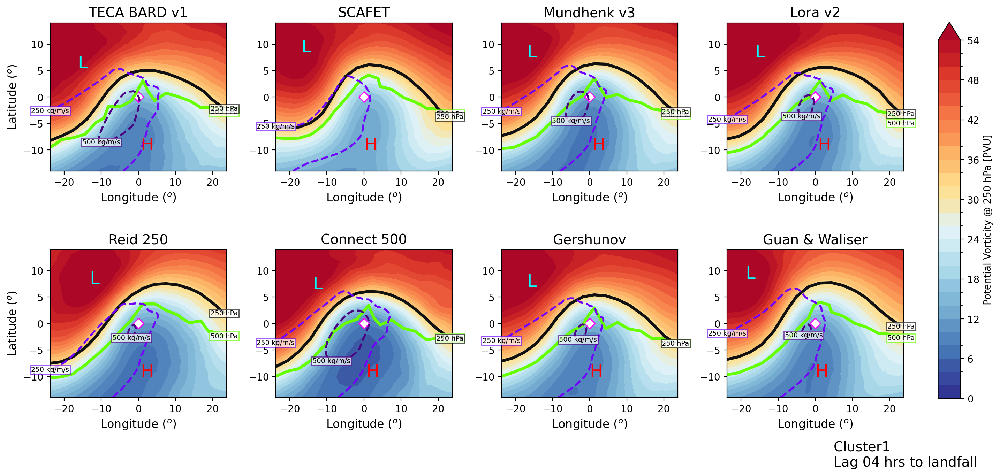

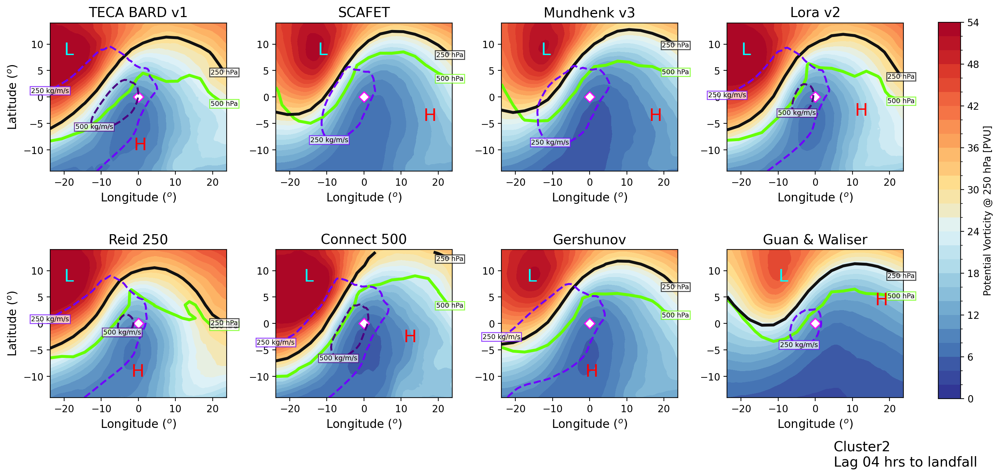

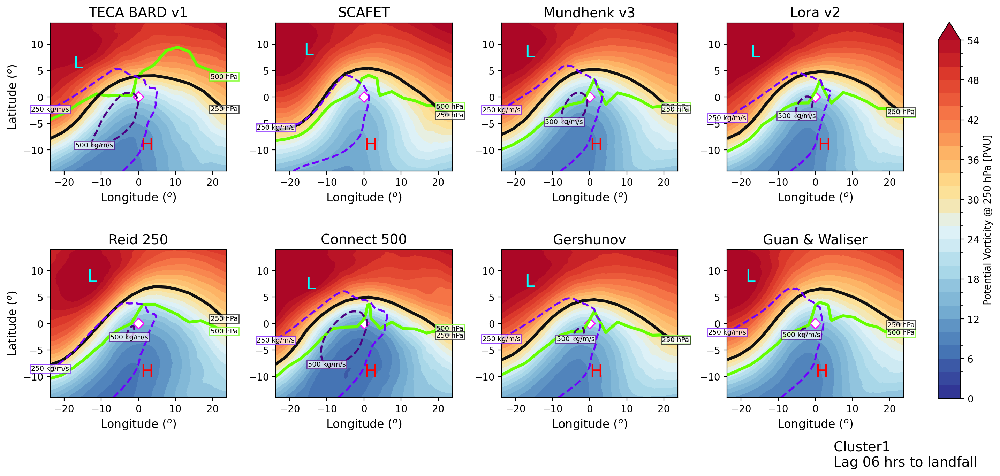

...

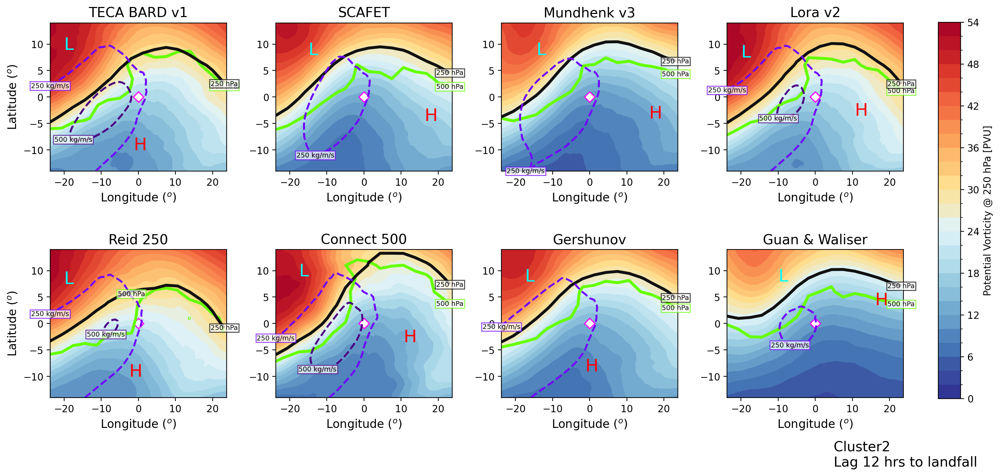

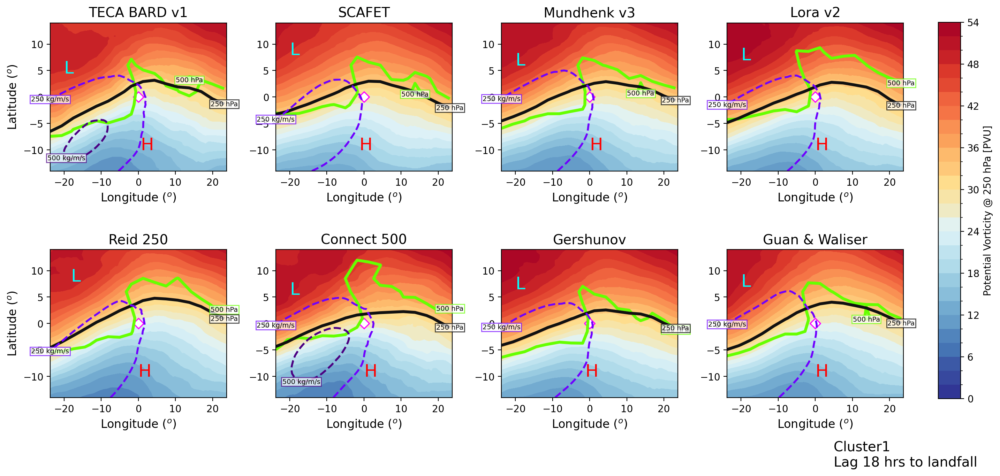

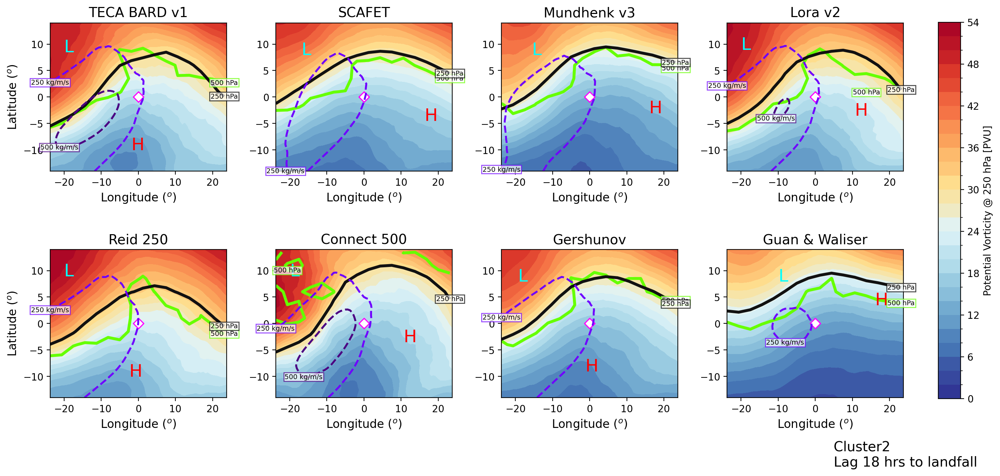

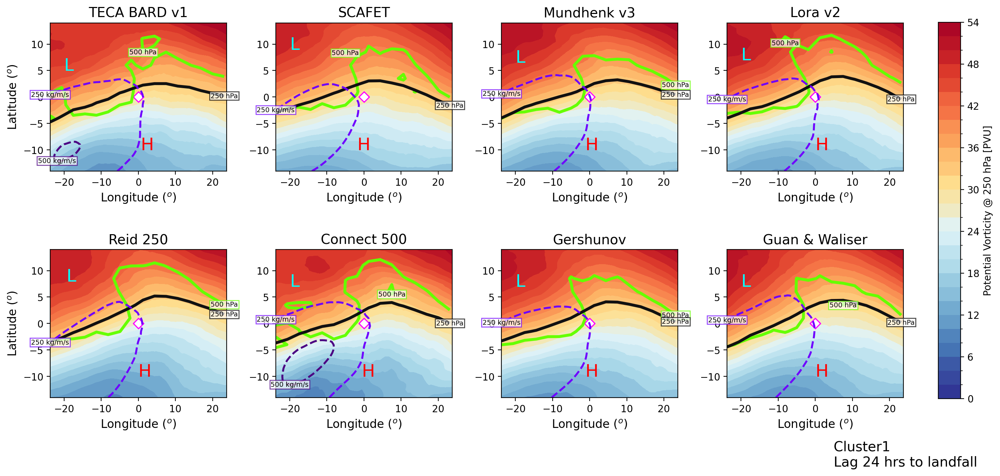

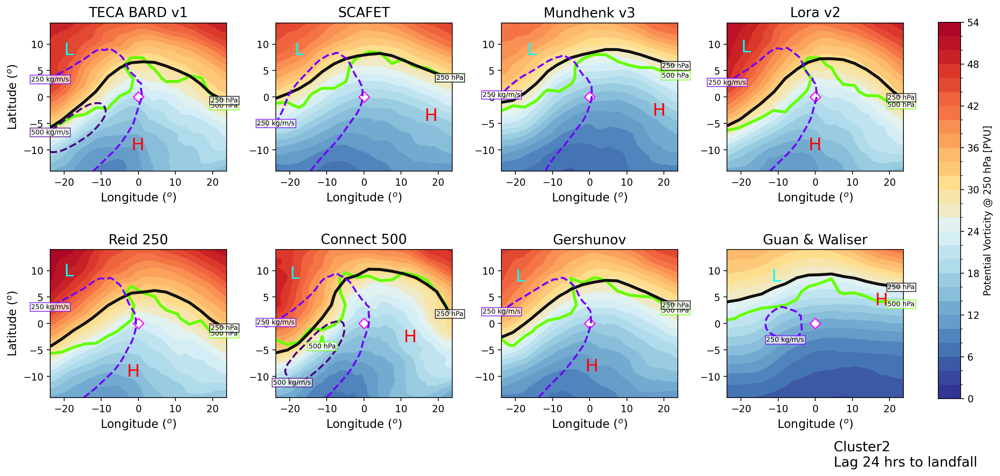

In [57]:
for lg in lags:
    
    for gr in groups:
    
        clus_2_plot = eval(f'cluster{gr+1}_len')
        fig, axes = plt.subplots(ncols=4,nrows = 2, figsize=(16,9))
        plt.tight_layout(pad=12,h_pad=6,w_pad=2)

        for (ix,alg),ax,clust  in zip(enumerate(algorithms),axes.flat,clus_2_plot):
            d2plot = eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}'].sel(lev=250)/1e-7
            #d2plot = eval(f'{alg}_merra')[f'epv_{clust[0]}'].sel(lev=500)/1e-7

            levs=np.arange(0,56,2)  # Adjust the number of levels as needed
            #norm = plt.Normalize(levels.min(), levels.max())

            plot=d2plot['EPV'].plot.contourf(ax=ax, levels=levs, cmap=cmaps.cmp_b2r,add_colorbar=False)

            
            ######################################### SHOW THE SURFACE PRESSURE LOWS AND HIGHS ################################
            msl_data = eval(f'{alg}_merra')[f'slplg_{lg}_{clust[0]}']['SLP'].sel(lon=slice(-20,20), lat=slice(-10,10))
            mln, mlt = msl_data.argmin(dim=['lon','lat'])['lon'].values, msl_data.argmin(dim=['lon','lat'])['lat'].values    #obtain the lows positions 
            xln, xlt = msl_data.argmax(dim=['lon','lat'])['lon'].values,msl_data.argmax(dim=['lon','lat'])['lat'].values      #obtain the highs positions

            _text_data = msl_data.isel(lon=mln,lat=mlt)       #select the data for lows 
            _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the lows 
            if _x >= msl_data.lat.max().values - 0.5:
                _x = _x -2
            if _y >= msl_data.lat.max().values - 0.5:
                _y = _y - 2
            ax.text(_x,_y , 'L', fontdict={'size':18,'color':'cyan'})

            _text_data = msl_data.isel(lon=xln,lat=xlt)       #select the data for highs 
            _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the highs 
            if _x >= msl_data.lon.max().values-0.5:
                _x = _x - 4
            if _y >= msl_data.lat.max().values-0.5:
                _y = _y - 1

            ax.text(_x,_y , 'H', fontdict={'size':18, 'color':'red'})

            if ix%4 ==0:
                ax.set_ylabel('Latitude ($^o$)', fontsize=12)

            else:
                ax.set_ylabel('')
            ax.set_xlabel('Longitude ($^o$)', fontsize=12)

            ##############################################################################################################################
            #######################################  make contour plots for wave propagation at different levels  ########################################
            ##############################################################################################################################
            #EPV @ 500 hPa
            #eval(f'{alg}_merra')['h']['norm_H'].sel(lev=500).plot(ax=ax)
            c1 = ax.contour(eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}']['norm_EPV'].sel(lev=500).values[::5,::5], levels=[0], colors='#66FF00', linewidths=3)
            x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
            ax.text(x,y, '500 hPa',
                    fontsize=7,
                    ha='center',
                    va='center',
                   bbox=dict(facecolor='white', edgecolor='#66FF00', alpha=0.7,pad=1))

            #EPV @ 250 hPa
            c1 = ax.contour(eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}']['norm_EPV'].sel(lev=250).values[::5,::5], levels=[0], colors='#111111', linewidths=3)
            x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
            ax.text(x,y, '250 hPa',
                    fontsize=7,
                    ha='center',
                    va='center',
                   bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))

            try:
                #IVT CONTOUR 250kg/m/s
                d2plot = eval(f'{alg}_merra')[f'ivtlg_{lg}_{clust[0]}']['IVT']
                c1= ax.contour(d2plot['lon'], d2plot['lat'], d2plot, levels=[250], colors='#6F00FF', linestyles='dashed',linewidths=2)
                x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
                ax.text(x,y, '250 kg/m/s',
                        fontsize=7,
                        ha='center',
                        va='center',
                       bbox=dict(facecolor='white', edgecolor='#6F00FF', alpha=0.7,pad=1))
                #IVT CONTOUR 500kg/m/s
                c1 = ax.contour(d2plot['lon'], d2plot['lat'], d2plot, levels=[500], colors='#4B0082', linestyles='dashed',linewidths=2)
                x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
                ax.text(x,y, '500 kg/m/s',
                        fontsize=7,
                        ha='center',
                        va='center',
                       bbox=dict(facecolor='white', edgecolor='#4B0082', alpha=0.7,pad=1))
            except:
                pass

            ax.set_title(f'{alg_names[ix]}',fontsize=14)
            ax.scatter(0,0,color='#FF00FF', marker='D', s=60)
            ax.scatter(0,0,color='white', marker='D', s=30)
        
        cbar_ax = fig.add_axes([0.92, 0.21, 0.02, 0.6])  # [left, bottom, width, height]
        cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5,label='Potential Vorticity @ 250 hPa [PVU]')
        ax.text(5, -27, f'Cluster{gr+1} \nLag {str(lg).zfill(2)} hrs to landfall', fontsize=14,fontname='sans-serif')# fontname='sans-serif')
        
        plt.savefig(f'laggedimages/{str(lg).zfill(2)}hrs_{gr}_upper.png', dpi=300)


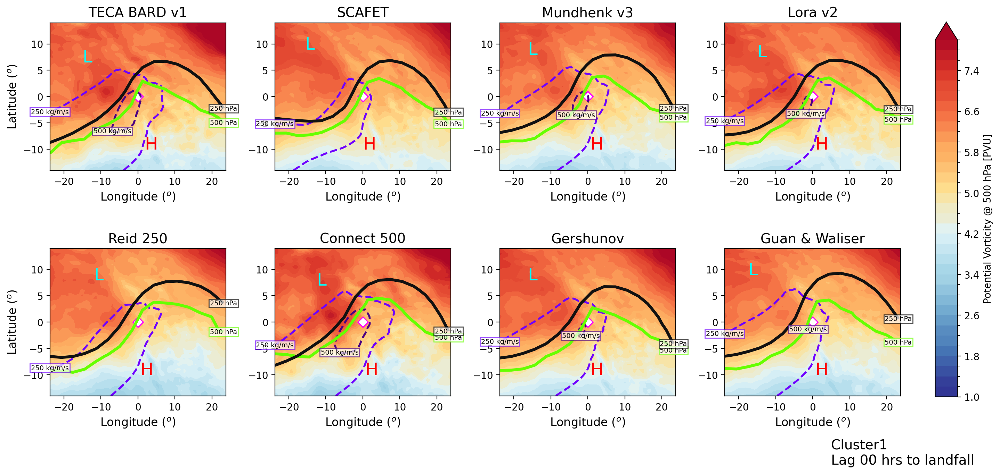

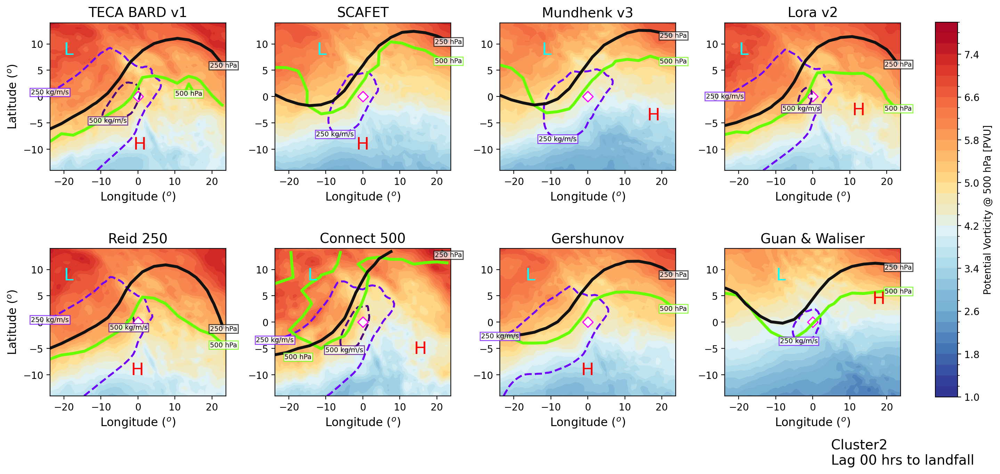

In [58]:
vbls = ['epv','h']
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']

for nx in range(2):
    
    clus_2_plot = eval(f'cluster{nx+1}_len')
    fig, axes = plt.subplots(ncols=4,nrows = 2, figsize=(16,9))
    plt.tight_layout(pad=12,h_pad=6,w_pad=2)
    
    for (ix,alg),ax,clust  in zip(enumerate(algorithms),axes.flat,clus_2_plot):
        
        d2plot = eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}'].sel(lev=500)/1e-7
        #d2plot = eval(f'{alg}_merra')[f'epv_{clust[0]}'].sel(lev=500)/1e-7

        levs=np.arange(1,8.1,0.2)  # Adjust the number of levels as needed
        #norm = plt.Normalize(levels.min(), levels.max())

        plot=d2plot['EPV'].plot.contourf(ax=ax, levels=levs, cmap=cmaps.cmp_b2r,add_colorbar=False)

        
        ######################################### SHOW THE SURFACE PRESSURE LOWS AND HIGHS ################################
        msl_data = eval(f'{alg}_merra')[f'slp_{clust[0]}']['SLP'].sel(lon=slice(-20,20), lat=slice(-10,10))
        mln, mlt = msl_data.argmin(dim=['lon','lat'])['lon'].values, msl_data.argmin(dim=['lon','lat'])['lat'].values    #obtain the lows positions 
        xln, xlt = msl_data.argmax(dim=['lon','lat'])['lon'].values,msl_data.argmax(dim=['lon','lat'])['lat'].values      #obtain the highs positions

        _text_data = msl_data.isel(lon=mln,lat=mlt)       #select the data for lows 
        _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the lows 
        if _x >= msl_data.lat.max().values - 0.5:
            _x = _x -2
        if _y >= msl_data.lat.max().values - 0.5:
            _y = _y - 2
        ax.text(_x,_y , 'L', fontdict={'size':18,'color':'cyan'})

        _text_data = msl_data.isel(lon=xln,lat=xlt)       #select the data for highs 
        _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the highs 
        if _x >= msl_data.lon.max().values-0.5:
            _x = _x - 4
        if _y >= msl_data.lat.max().values-0.5:
            _y = _y - 1

        ax.text(_x,_y , 'H', fontdict={'size':18, 'color':'red'})

        if ix%4 ==0:
            ax.set_ylabel('Latitude ($^o$)', fontsize=12)

        else:
            ax.set_ylabel('')
        ax.set_xlabel('Longitude ($^o$)', fontsize=12)

        try:
            
            #IVT CONTOUR 250kg/m/s
            d2plot = eval(f'{alg}_merra')[f'ivt_{clust[0]}']['IVT']
            c1= ax.contour(d2plot['lon'], d2plot['lat'], d2plot, levels=[250], colors='#6F00FF', linestyles='dashed',linewidths=2)
            x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
            ax.text(x,y, '250 kg/m/s',
                    fontsize=7,
                    ha='center',
                    va='center',
                   bbox=dict(facecolor='white', edgecolor='#6F00FF', alpha=0.7,pad=1))
            #IVT CONTOUR 500kg/m/s
            c1 = ax.contour(d2plot['lon'], d2plot['lat'], d2plot, levels=[500], colors='#4B0082', linestyles='dashed',linewidths=2)
            x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
            ax.text(x,y, '500 kg/m/s',
                    fontsize=7,
                    ha='center',
                    va='center',
                   bbox=dict(facecolor='white', edgecolor='#4B0082', alpha=0.7,pad=1))
        except:
            pass

        ##############################################################################################################################
        #######################################  make contour plots for wave propagation at different levels  ########################################
        ##############################################################################################################################
        #EPV @ 500 hPa
        #eval(f'{alg}_merra')['h']['norm_H'].sel(lev=500).plot(ax=ax)
        c1 = ax.contour(eval(f'{alg}_merra')[f'epv_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['norm_EPV'].sel(lev=500).values[::5,::5], levels=[0], colors='#66FF00', linewidths=3)
        x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
        ax.text(x,y, '500 hPa',
                fontsize=7,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='#66FF00', alpha=0.7,pad=1))

        #EPV @ 250 hPa
        c1 = ax.contour(eval(f'{alg}_merra')[f'epv_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['norm_EPV'].sel(lev=250).values[::5,::5], levels=[0], colors='#111111', linewidths=3)
        x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
        ax.text(x,y, '250 hPa',
                fontsize=7,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))


        ax.set_title(f'{alg_names[ix]}',fontsize=14)
        ax.scatter(0,0,color='#FF00FF', marker='D', s=60)
        ax.scatter(0,0,color='white', marker='D', s=30)
        
    cbar_ax = fig.add_axes([0.92, 0.21, 0.02, 0.6])  # [left, bottom, width, height]
    cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5,label='Potential Vorticity @ 500 hPa [PVU]')
    ax.text(5, -27, f'Cluster{nx+1} \nLag 00 hrs to landfall', fontsize=14,fontname='sans-serif')
    
    
    plt.savefig(f'laggedimages/00hrs_{nx}.png', dpi=300)

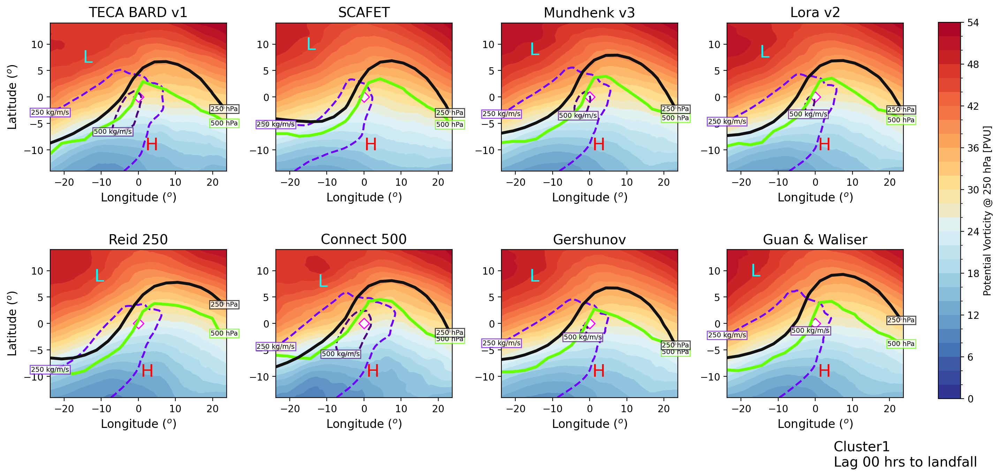

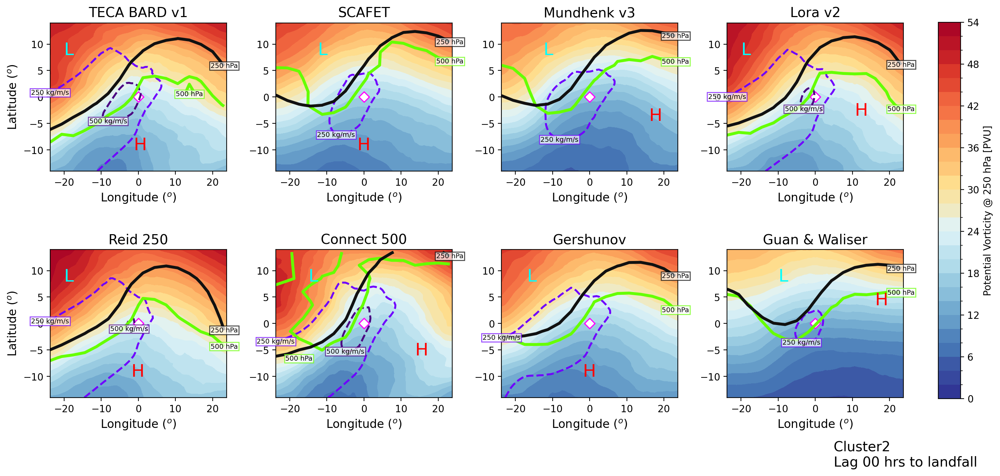

In [59]:
vbls = ['epv','h']
algorithms = ['cascade_bard_v1', 'SCAFET', 'mundhenk_v3', 'lora_v2', 'reid250','connect500', 'gershunov', 'guan_waliser']
alg_names = ['TECA BARD v1','SCAFET', 'Mundhenk v3','Lora v2', 'Reid 250', 'Connect 500', 'Gershunov','Guan & Waliser']

for nx in range(2):
    
    clus_2_plot = eval(f'cluster{nx+1}_len')
    fig, axes = plt.subplots(ncols=4,nrows = 2, figsize=(16,9))
    plt.tight_layout(pad=12,h_pad=6,w_pad=2)
    
    for (ix,alg),ax,clust  in zip(enumerate(algorithms),axes.flat,clus_2_plot):
        
        d2plot = eval(f'{alg}_merra')[f'epvlg_{lg}_{clust[0]}'].sel(lev=250)/1e-7
        #d2plot = eval(f'{alg}_merra')[f'epv_{clust[0]}'].sel(lev=500)/1e-7

        levs=np.arange(0,56,2)  # Adjust the number of levels as needed
        #norm = plt.Normalize(levels.min(), levels.max())

        plot=d2plot['EPV'].plot.contourf(ax=ax, levels=levs, cmap=cmaps.cmp_b2r,add_colorbar=False)

        
        ######################################### SHOW THE SURFACE PRESSURE LOWS AND HIGHS ################################
        msl_data = eval(f'{alg}_merra')[f'slp_{clust[0]}']['SLP'].sel(lon=slice(-20,20), lat=slice(-10,10))
        mln, mlt = msl_data.argmin(dim=['lon','lat'])['lon'].values, msl_data.argmin(dim=['lon','lat'])['lat'].values    #obtain the lows positions 
        xln, xlt = msl_data.argmax(dim=['lon','lat'])['lon'].values,msl_data.argmax(dim=['lon','lat'])['lat'].values      #obtain the highs positions

        _text_data = msl_data.isel(lon=mln,lat=mlt)       #select the data for lows 
        _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the lows 
        if _x >= msl_data.lat.max().values - 0.5:
            _x = _x -2
        if _y >= msl_data.lat.max().values - 0.5:
            _y = _y - 2
        ax.text(_x,_y , 'L', fontdict={'size':18,'color':'cyan'})

        _text_data = msl_data.isel(lon=xln,lat=xlt)       #select the data for highs 
        _x, _y = _text_data.lon.values, _text_data.lat.values    #obtain the exact lon, lats for the highs 
        if _x >= msl_data.lon.max().values-0.5:
            _x = _x - 4
        if _y >= msl_data.lat.max().values-0.5:
            _y = _y - 1

        ax.text(_x,_y , 'H', fontdict={'size':18, 'color':'red'})

        if ix%4 ==0:
            ax.set_ylabel('Latitude ($^o$)', fontsize=12)

        else:
            ax.set_ylabel('')
        ax.set_xlabel('Longitude ($^o$)', fontsize=12)

        try:
            
            #IVT CONTOUR 250kg/m/s
            d2plot = eval(f'{alg}_merra')[f'ivt_{clust[0]}']['IVT']
            c1= ax.contour(d2plot['lon'], d2plot['lat'], d2plot, levels=[250], colors='#6F00FF', linestyles='dashed',linewidths=2)
            x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
            ax.text(x,y, '250 kg/m/s',
                    fontsize=7,
                    ha='center',
                    va='center',
                   bbox=dict(facecolor='white', edgecolor='#6F00FF', alpha=0.7,pad=1))
            #IVT CONTOUR 500kg/m/s
            c1 = ax.contour(d2plot['lon'], d2plot['lat'], d2plot, levels=[500], colors='#4B0082', linestyles='dashed',linewidths=2)
            x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
            ax.text(x,y, '500 kg/m/s',
                    fontsize=7,
                    ha='center',
                    va='center',
                   bbox=dict(facecolor='white', edgecolor='#4B0082', alpha=0.7,pad=1))
        except:
            pass

        ##############################################################################################################################
        #######################################  make contour plots for wave propagation at different levels  ########################################
        ##############################################################################################################################
        #EPV @ 500 hPa
        #eval(f'{alg}_merra')['h']['norm_H'].sel(lev=500).plot(ax=ax)
        c1 = ax.contour(eval(f'{alg}_merra')[f'epv_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['norm_EPV'].sel(lev=500).values[::5,::5], levels=[0], colors='#66FF00', linewidths=3)
        x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
        ax.text(x,y, '500 hPa',
                fontsize=7,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='#66FF00', alpha=0.7,pad=1))

        #EPV @ 250 hPa
        c1 = ax.contour(eval(f'{alg}_merra')[f'epv_{clust[0]}']['lon'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['lat'].values[::5], eval(f'{alg}_merra')[f'epv_{clust[0]}']['norm_EPV'].sel(lev=250).values[::5,::5], levels=[0], colors='#111111', linewidths=3)
        x,y= c1.get_paths()[0].vertices[-1]#.mean(axis=0)   
        ax.text(x,y, '250 hPa',
                fontsize=7,
                ha='center',
                va='center',
               bbox=dict(facecolor='white', edgecolor='black', alpha=0.7,pad=1))


        ax.set_title(f'{alg_names[ix]}',fontsize=14)
        ax.scatter(0,0,color='#FF00FF', marker='D', s=60)
        ax.scatter(0,0,color='white', marker='D', s=30)
        
    cbar_ax = fig.add_axes([0.92, 0.21, 0.02, 0.6])  # [left, bottom, width, height]
    cbar = fig.colorbar(plot, cax=cbar_ax,shrink=0.5,label='Potential Vorticity @ 250 hPa [PVU]')
    ax.text(5, -27, f'Cluster{nx+1} \nLag 00 hrs to landfall', fontsize=14,fontname='sans-serif')
    
    plt.savefig(f'laggedimages/00hrs_{nx}_upper.png', dpi=300)

In [697]:
from PIL import Image
import imageio
import os

def create_gif(image_folder,clus_num, output_gif, duration=30):
    # Get the list of image files in the folder
    #images = [os.path.join(image_folder, img) for img in os.listdir(image_folder) if img.endswith('.png') or img.endswith('.jpg')]
    
    images = glob.glob(f'{image_folder}/*_{clus_num}.png',recursive=True)
    print(images)
    # Sort the images to maintain order
    images.sort()
    images = images[::-1]
    print(images)
    
    # Create GIF using imageio
    with imageio.get_writer(f'{image_folder}/{output_gif}', mode='I', duration=duration) as writer:
        for img_path in images:
            image = Image.open(img_path)
            writer.append_data(image)




In [25]:
from moviepy.editor import ImageSequenceClip
import cv2

In [715]:
def create_gif(image_folder,clus_num, output_mp4, fps=24):
    # Get the list of image files in the folder
    #images = [os.path.join(image_folder, img) for img in os.listdir(image_folder) if img.endswith('.png') or img.endswith('.jpg')]
    
    images = glob.glob(f'{image_folder}/*_{clus_num}*r.png',recursive=True)
    print(images)
    # Sort the images to maintain order
    images.sort()
    images = images[::-1]
    print(images)
    
    # Create MP4 video using ImageSequenceClip
    clip = ImageSequenceClip(images,fps=1,durations=300)
    #clip = clip.set_loop(duration=None)  # Loop indefinitely
    clip.write_videofile(f'{image_folder}/{output_mp4}')

In [29]:
def create_mp4(image_folder,clus_num, output_mp4, fps=1):
    # Get the list of image files in the folder
    #images = [os.path.join(image_folder, img) for img in os.listdir(image_folder) if img.endswith('.png') or img.endswith('.jpg')]
    images = glob.glob(f'{image_folder}/*_{clus_num}*r.png',recursive=True)
    # Sort the images to maintain order
    images.sort()
    images = images[::-1]
    print(images)
    # Read the first image to get dimensions
    img = cv2.imread(images[0])
    height, width, _ = img.shape
    
    # Create video writer
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Specify codec (for mp4 format)
    out = cv2.VideoWriter(output_mp4, fourcc, fps, (width, height))
    
    # Write each frame to the video
    for img_path in images:
        img = cv2.imread(img_path)
        out.write(img)
    
    # Release the video writer
    out.release()

In [31]:
if __name__ == "__main__":
    # Set the folder containing image files and output GIF file
    image_folder = 'laggedimages'
    clus_num = 0
    output_gif = f'{image_folder}/cluster{clus_num+1}_upper.mp4'
    
    # Create the GIF
    create_mp4(image_folder, clus_num, output_gif)
    print(f"Successfully created GIF: {output_gif}")

['laggedimages/24hrs_0_upper.png', 'laggedimages/18hrs_0_upper.png', 'laggedimages/12hrs_0_upper.png', 'laggedimages/06hrs_0_upper.png', 'laggedimages/04hrs_0_upper.png', 'laggedimages/02hrs_0_upper.png', 'laggedimages/00hrs_0_upper.png']
Successfully created GIF: laggedimages/cluster1_upper.mp4
